In [1]:
import numpy as np
import configparser
import glob
import os
import scipy.io
from datetime import datetime, timedelta
from tminlib.utility import *

import time
from numpy.lib.stride_tricks import sliding_window_view
from scipy.interpolate import LinearNDInterpolator
from scipy.signal import medfilt2d
from scipy.ndimage import gaussian_filter
from skimage.morphology import skeletonize, disk, binary_dilation, remove_small_objects
import matplotlib.pyplot as plt
import glob
import sys

In [2]:
from skimage.measure import profile_line

def orientation_from_binary(mask, sigma=2.0, spacing=(1.0, 1.0), min_weight=1e-3):
    """
    Estimate local elongation direction for a binary mask.

    Parameters
    ----------
    mask : (H, W) bool/0-1 array
        True where the object exists.
    sigma : float
        Gaussian std (in pixels) for local window size. Larger -> smoother, more global.
    spacing : (dy, dx)
        Physical spacing of pixels for correct Cartesian scaling.
    min_weight : float
        Minimum local weight (foreground mass) to accept orientation.

    Returns
    -------
    theta : (H, W) float
        Dominant orientation angle in radians in [-pi/2, pi/2].
    coherence : (H, W) float
        Anisotropy measure in [0, 1]: (λ1-λ2)/(λ1+λ2).
    valid : (H, W) bool
        True where orientation is considered valid (enough local foreground).
    """
    mask = mask.astype(float)
    H, W = mask.shape
    dy, dx = spacing

    # Coordinate grids in physical units
    y, x = np.mgrid[0:H, 0:W]
    X = x * dx
    Y = y * dy

    # Weighted local sums via Gaussian filtering
    S   = gaussian_filter(mask, sigma)                         # total weight
    Sx  = gaussian_filter(mask * X, sigma)
    Sy  = gaussian_filter(mask * Y, sigma)
    Sxx = gaussian_filter(mask * X * X, sigma)
    Syy = gaussian_filter(mask * Y * Y, sigma)
    Sxy = gaussian_filter(mask * X * Y, sigma)

    # Avoid division by zero
    valid = S > min_weight

    # Local means
    mux = np.zeros_like(S); muy = np.zeros_like(S)
    mux[valid] = Sx[valid] / S[valid]
    muy[valid] = Sy[valid] / S[valid]

    # Covariance components (second central moments)
    Cxx = np.zeros_like(S); Cyy = np.zeros_like(S); Cxy = np.zeros_like(S)
    Cxx[valid] = Sxx[valid] / S[valid] - mux[valid]**2
    Cyy[valid] = Syy[valid] / S[valid] - muy[valid]**2
    Cxy[valid] = Sxy[valid] / S[valid] - mux[valid]*muy[valid]

    # Orientation: 0.5 * atan2(2Cxy, Cxx - Cyy), range [-pi/2, pi/2]
    theta = np.zeros_like(S, dtype=float)
    theta[valid] = 0.5 * np.arctan2(2 * Cxy[valid], (Cxx[valid] - Cyy[valid]))

    # Eigenvalues for coherence measure
    # λ = (Cxx + Cyy)/2 ± sqrt(((Cxx - Cyy)/2)^2 + Cxy^2)
    trace = Cxx + Cyy
    diff  = Cxx - Cyy
    root  = np.sqrt( (diff*diff)/4.0 + Cxy*Cxy )
    lam1  = (trace / 2.0) + root   # major
    lam2  = (trace / 2.0) - root   # minor

    coherence = np.zeros_like(S)
    denom = lam1 + lam2
    nz = valid & (denom > 0)
    coherence[nz] = (lam1[nz] - lam2[nz]) / denom[nz]

    return theta, coherence, valid

def cross_section(theta, x0, y0, xgrid, ygrid, length=20):
    """
    Extract cross-section perpendicular to elongate direction at (x0, y0).
    
    Parameters
    ----------
    theta : float
        Elongation direction angle at this point (radians).
    x0, y0 : float
        Physical coordinates of center point.
    xgrid, ygrid : 2D arrays
        Coordinate grids (same shape as mask).
    length : float
        Length of cross-section in same units as x0,y0.
    """
    # perpendicular direction
    angle = theta + np.pi/2
    dx, dy = np.cos(angle), np.sin(angle)
    s = np.arange(-(length//2),(length+1)//2)
    # start and end coordinates in physical space
    x, y = x0 - dx[np.newaxis,:]*s[:,np.newaxis], y0 - dy[np.newaxis,:]*s[:,np.newaxis]
    # x2, y2 = x0 + dx*length/2, y0 + dy*length/2
    dx_grid = xgrid[0,1] - xgrid[0,0]
    dy_grid = ygrid[1,0] - ygrid[0,0]
    i1 = np.clip(np.round((y - ygrid[0,0]) / dy_grid), 0, xgrid.shape[0]-1).astype(int)
    j1 = np.clip(np.round((x - xgrid[0,0]) / dx_grid), 0, xgrid.shape[1]-1).astype(int)
    # return x, y
    return i1, j1

In [123]:
def rot_displace(dp,origindeg):
    dpvector = np.swapaxes(dp,1,2)
    origindeg = origindeg*np.pi/180
    backprocess = np.array([[np.cos(origindeg),np.sin(origindeg)], \
                            [-np.sin(origindeg),np.cos(origindeg)]])
    rotcord = np.matmul(backprocess,dpvector)
    rotidx = np.round(rotcord)
    return np.swapaxes(rotidx,1,2)

def make_ftc_cscore(c_para):
    cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = c_para
    def f(cbox):
        # params is captured from outer scope
        llscore = np.zeros(cbox.shape)
        # llscore = np.full(cbox.shape,np.nan)
        llscore[cbox<=cnum1] = gaussmf(cbox[cbox<=cnum1], csig1, cnum1)*cfactor1+cintersec1
        llscore[np.logical_and(cbox>cnum1, cbox<=cnum2)] = cyfill
        llscore[cbox>cnum2] = gaussmf(cbox[cbox>cnum2], csig2, cnum2)*cfactor2+cintersec2
        return llscore
    return f

def make_ftc_sscore(s_para):
    snum1, snum2, ssig1, sfactor1, sintersec1, ssig2, sfactor2, sintersec2, syfill = s_para
    def f(sbox):
        # params is captured from outer scope
        ssscore = np.zeros(sbox.shape)
        # ssscore = np.full(sbox.shape,np.nan)
        ssscore[sbox<snum1] = syfill
        con1 = np.logical_and(sbox>=snum1, sbox<=snum2)
        con2 = sbox>snum2
        ssscore[con1] = gaussmf(sbox[con1], ssig1, snum1)*sfactor1 + sintersec1
        ssscore[con2] = gaussmf(sbox[con2], ssig2, snum2)*sfactor2 + sintersec2
        return ssscore
    return f

class FTC_PLAN:
    def __init__(self,displace,scorefun,scale):
        self.displace = displace
        self.scorefun = scorefun
        self.numINT = np.max(np.abs(displace))
        self.scale = scale
    def gather_pixels(self,ar,center):
        # idx [direction, displacement, center_pixel, yx]
        idx = (center[np.newaxis,np.newaxis,:,:] + self.displace).astype(int)
        return ar[idx[:,:,:,0],idx[:,:,:,1]]
    def get_score(self,ar,center):
        cbox = self.gather_pixels(ar,center)
        pixel_score = self.scorefun(cbox)
        # pixel_score[np.isnan(pixel_score)] = -3
        return np.nansum(pixel_score,axis=1)
def gen_beta(a2,a2_thr,ftcs):
    center_indices = np.argwhere(a2>a2_thr)
    c_indices = clean_indices(center_indices, a2.shape, ftcs[0].numINT)
    total_score = ftcs[0].get_score(a2,c_indices)
    score_scale = ftcs[0].scale*ftcs[0].displace.shape[1]
    for ftcplan in ftcs[1:]:
        total_score += ftcplan.get_score(a2,c_indices)
        score_scale += ftcplan.scale*ftcplan.displace.shape[1]
    total_score = np.max(total_score,axis=0)
    scoremt = np.zeros(a2.shape)
    scoremt[c_indices[:,0],c_indices[:,1]] = total_score/score_scale
    return scoremt
#     def get_score(self,ar,center,a2_thr):
#         cbox = self.gather_pixels(ar,center)
#         mask = np.sum(cbox>a2_thr,axis=1) > cbox.shape[1]//2
#         pixel_score = self.scorefun(cbox)
#         print(pixel_score.shape,mask.shape)
#         pixel_score = pixel_score*mask[:,None,:]
#         return np.nansum(pixel_score,axis=1)

# def gen_beta(a2,a2_thr,ftcs):
#     center_indices = np.argwhere(a2>a2_thr)
#     c_indices = clean_indices(center_indices, a2.shape, ftcs[0].numINT)
#     total_score = ftcs[0].get_score(a2,c_indices,a2_thr)
#     score_scale = ftcs[0].scale*ftcs[0].displace.shape[1]
#     for ftcplan in ftcs[1:]:
#         total_score += ftcplan.get_score(a2,c_indices,a2_thr)
#         score_scale += ftcplan.scale*ftcplan.displace.shape[1]
#     total_score = np.max(total_score,axis=0)
#     scoremt = np.zeros(a2.shape)
#     scoremt[c_indices[:,0],c_indices[:,1]] = total_score/score_scale
#     return scoremt

def plot_ftc(pax,cp,sp):
# plt.subplots(1,1,figsize=(4.5, 4.5),dpi=400,gridspec_kw=dict(left=0.15, right=1-0.085, top=1-0.08, bottom=0.1, wspace=0.25, hspace=0.16))
    cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = cp
    cbox=np.linspace(-20,40,200)
    llscore = np.zeros(cbox.shape)
    llscore[cbox<=cnum1] = gaussmf(cbox[cbox<=cnum1], csig1, cnum1)*cfactor1+cintersec1
    llscore[np.logical_and(cbox>cnum1, cbox<=cnum2)] = cyfill
    llscore[cbox>cnum2] = gaussmf(cbox[cbox>cnum2], csig2, cnum2)*cfactor2+cintersec2
    clscore = np.nansum(llscore,0)
    
    snum1, snum2, ssig1, sfactor1, sintersec1, ssig2, sfactor2, sintersec2, syfill = sp
    sbox = np.linspace(-20,40,200)
    con1 = np.logical_and(sbox>=snum1, sbox<=snum2)
    con2 = sbox>snum2
    ssscore = np.zeros(sbox.shape)
    ssscore[sbox<snum1] = syfill;
    ssscore[con1] = gaussmf(sbox[con1], ssig1, snum1)*sfactor1 + sintersec1
    ssscore[con2] = gaussmf(sbox[con2], ssig2, snum2)*sfactor2 + sintersec2
    sdscore = np.nansum(ssscore,0)
    pax.plot(cbox,llscore)
    pax.plot(sbox,ssscore)
    pax.grid()
    return cbox,llscore,sbox,ssscore

def probor(ar):
    buf = np.zeros(ar.shape[:-1])
    for iv in range(ar.shape[-1]):
        buf = buf + ar[...,iv] - buf * ar[...,iv]
    return buf


datacy = np.arange(-8,9).reshape(1,-1)
datacx = np.zeros((1,17))
datac = np.swapaxes(np.array([datacy,datacx]),0,2)

datasy = np.array([*np.arange(-7,0,2),0,*np.arange(1,8,2),*np.arange(-7,0,2),0,*np.arange(1,8,2)]).reshape(1,-1)
datasx = np.array([-4*np.ones((9)),4*np.ones((9))]).reshape(1,-1)
datas = np.swapaxes(np.array([datasy,datasx]),0,2)

ftcc=[]
ftcs=[]

# angint = 0.5
rotdegree = 180/9
# rotnum = int(np.round(180/rotdegree))
# rotbackrad = np.deg2rad(rotdegree)
for irot in np.arange(0,180,rotdegree):
    # indi = int(rotdegree*irot/angint)
    ftcc.append(rot_displace(datac,irot))
    ftcs.append(rot_displace(datas,irot))
ftcc = np.array(ftcc)
ftcs = np.array(ftcs)

In [4]:
# zbeta[zbeta<0]=0
# dzbeta[dzbeta<0]=0
# plt.pcolormesh(zbeta)
# plt.colorbar()
# plt.figure()
# plt.pcolormesh(dzbeta)
# plt.colorbar()
# plt.figure()
# plt.pcolormesh(linez-zbeta)
# plt.colorbar()
# plt.figure()
# plt.pcolormesh(dzbeta-linedelz)
# plt.colorbar()

In [4]:
config = configparser.ConfigParser()
config.read("NFGDA.ini")
export_preds_dir = config["Settings"]["export_preds_dir"]
evalbox_on = config.getboolean('Settings', 'evalbox_on')
# evalbox_on = True
PARROT_mask_on = True
angint = 0.5
rotdegree = 180/9
rotnum = int(np.round(180/rotdegree))
rotbackrad = np.deg2rad(rotdegree)
thrREF = -5
thrdREF = 0.3
cellthresh = 5
cbcellthrsh = 0.8
cellcsrthresh=0.5
crsize = 5
cellINT = crsize + 2
widecellINT =crsize+4
avgINT = 8

s2xnum = [10, 15]
s2ynum = [-3, 1]

s2xdel = s2xnum[1]-s2xnum[0]
s2ydel = s2ynum[1]-s2ynum[0]

s2g = s2ydel/s2xdel
s2gc = s2ynum[1]-s2g*s2xnum[1]

Celldp = np.load("Celldp.npy")

Celldpw = np.load("Celldpw.npy")

datacy = np.arange(-8,9).reshape(1,-1)
datacx = np.zeros((1,17))
datac = np.swapaxes(np.array([datacy,datacx]),0,2)
# datac = np.swapaxes(np.array([datacx,datacy]),0,2)
datasy = np.array([*np.arange(-7,0,2),0,*np.arange(1,8,2),*np.arange(-7,0,2),0,*np.arange(1,8,2)]).reshape(1,-1)
datasx = np.array([-4*np.ones((9)),4*np.ones((9))]).reshape(1,-1)
datas = np.swapaxes(np.array([datasy,datasx]),0,2)
# datas = np.swapaxes(np.array([datasx,datasy]),0,2)

mvdiscx = np.zeros((17,17))
mvdiscy = np.zeros((17,17))
for ix in range(17):
    mvdiscx[ix,:]=np.ceil(np.arange(-8,9)*np.sin(np.pi/2/8*(ix)))
    mvdiscy[ix,:]=np.ceil(np.arange(-8,9)*np.cos(np.pi/2/8*(ix)))
nccx = mvdiscx.shape[0]
mvdisc = np.swapaxes(np.array([mvdiscy,mvdiscx]),0,2)[:,:,np.newaxis,:]


RegR = np.arange(0,400)/4
RegAZ = np.arange(0,360,0.5)*np.pi/180
RegPolarX = RegR[:,np.newaxis] * np.sin(RegAZ[np.newaxis,:])
RegPolarY = RegR[:,np.newaxis] * np.cos(RegAZ[np.newaxis,:])
Cx, Cy = np.meshgrid(np.arange(-100,100.5,0.5),np.arange(-100,100.5,0.5))

def gaussmf(x, sigma, c):
    return np.exp(-((x - c) ** 2) / (2 * sigma ** 2))

def clean_indices(idx,shp,edg):
    dim0 = idx[:,0]
    dim1 = idx[:,1]
    inbox = (dim0>=edg) & (dim0< shp[0]-edg) & (dim1>=edg) & (dim1< shp[1]-edg)
    return idx[inbox,:]

def gen_tot_score(a2,c_para,s_para,thrREF,numINT,scorediv):
    cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = c_para
    center_indices = np.argwhere(a2>thrREF)
    c_indices = clean_indices(center_indices, a2.shape, numINT)
    cidx = (c_indices[np.newaxis,:,:] + datac).astype(int)

    cbox = a2[cidx[:,:,0],cidx[:,:,1]]
    cbr = np.sum(cbox>thrREF,0)/datacx.size
    cbox = cbox[:,cbr>0.5]

    s_indices = c_indices[cbr>0.5,:]
    sidx = (s_indices[np.newaxis,:,:] + datas).astype(int)
    sbox = a2[sidx[:,:,0],sidx[:,:,1]]

    llscore = np.zeros(cbox.shape)
    llscore[cbox<=cnum1] = gaussmf(cbox[cbox<=cnum1], csig1, cnum1)*cfactor1+cintersec1
    llscore[np.logical_and(cbox>cnum1, cbox<=cnum2)] = cyfill;
    llscore[cbox>cnum2] = gaussmf(cbox[cbox>cnum2], csig2, cnum2)*cfactor2+cintersec2;
    clscore = np.nansum(llscore,0)

    snum1, snum2, ssig1, sfactor1, sintersec1, ssig2, sfactor2, sintersec2, syfill = s_para

    con1 = np.logical_and(sbox>=snum1, sbox<=snum2)
    con2 = sbox>snum2

    ssscore = np.zeros(sbox.shape)
    ssscore[sbox<snum1] = syfill;
    ssscore[con1] = gaussmf(sbox[con1], ssig1, snum1)*sfactor1 + sintersec1;
    ssscore[con2]=gaussmf(sbox[con2], ssig2, snum2)*sfactor2 + sintersec2;
    sdscore = np.nansum(ssscore,0)

    pretotscore = sdscore+clscore
    pretotscore = pretotscore/scorediv
    pretotscore[pretotscore<0] = 0
    scoremt = np.zeros(a2.shape)
    scoremt[s_indices[:,0],s_indices[:,1]]=pretotscore
    return scoremt

def rot_score_back(a2,origindeg):
    # backprocess = np.array([[np.cos(origindeg),np.sin(origindeg)], \
    #                         [-np.sin(origindeg),np.cos(origindeg)]])
    backprocess = np.array([[np.cos(origindeg),-np.sin(origindeg)], \
                            [np.sin(origindeg),np.cos(origindeg)]])
    center_indices = np.argwhere(a2>0)
    # center_indices[points,coord] ::  coord = [y x]
    rotcord = center_indices/2 - 100
    # xyv = np.zeros(rotcord.shape)
    # xyv[:,0] = rotcord[:,1]
    # xyv[:,1] = rotcord[:,0]
    # print(rotcord.shape)
    oldcord = np.matmul(backprocess,rotcord[:,:,np.newaxis])
    # oldcord = np.matmul(backprocess,xyv[:,:,np.newaxis])
    oldidx = np.squeeze( np.round((oldcord+100)*2), axis=-1 )

    mappxl = np.logical_and( oldidx[:,0]>=0, np.logical_and(oldidx[:,0]<a2.shape[0],\
     np.logical_and(oldidx[:,1]>=0,oldidx[:,1]<a2.shape[1])))

    center_indices = center_indices[mappxl,:].astype(int)
    oldidx = oldidx[mappxl,:].astype(int)
    # print(center_indices.shape)
    # print(a2[center_indices[:,0],center_indices[:,1]].shape)
    buf = np.zeros(a2.shape);
    # buf[oldidx[:,1],oldidx[:,0]]=a2[center_indices[:,0],center_indices[:,1]]
    buf[oldidx[:,0],oldidx[:,1]]=a2[center_indices[:,0],center_indices[:,1]]
    return buf

class NFModule:
    def __init__(self,fismat):
        buf = scipy.io.loadmat(fismat)
        # [1,1,rule,vars]
        self.c = buf['incoef'][:,1,:][np.newaxis,np.newaxis,...]
        self.sig = buf['incoef'][:,0,:][np.newaxis,np.newaxis,...]
        self.outcoef = buf['outcoef'][np.newaxis,np.newaxis,...]
        self.rulew = buf['rulelogic'][:,0]
        self.rulecon = buf['rulelogic'][:,1]
    def eval_fis(self,pxls):
        # pxls[x,y,vars] -> [x,y,rule,vars]
        x = pxls[:,:,np.newaxis,:]
        irr = np.exp(-(x-self.c)**2/(2*self.sig**2))
        # w[x,y,rule]
        w = np.zeros(irr.shape[:-1])
        for ir in range(self.rulecon.size):
            if self.rulecon[ir]==1:
                w[...,ir] = np.prod(irr[...,ir,:],axis=-1)
            else:
                w[...,ir] = probor(irr[...,ir,:])
        sw = np.sum(w,axis=-1)
        pad_window = tuple([(0,0),] * (x.ndim-1) + [(0,1),])
        orr = np.pad(x, pad_width = pad_window, mode='constant', constant_values=1)
        # orr = [x,ones(size(x,1),1)];
        unImpSugRuleOut = np.sum(orr*self.outcoef,axis=-1)
        return np.sum( unImpSugRuleOut*w, axis=-1 )/sw
fuzzGST = NFModule('NF00ref_YHWANG_fis4python.mat')

In [111]:
config = configparser.ConfigParser()
config.read("NFGDA.ini")
export_preds_dir = config["Settings"]["export_preds_dir"]
evalbox_on = config.getboolean('Settings', 'evalbox_on')

iv6m = 7

case_name = config["Settings"]["case_name"]

exp_preds_event = export_preds_dir + case_name
os.makedirs(exp_preds_event,exist_ok=True)
label_path = os.path.join('../V06/',case_name,case_name+'_labels')

v6m_path = os.path.join('../mat/','POLAR',case_name)
v6m_list = glob.glob(v6m_path + "/polar*npz")

def load_data(iv6m):
PARROT_buf = np.load(v6m_list[iv6m])
PARROT0 = PARROT_buf['PARROT']
if PARROT_mask_on:
    PARROT0[PARROT_buf['mask']] = np.nan
PARROT0 = np.asfortranarray(PARROT0)
# print(PARROT0.mask)
interpolator = LinearNDInterpolator((RegPolarX.reshape(-1),RegPolarY.reshape(-1)), PARROT0[:,:,0].reshape(-1))
# nf_history = []

# for ifn in v6m_list[1:config.getint('Settings', 'i_end')+1]:
ifn = v6m_list[iv6m+1]
print(ifn)
# PARROT = np.load(ifn)['PARROT']
PARROT_buf = np.load(ifn)
PARROT = PARROT_buf['PARROT']
if PARROT_mask_on:
    PARROT[PARROT_buf['mask']] = np.nan
PARROT = np.asfortranarray(PARROT)

z1 = PARROT[:,:,0].copy()
z0 = PARROT0[:,:,0].copy()
diffz = z1-z0

PARITP = np.zeros((*Cx.shape,PARROT.shape[-1]))

for iv in [0,1,3,4,5]:
    if iv == 3:
        sdphi=np.zeros((*RegPolarX.shape,5))
        phi = PARROT[:,:,iv]
        phi[phi<0] = np.nan
        phi[phi>360] = np.nan
        sdphi[4:-2,:,:]=sliding_window_view(phi[2:,:], 5, axis=0)
        interpolator.values = np.nanstd(sdphi,axis = 2, ddof=1).reshape(-1,1)
    else:
        # interpolator.values = PARROT[1:,:,iv].reshape(-1,1)
        interpolator.values = PARROT[:,:,iv].reshape(-1,1)
    PARITP[:,:,iv] = interpolator(Cx, Cy)
# scipy.io.savemat('../mat/pyPARROT.mat', {"PARITP": PARITP})

# tic = time.time()  # Start timer

V_window = sliding_window_view(PARITP[:,:,1], (3, 3))
V_window = V_window.reshape((*V_window.shape[:2],-1))
cbr = np.sum(~np.isnan(V_window),axis = 2)/9
SD_buf = np.zeros(V_window.shape[:2])
SD_buf[cbr>=0.3] = np.nanstd(V_window[cbr>=0.3].reshape(-1,9),axis = 1, ddof=1)
stda = np.zeros(Cx.shape)
stda[1:-1,1:-1] = SD_buf
# scipy.io.savemat('../mat/pystda.mat', {"stda": stda})

# oriz = PARROT[:,:,0]
# orirot = diffz
# zoriginscore = np.zeros((*Cx.shape,rotnum))
# originscore = np.zeros((*Cx.shape,rotnum))

# tic = time.time()  # Start timer
# for irot in range(rotnum):
#     indi = int(rotdegree*irot/angint)
#     origindeg = rotbackrad*irot
#     rotz = np.roll(oriz, shift=indi, axis=1)
#     interpolator.values = rotz.reshape(-1,1)
#     rotgz = interpolator(Cx, Cy)
#     ztotscore = gen_tot_score(rotgz, \
#         [15, 20, 3, 3, -1, 12, 4, -2, 3], \
#         [0, 5, 5, 2,-1, 5, 3,-3, 1], \
#         thrREF,10,(3*17+1*18))

#     zoriginscore[:,:,irot] = rot_score_back(ztotscore,-origindeg)

#     roted = np.roll(orirot, shift=indi, axis=1)
#     interpolator.values = roted.reshape(-1,1)
#     rotitp = interpolator(Cx, Cy)
#     delztotscore = gen_tot_score(rotitp, \
#         [5,10,4,3,-2,9,4,-3,2], \
#         [-10,5,5,2,-1,8,2,-3,1], \
#         thrdREF, 8, (2*17+1*18))
#     originscore[:,:,irot] = rot_score_back(delztotscore,-origindeg)


# interpolator.values = orirot.reshape(-1,1)
# rotitp = interpolator(Cx, Cy)

# linez = np.max(zoriginscore,2)
# linedelz = np.max(originscore,2)

# toc = time.time()  # End timer
# print(f"Elapsed time: {toc - tic:.6f} seconds")

a2 = PARITP[:,:,0]

center_indices = np.argwhere(a2>cellthresh)
c_indices = clean_indices(center_indices, a2.shape, cellINT)

cidx = (c_indices[np.newaxis,:,:] + Celldp).astype(int)
cbox = a2[cidx[:,:,0],cidx[:,:,1]]
cbr = np.sum( cbox>cellthresh,0)/Celldp.shape[0]
cbox = cbox[:,cbr>cbcellthrsh]
c_indices = c_indices[cbr>cbcellthrsh,:]

llscore = np.zeros(cbox.shape)
llscore[cbox<=s2xnum[0]] = s2ynum[0]
pp = np.logical_and(cbox>=s2xnum[0], cbox<s2xnum[1])
llscore[pp] = s2g*cbox[pp]+s2gc
llscore[cbox>=s2xnum[1]] = s2ynum[1]
clscore = np.nansum(llscore,0)/Celldp.shape[0]
# clscore = clscore/Celldp.shape[0]
totscore = np.zeros(Cx.shape)
totscore[c_indices[:,0],c_indices[:,1]] = clscore
CELLline = medfilt2d(totscore, kernel_size=11)

a2 = CELLline

center_indices = np.argwhere(a2>cellcsrthresh)
c_indices = clean_indices(center_indices, a2.shape, widecellINT)

cidx = (c_indices[np.newaxis,:,:] + Celldp).astype(int)
cbox = a2[cidx[:,:,0],cidx[:,:,1]]>cellcsrthresh
cbr = np.sum( cbox>cellcsrthresh,0)/Celldp.shape[0]
center_indices = c_indices[cbr<1,:]
cidx = (center_indices[np.newaxis,:,:] + Celldpw).astype(int)

# a2[cidx[:,:,0],cidx[:,:,1]] = 1
widecellz = a2>0.5
print(f'widecellz min {np.min(widecellz)}, max {np.max(widecellz)}')
if np.max(widecellz):
    red_print('widecellz is not all False')
# # # %%%%%%%%%%%%%%      ../IMG/exe_3_img_exe.m
# pbeta = (linez+linedelz)/2
# pbeta[np.isnan(PARITP[:,:,0])] = np.nan
# beta = pbeta-widecellz
# beta[beta<0] = 0

mhandpick = os.path.join(label_path,ifn.split('/')[-1][9:-4]+'.mat')
try:
    handpick = scipy.io.loadmat(mhandpick)
    evalbox = handpick['evalbox']
except:
    print(f'Warning: No {mhandpick} filling zeros.')
    evalbox = np.zeros(Cx.shape)

../mat/POLAR/KABX20210702_21/polar_09_KABX20210702_223058_V06.npz
widecellz min False, max True
 widecellz is not all False 


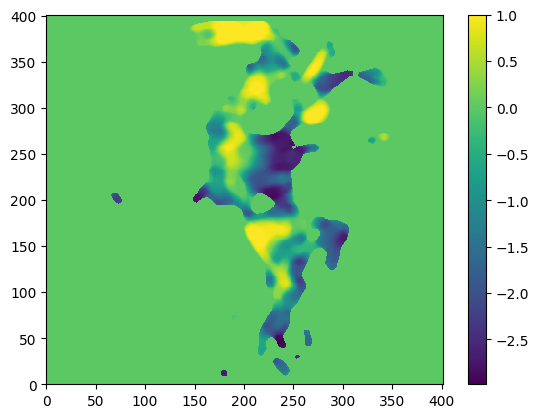

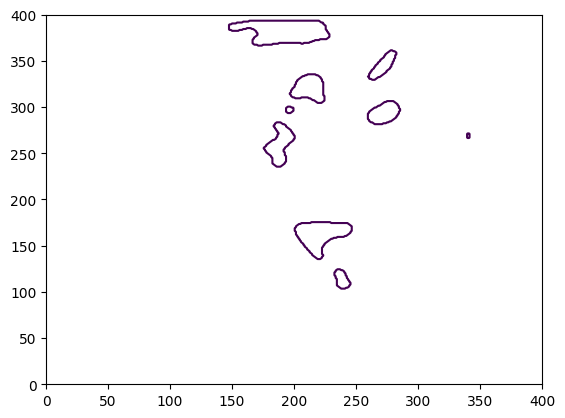

In [20]:
plt.pcolormesh(CELLline)
plt.colorbar()
plt.figure()
plt.contour(widecellz)
# plt.colorbar()

/tmp/ipykernel_61807/1844046306.py:15: UserWarning: The following kwargs were not used by contour: 'color'
  plt.contour(evalbox,color=(1,1,0))


Text(0.5, 1.0, 'KABX, 07/02/2021, 22:30:58 ')

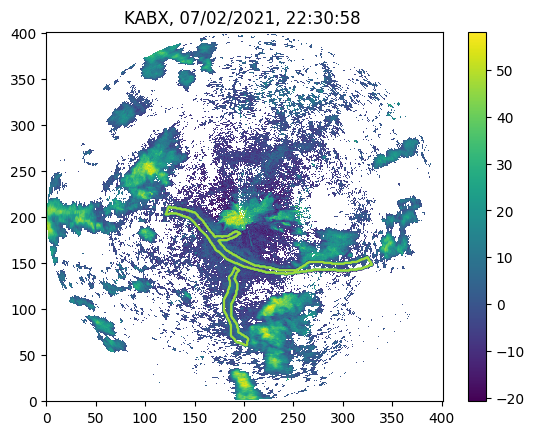

In [95]:
ppi_file ='nf_pred'+os.path.basename(ifn)[5:-3]+'mat'
ppi_id = os.path.basename(ppi_file)
ppi_name = ppi_id[11:]  # MATLAB 12:end is Python 11: (0-based)
date_part = ppi_name[4:12]   # 5:12 in MATLAB → 4:12 in Python
time_part = ppi_name[13:19]

radar_id = ppi_name[0:4]  # 1:4 in MATLAB → 0:4 in Python
tstamp_date = datetime.strptime(date_part, "%Y%m%d")
tstamp_time = datetime.strptime(time_part, "%H%M%S").time()
tstamp = datetime.combine(tstamp_date.date(), tstamp_time)
ppi_desc = f"{radar_id}, {tstamp.strftime('%m/%d/%Y, %H:%M:%S %Z')}"

plt.pcolormesh(PARITP[:,:,0])
plt.colorbar()
plt.contour(evalbox,color=(1,1,0))
plt.title(ppi_desc)
# plt.figure()
# plt.pcolormesh(beta)
# plt.contour(evalbox,color=(1,1,0))
# plt.figure()
# plt.pcolormesh(linez)
# plt.colorbar()
# plt.contour(evalbox,color=(1,1,0))
# plt.figure()
# plt.pcolormesh(linedelz)
# plt.colorbar()
# plt.contour(evalbox,color=(1,1,0))
# plt.figure()
# plt.pcolormesh(widecellz)

In [127]:
def find_crossings(x, y, c):
    """
    Find x-values where y crosses the constant c.
    
    Parameters
    ----------
    x : array_like
        1-D array of x samples.
    y : array_like
        1-D array of y samples (same length as x).
    c : float
        Target horizontal line value.
        
    Returns
    -------
    crossings : list of floats
        x-values where y(x) == c (interpolated).
    """
    x = np.asarray(x)
    y = np.asarray(y)
    if x.shape != y.shape:
        raise ValueError("x and y must have the same shape")

    diff = y - c
    idx = np.where(np.sign(diff[:-1]) * np.sign(diff[1:]) < 0)[0]

    crossings = []
    for i in idx:
        x0, x1 = x[i], x[i+1]
        y0, y1 = y[i], y[i+1]
        # Linear interpolation
        x_c = x0 + (c - y0) * (x1 - x0) / (y1 - y0)
        crossings.append(x_c)

    return crossings

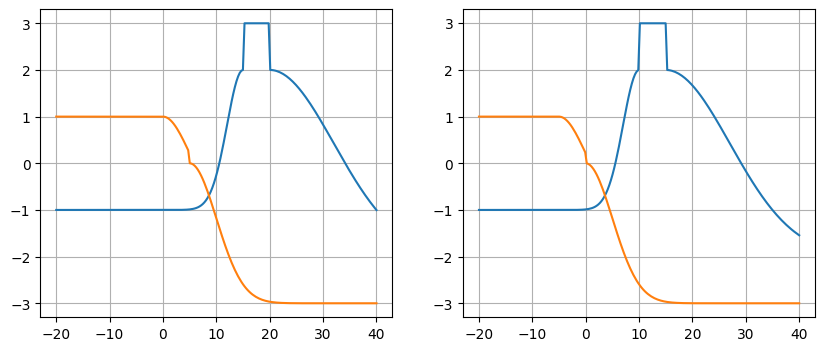

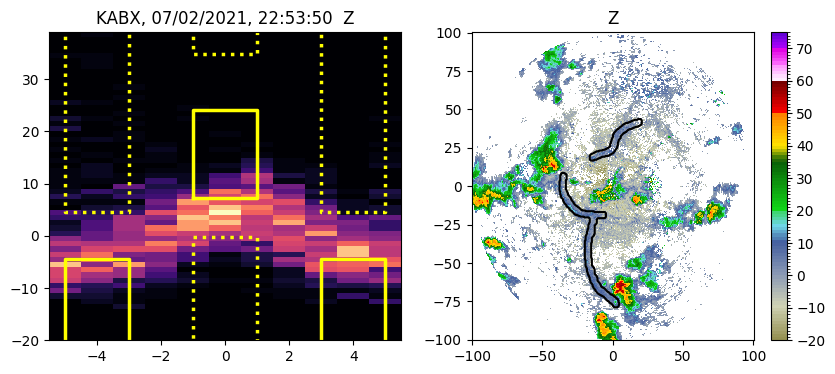

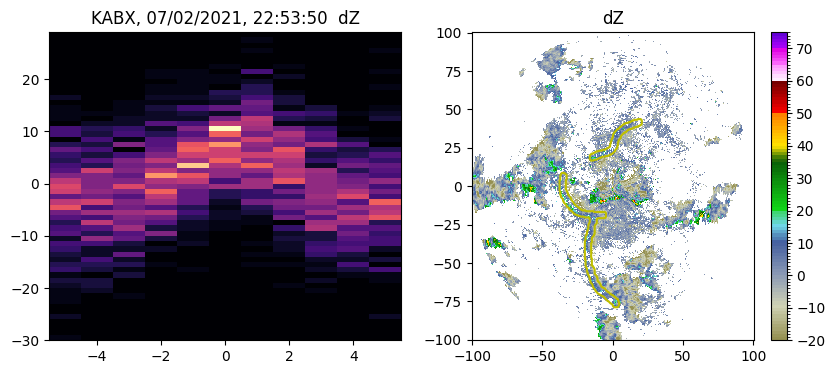

In [176]:
leng=12
ds = np.arange(-(leng//2),(leng+1)//2)
def plot_var_section_hist(var,vedge,vn,x,y,colors='y'):
    cvar = var[x,y].ravel()
    cx = np.tile(ds[:, None], (1, x.shape[1])).ravel()
    fig, ax = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols

    ax[0].hist2d(cx[np.isfinite(cvar)], cvar[np.isfinite(cvar)], bins=(np.arange(-leng//2, (leng+1)//2, 1)+0.5, vedge), cmap='magma')
    ax[0].set_title(ppi_desc + f' {vn}')
    
    pcm = ax[1].pcolormesh(Cx,Cy,var,cmap=cl.zmap,norm=cl.znorm)
    ax[1].contour(Cx,Cy,evalbox,[0.5], colors=colors,linewidths=1.5)
    plt.colorbar(pcm)
    ax[1].set_title(vn)
    return fig, ax

interpolator.values = diffz.reshape(-1,1)
cart_dz = interpolator(Cx, Cy)

evalline = skeletonize(evalbox)
theta, coherence, valid = orientation_from_binary(evalline, sigma=3)
x,y =  cross_section(theta[evalline], Cx[evalline], Cy[evalline],Cx,Cy, length=leng)

fig, ax = plt.subplots(1, 2, figsize=(10, 4))
ftcxy = plot_ftc(ax[0],[15, 20, 3, 3, -1, 12, 4, -2, 3],[0, 5, 5, 2,-1, 5, 3,-3, 1])
new_ftcxy = plot_ftc(ax[1],[10, 15, 3, 3, -1, 12, 4, -2, 3],[-5, 0, 5, 2,-1, 5, 3,-3, 1])

fig, ax = plot_var_section_hist(PARITP[:,:,0],np.arange(-20, 40, 1),'Z',x,y,colors='k')
def overlay_ftc(ftcxy,ax,c='w'):
    ys = find_crossings(ftcxy[0],ftcxy[1],1)
    ax.plot([-1, 1, 1, -1, -1], [ys[0], ys[0],ys[1],ys[1],ys[0]], '-',color=c,linewidth=2.5)
    # ys = find_crossings(ftcxy[0],ftcxy[1],0)
    # ax.plot([-1, 1, 1, -1, -1], [ys[0], ys[0],ys[1],ys[1],ys[0]], ':',color=c)
    ys = find_crossings(ftcxy[0],ftcxy[1],-0.99)
    # ax.plot([-1, 1, 1, -1, -1], [ys[0], ys[0],ys[1],ys[1],ys[0]], ':',color=c,linewidth=2.5)
    # ax.plot([-1, 1, 1, -1], [ys[0], ys[0],ys[1],ys[1],ys[0]], ':',color=c,linewidth=2.5)
    ax.plot([-1, -1, 1, 1], [-30,ys[0], ys[0],-30], ':',color=c,linewidth=2.5)
    ax.plot([-1, -1, 1, 1], [40,ys[1], ys[1],40], ':',color=c,linewidth=2.5)

    ys = find_crossings(ftcxy[2],ftcxy[3],0.99)
    ax.plot([-5,-5, -3,-3], [-30,ys[0],ys[0],-30], '-',color=c,linewidth=2.5)
    ax.plot([5,5, 3,3], [-30,ys[0], ys[0],-30], '-',color=c,linewidth=2.5)
    # ys = find_crossings(ftcxy[2],ftcxy[3],0)
    # # for y in ys:
    # ax.plot([-5, -3], [ys, ys], ':',color=c)
    # ax.plot([5, 3], [ys, ys], ':',color=c)
    ys = find_crossings(ftcxy[2],ftcxy[3],-1)
    ax.plot([-5,-5, -3,-3], [40,ys[0],ys[0],40], ':',color=c,linewidth=2.5)
    ax.plot([5,5, 3,3], [40,ys[0],ys[0],40], ':',color=c,linewidth=2.5)
# overlay_ftc(ftcxy,ax[0])


overlay_ftc(new_ftcxy,ax[0],(1,1,0))

# dz_cfun = make_ftc_cscore([5,15,4,3,-2,9,4,-3,2])
# dz_sfun = make_ftc_sscore([-10,5,5,2,-1,8,2,-3,1
                           
fig, ax = plot_var_section_hist(cart_dz,np.arange(-30, 30, 1),'dZ',x,y)

# fig, ax = plot_var_section_hist(PARITP[:,:,4],np.arange(0.2, 1, 0.01),'rhohv',x,y,colors='k')

# fig, ax = plot_var_section_hist(PARITP[:,:,5],np.arange(-6, 8.2, 0.25),'ZDR',x,y)

# fig, ax = plot_var_section_hist(PARITP[:,:,3],np.arange(-5, 90, 2.5),'phidp',x,y)


Elapsed time: 0.908050 seconds


/tmp/ipykernel_61807/488538696.py:91: UserWarning: Adding colorbar to a different Figure <Figure size 1000x400 with 4 Axes> than <Figure size 1000x400 with 3 Axes> which fig.colorbar is called on.
  plt.colorbar(pcm)
/tmp/ipykernel_61807/488538696.py:106: UserWarning: Adding colorbar to a different Figure <Figure size 1000x400 with 4 Axes> than <Figure size 1000x400 with 3 Axes> which fig.colorbar is called on.
  plt.colorbar(pcm)


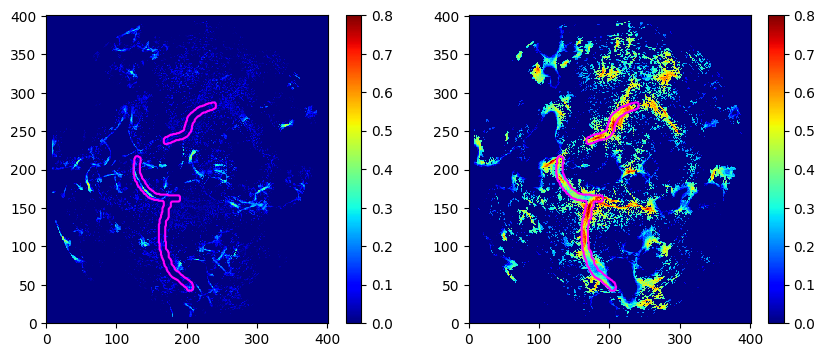

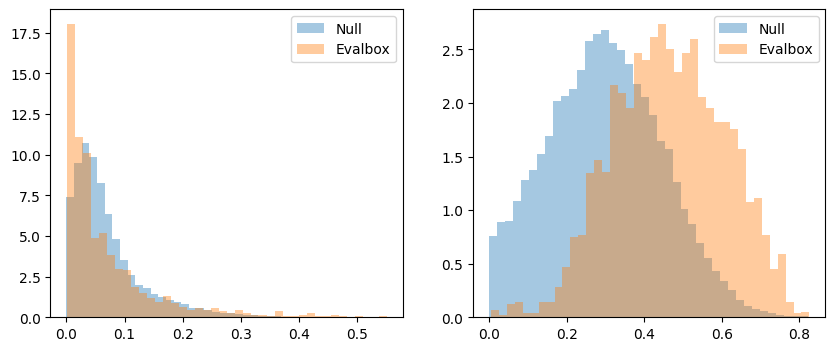

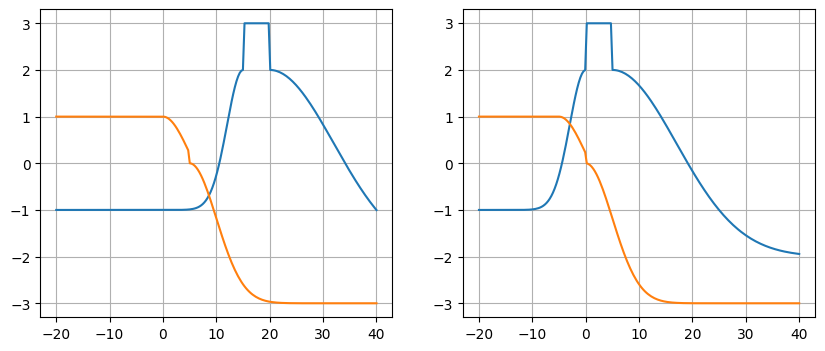

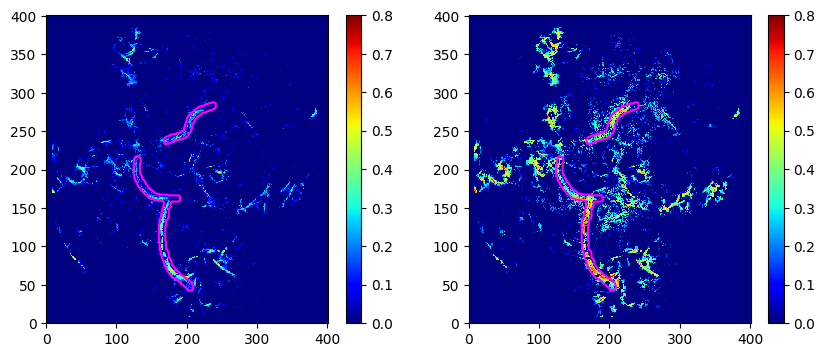

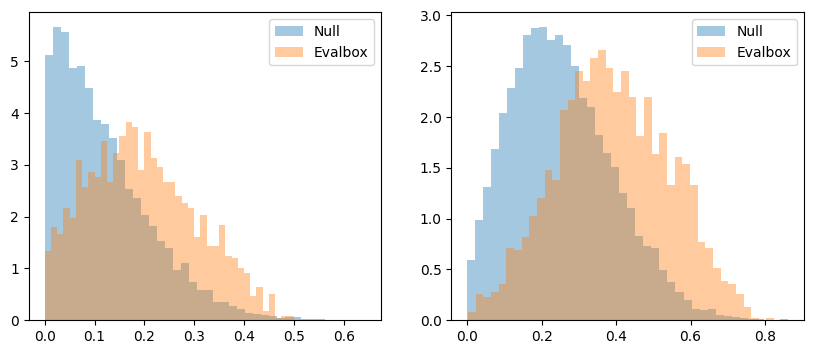

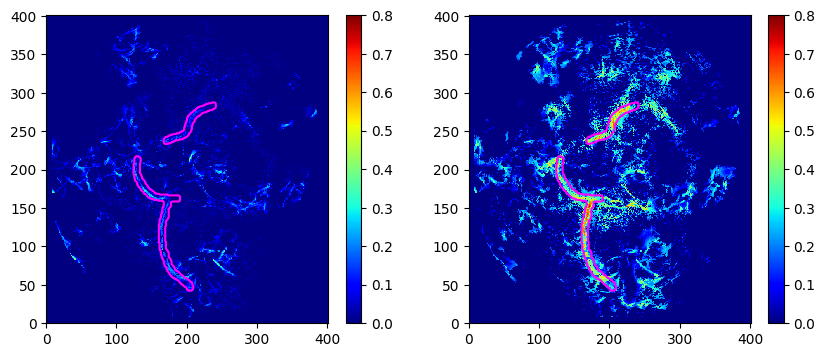

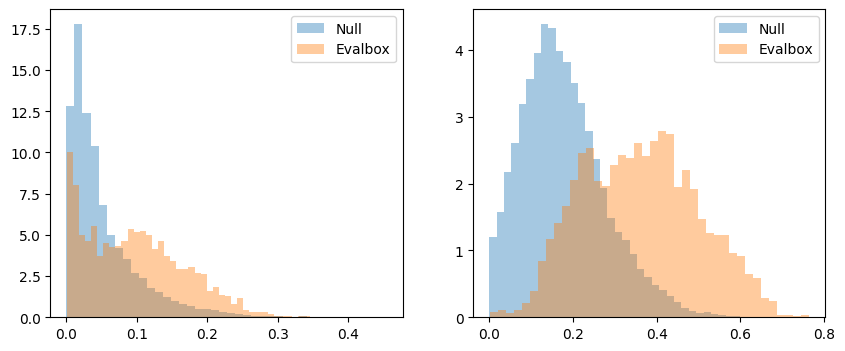

In [182]:
interpolator.values = PARROT[:,:,0].reshape(-1,1)
rotgz = interpolator(Cx, Cy)
interpolator.values = diffz.reshape(-1,1)
rotitp = interpolator(Cx, Cy)

tic = time.time()  # Start timer
# # cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = c_para
z_cfun = make_ftc_cscore([15, 20, 3, 3, -1, 12, 4, -2, 3])
z_sfun = make_ftc_sscore([0, 5, 5, 2,-1, 5, 3,-3, 1])
zftcs = [FTC_PLAN(ftcc,z_cfun,3), FTC_PLAN(ftcs,z_sfun,1)]
zbeta = gen_beta(rotgz,thrREF,zftcs)
dz_cfun = make_ftc_cscore([5,15,4,3,-2,9,4,-3,2])
dz_sfun = make_ftc_sscore([-10,5,5,2,-1,8,2,-3,1])
dzftcs = [FTC_PLAN(ftcc,dz_cfun,2), FTC_PLAN(ftcs,dz_sfun,1)]
dzbeta = gen_beta(rotitp,thrdREF,dzftcs)
zbeta[zbeta<0]=0
dzbeta[dzbeta<0]=0
toc = time.time()  # End timer
print(f"Elapsed time: {toc - tic:.6f} seconds")

evalbox = evalbox.astype(bool)
figz, axz = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
pcm=axz[0].pcolormesh(zbeta,cmap='jet',vmin=0,vmax=0.8)
plt.colorbar(pcm)
axz[0].contour(evalbox,colors=(1,0,1))

figzh, axzh = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols

figf, axf = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
plot_ftc(axf[0],[15, 20, 3, 3, -1, 12, 4, -2, 3],[0, 5, 5, 2,-1, 5, 3,-3, 1])

var = zbeta 
ve = var[evalbox].reshape(-1)
vv = var[np.logical_not(evalbox)].reshape(-1)
axzh[0].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='Null',alpha=0.4)
axzh[0].hist(ve[ve!=0], density=True, bins=40,label='Evalbox',alpha=0.4)
axzh[0].legend()

figdz, axdz = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
pcm=axdz[0].pcolormesh(dzbeta,cmap='jet',vmin=0,vmax=0.8)
plt.colorbar(pcm)
axdz[0].contour(evalbox,colors=(1,0,1))

figdzh, axdzh = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
var = dzbeta 
ve = var[evalbox]
vv = var[np.logical_not(evalbox)]
axdzh[0].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='Null',alpha=0.4)
axdzh[0].hist(ve[ve!=0], density=True, bins=40,label='Evalbox',alpha=0.4)
axdzh[0].legend()

beta0 = (zbeta+dzbeta)/2

figb, axb = plt.subplots(1, 2, figsize=(10, 4))
pcm=axb[0].pcolormesh(beta0,cmap='jet',vmin=0,vmax=0.8)
plt.colorbar(pcm)
axb[0].contour(evalbox,colors=(1,0,1))
# # cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = c_para
# c_para = [15, 20, 3, 3, -1, 12, 4, -2, 3]
# s_para = [0, 5, 5, 2,-1, 5, 3,-3, 1]
c_para = [0, 5, 3, 3, -1, 12, 4, -2, 3]
s_para = [-5, 0, 5, 2,-1, 5, 3,-3, 1]

z_cfun = make_ftc_cscore(c_para)
z_sfun = make_ftc_sscore(s_para)

plot_ftc(axf[1],c_para,s_para)

zftcs = [FTC_PLAN(ftcc,z_cfun,3), FTC_PLAN(ftcs,z_sfun,1)]
zbeta = gen_beta(rotgz,thrREF,zftcs)

# dz_cfun = make_ftc_cscore([5,15,4,3,-2,9,4,-3,2])
# dz_sfun = make_ftc_sscore([-10,5,5,2,-1,8,2,-3,1])
# dz_cfun = make_ftc_cscore([10,20,4,3,-2,9,4,-3,2])
# dz_sfun = make_ftc_sscore([-5,0,5,2,-1,8,2,-3,1])
# dz_cfun = make_ftc_cscore([0,10,4,3,-2,9,4,-3,2])
# dz_sfun = make_ftc_sscore([-10,-5,5,2,-1,8,2,-3,1])

dz_cfun = make_ftc_cscore([5,15,4,3,-2,9,4,-3,2])
dz_sfun = make_ftc_sscore([0,5,5,2,-1,8,2,-3,1])

dzftcs = [FTC_PLAN(ftcc,dz_cfun,2), FTC_PLAN(ftcs,dz_sfun,1)]
dzbeta = gen_beta(rotitp,thrdREF,dzftcs)
zbeta[zbeta<0]=0
dzbeta[dzbeta<0]=0
# toc = time.time()  # End timer
# print(f"Elapsed time: {toc - tic:.6f} seconds")

# fig, ax = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
pcm=axz[1].pcolormesh(zbeta,cmap='jet',vmin=0,vmax=0.8)
plt.colorbar(pcm)
axz[1].contour(evalbox,colors=(1,0,1))

# axzh[1].hist(zbeta[np.logical_not(evalbox)].reshape(-1), density=True, bins=40)
# axzh[1].hist(zbeta[evalbox].reshape(-1), density=True, bins=40)

var = zbeta 
ve = var[evalbox]
vv = var[np.logical_not(evalbox)]
axzh[1].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='Null',alpha=0.4)
axzh[1].hist(ve[ve!=0], density=True, bins=40,label='Evalbox',alpha=0.4)
axzh[1].legend()

# fig, ax = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
pcm=axdz[1].pcolormesh(dzbeta,cmap='jet',vmin=0,vmax=0.8)
plt.colorbar(pcm)
axdz[1].contour(evalbox,colors=(1,0,1))

var = dzbeta 
ve = var[evalbox]
vv = var[np.logical_not(evalbox)]
axdzh[1].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='Null',alpha=0.4)
axdzh[1].hist(ve[ve!=0], density=True, bins=40,label='Evalbox',alpha=0.4)
axdzh[1].legend()

beta = (zbeta+dzbeta)/2
# plt.figure()
pcm=axb[1].pcolormesh(beta,cmap='jet',vmin=0,vmax=0.8)
plt.colorbar(pcm)
axb[1].contour(evalbox,colors=(1,0,1))
# plt.contour(widecellz,colors='w')
# plt.contour(medfilt2d((np.logical_or(PARITP[:,:,4]>0.95,np.abs(PARITP[:,:,5])<0.5)).astype(float), kernel_size=11),colors='r')
figbh, axbh = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
var = beta0
ve = var[evalbox]
vv = var[np.logical_not(evalbox)]
axbh[0].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='Null',alpha=0.4)
axbh[0].hist(ve[ve!=0], density=True, bins=40,label='Evalbox',alpha=0.4)
axbh[0].legend()


var = beta 
ve = var[evalbox]
vv = var[np.logical_not(evalbox)]
axbh[1].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='Null',alpha=0.4)
axbh[1].hist(ve[ve!=0], density=True, bins=40,label='Evalbox',alpha=0.4)
axbh[1].legend()

In [45]:
from skimage.morphology import skeletonize, disk, binary_dilation, binary_erosion, remove_small_objects, dilation
from skimage.measure import label
from scipy.spatial.distance import pdist, squareform
from scipy.spatial import cKDTree
import tminlib.colorlevel as cl
from tminlib import plot_helper as phelp
VM=cl.VarMap()
varname_table=VM.varname_table
varunit_table=VM.varunit_table

In [109]:
def points_to_binary_grid(xy_points, gshape, origin, dg):
    grid = np.zeros(gshape, dtype=bool)

    # Round or floor the points to nearest integers
    xy_int = ((xy_points-origin)//dg).astype(int)

    # Clip to ensure they fall within bounds
    xy_int[0, :] = np.clip(xy_int[0, :], 0, gshape[1] - 1)
    xy_int[1, :] = np.clip(xy_int[1, :], 0, gshape[0] - 1)

    grid[xy_int[1, :], xy_int[0, :]] = True # grid [y, x]
    return grid

def nf_arc(xx,yy,bw):
    groups = label(bw, connectivity=2)
    fit_chunks = []
    for im in range(1,np.max(groups)+1):
        mask = groups == im
        gf_points = np.array([xx[mask],yy[mask]])
        rot_points = rotation_polyfit(gf_points,2)
        # print(rot_points.shape)
        if rot_points.shape[1]>11:
            fit_chunks.append(rot_points)
    ogn = np.array([xx[0,0],yy[0,0]])[:,np.newaxis]
    if len(fit_chunks)!=0:
        fit_points = np.concatenate(fit_chunks, axis=1)
        return points_to_binary_grid(fit_points,xx.shape,ogn,0.5)
    else:
        return np.zeros(xx.shape,dtype=bool)

def eval_nf(nfloc,evalline,evalbox,gd):
    nfpredict = dilation(nfloc, disk(5))
    Mhits = np.logical_and(evalline,nfpredict)
    Mmiss = np.logical_and(evalline,~nfpredict)
    q_arc = nf_arc(gd['Cx'],gd['Cy'],nfloc)
    Mfa = np.logical_and(np.logical_not(evalbox),q_arc)
    sch,scm,scf,scp = np.sum(Mhits), np.sum(Mmiss), np.sum(Mfa), np.sum(q_arc)
    HR = 1e2*sch/(scm+sch)
    FAR = 1e2*scf/(scp)
    return (HR, FAR), (Mhits, Mmiss, Mfa, q_arc)

def rotation_matrix_2d(theta):
    """
    Returns a 2×2 rotation matrix for rotating points counterclockwise by angle theta (in radians).
    """
    return np.array([
        [np.cos(theta), -np.sin(theta)],
        [np.sin(theta),  np.cos(theta)]
    ])

def find_roation_coord(points):
    points_T = points.T  # shape = (N, 2)
    dist_matrix = squareform(pdist(points_T))
    i, j = np.unravel_index(np.argmax(dist_matrix), dist_matrix.shape)
    max_dist = dist_matrix[i, j]
    delta = points[:,i] - points[:,j]
    angle = np.arctan2(delta[1], delta[0])
    return angle, points[:,i]


def rotation_polyfit(points,n):
    # print(points.shape)
    if points.shape[1]>2:
        ang, origin = find_roation_coord(points)
        rot_points = np.matmul(rotation_matrix_2d(-ang),points-origin[:,np.newaxis])
        coeffs = np.polyfit(rot_points[0,:], rot_points[1,:], n)
        fx = np.arange(np.min(rot_points[0,:]),np.max(rot_points[0,:])+0.25,0.25)
        fy = np.polyval(coeffs, fx)
        return np.matmul(rotation_matrix_2d(ang),np.array([fx,fy]))+origin[:,np.newaxis]
    else:
        return points

r = np.sqrt(Cx**2+Cy**2)
rmask = r>=100

gcoord = {'Cx':Cx,'Cy':Cy}
evalline = skeletonize(evalbox)

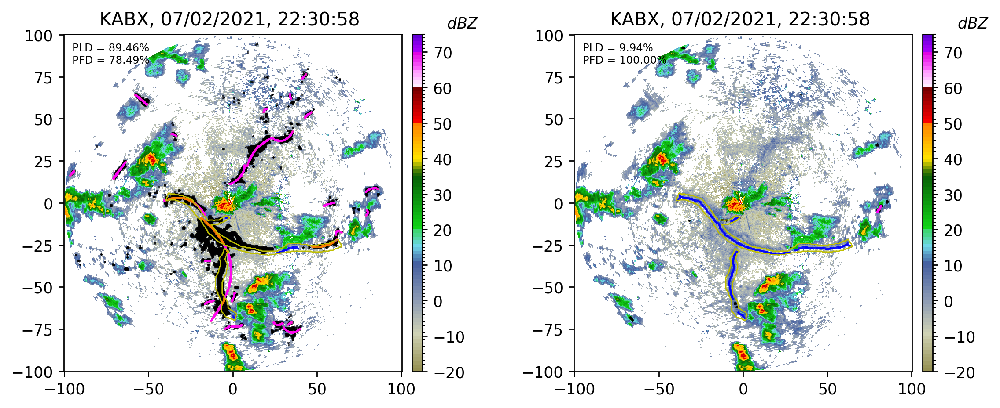

In [112]:
hthr=0.7

ppi_file ='nf_pred'+os.path.basename(ifn)[5:-3]+'mat'
ppi_id = os.path.basename(ppi_file)
ppi_name = ppi_id[11:]  # MATLAB 12:end is Python 11: (0-based)
date_part = ppi_name[4:12]   # 5:12 in MATLAB → 4:12 in Python
time_part = ppi_name[13:19]

radar_id = ppi_name[0:4]  # 1:4 in MATLAB → 0:4 in Python
tstamp_date = datetime.strptime(date_part, "%Y%m%d")
tstamp_time = datetime.strptime(time_part, "%H%M%S").time()
tstamp = datetime.combine(tstamp_date.date(), tstamp_time)
ppi_desc = f"{radar_id}, {tstamp.strftime('%m/%d/%Y, %H:%M:%S %Z')}"

inputNF = np.zeros((*Cx.shape,6))
inputNF[:,:,0] = beta
inputNF[:,:,1] = PARITP[:,:,0] # reflectivity
inputNF[:,:,2] = PARITP[:,:,4] # cross_correlation_ratio
inputNF[:,:,3] = PARITP[:,:,5] # differential_reflectivity
inputNF[:,:,4] = stda
inputNF[:,:,5] = PARITP[:,:,3]

fig, axs = plt.subplots(1, 2, figsize=(7/0.7, 2.5/0.7),dpi=250, gridspec_kw=dict(left=0.08, right=1-0.085, top=1-0.08, bottom=0.06, wspace=0.25, hspace=0.16))

def plot_nf(ax,nfout,hrt,fat,evalmasks):
    # evalbox = data['evalbox']
    nfloc = np.logical_and(~rmask,nfout)

    ax.pcolormesh(Cx,Cy,PARITP[:,:,0],cmap=cl.zmap,norm=cl.znorm)

    ax.plot(Cx[nfloc],Cy[nfloc],'k.',markersize=0.8)
    # ax.plot(Cx[np.logical_and(nfloc,evalbox)],Cy[np.logical_and(nfloc,evalbox)],'r.',markersize=0.8)
    ax.plot(Cx[evalmasks[3]],Cy[evalmasks[3]],'.',color=(1,0.5,0),markersize=0.8)
    ax.plot(Cx[evalmasks[2]],Cy[evalmasks[2]],'.',color=(1,0,1),markersize=0.8)
    ax.plot(Cx[evalmasks[1]],Cy[evalmasks[1]],'b.',markersize=0.8)
    # ax.plot(Cx[evalmasks[0]],Cy[evalmasks[0]],'.',color=(0,1,0),markersize=0.8)
    ax.contour(Cx,Cy,evalbox,[0.5], colors='y',linewidths=0.8)
    ax.text(0.025, 0.975,  f'PLD = {hrt:.2f}%\nPFD = {fat:.2f}%', 
             transform=ax.transAxes, verticalalignment='top', fontsize=7)
    # ax.text(0.025, 0.975,  f'PLD = {hrt:.2f}%\nPFD = {fat:.2f}%', 
    #          transform=ax.transAxes, verticalalignment='top', fontsize=7)
    ax.set_title(ppi_desc)
    ax.axis('equal')
    phelp.add_cbar(ax.collections[0],fig,ax,unit_text = varunit_table['Zh'],size='3%')

outputGST = fuzzGST.eval_fis(inputNF)
hGST = medfilt2d(outputGST.astype(float), kernel_size=3)        
hh = hGST>=hthr
(hr,fa), eval_pre = eval_nf(hh,evalline,evalbox,gcoord)
plot_nf(axs[0],hh,hr,fa,eval_pre)

inputNF[:,:,0] = beta0
outputGST = fuzzGST.eval_fis(inputNF)
hGST = medfilt2d(outputGST.astype(float), kernel_size=3)        
hh = hGST>=hthr
(hr,fa), eval_pre = eval_nf(hh,evalline,evalbox,gcoord)
plot_nf(axs[1],hh,hr,fa,eval_pre)


Elapsed time: 1.970122 seconds


/tmp/ipykernel_47584/2719496408.py:91: UserWarning: Adding colorbar to a different Figure <Figure size 1000x400 with 4 Axes> than <Figure size 1000x400 with 2 Axes> which fig.colorbar is called on.
  plt.colorbar(pcm)
/tmp/ipykernel_47584/2719496408.py:106: UserWarning: Adding colorbar to a different Figure <Figure size 1000x400 with 4 Axes> than <Figure size 1000x400 with 2 Axes> which fig.colorbar is called on.
  plt.colorbar(pcm)


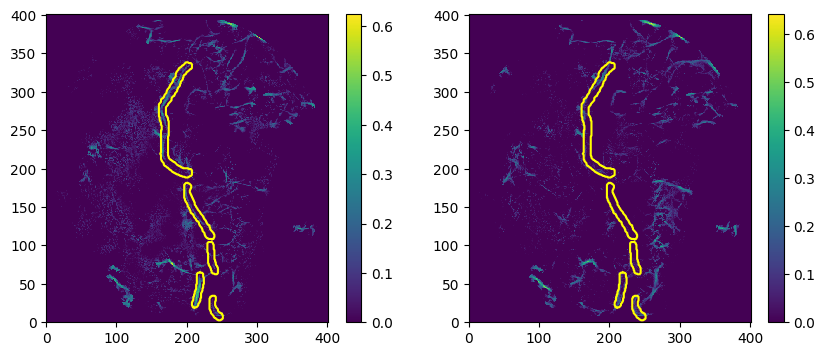

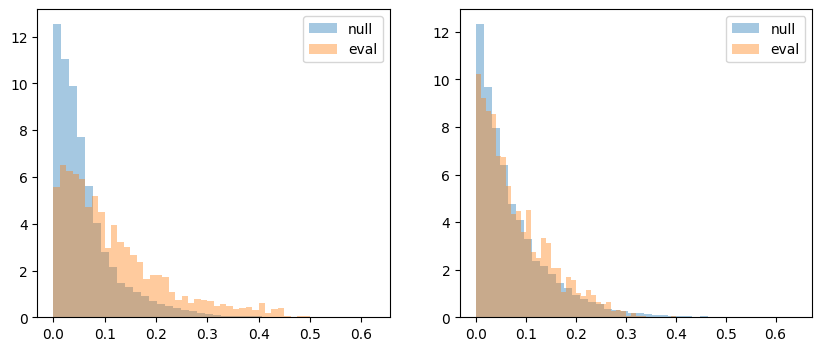

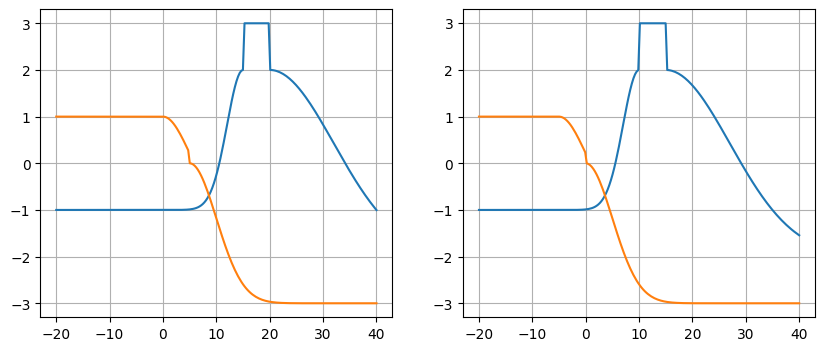

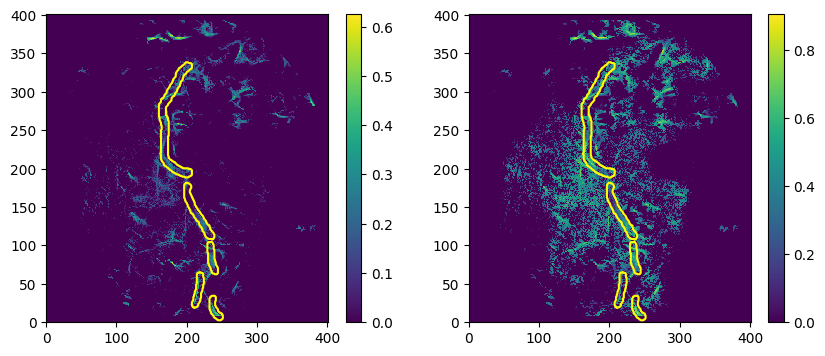

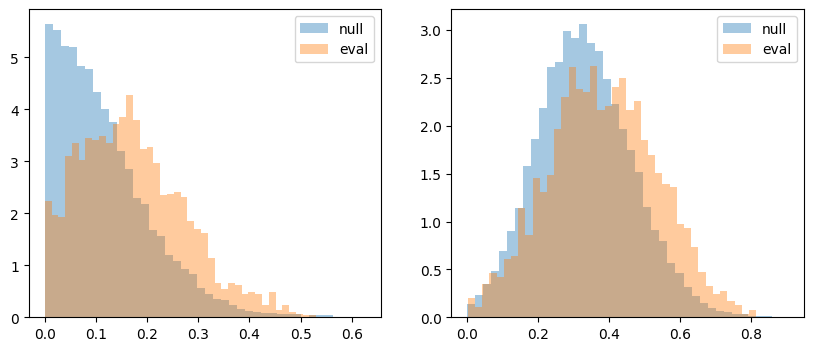

In [35]:
def gen_beta(a2,a2_thr,ftcs):
    center_indices = np.argwhere(a2>a2_thr)
    c_indices = clean_indices(center_indices, a2.shape, ftcs[0].numINT)
    total_score = ftcs[0].get_score(a2,c_indices)
    score_scale = ftcs[0].scale*ftcs[0].displace.shape[1]
    for ftcplan in ftcs[1:]:
        total_score += ftcplan.get_score(a2,c_indices)
        score_scale += ftcplan.scale*ftcplan.displace.shape[1]
    total_score = np.max(total_score,axis=0)
    scoremt = np.zeros(a2.shape)
    scoremt[c_indices[:,0],c_indices[:,1]] = total_score/score_scale
    return scoremt

interpolator.values = PARROT[:,:,0].reshape(-1,1)
rotgz = interpolator(Cx, Cy)
interpolator.values = diffz.reshape(-1,1)
rotitp = interpolator(Cx, Cy)

tic = time.time()  # Start timer
# # cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = c_para
z_cfun = make_ftc_cscore([15, 20, 3, 3, -1, 12, 4, -2, 3])
z_sfun = make_ftc_sscore([0, 5, 5, 2,-1, 5, 3,-3, 1])
zftcs = [FTC_PLAN(ftcc,z_cfun,3), FTC_PLAN(ftcs,z_sfun,1)]
zbeta = gen_beta(rotgz,thrREF,zftcs)
dz_cfun = make_ftc_cscore([5,15,4,3,-2,9,4,-3,2])
dz_sfun = make_ftc_sscore([-10,5,5,2,-1,8,2,-3,1])
dzftcs = [FTC_PLAN(ftcc,dz_cfun,2), FTC_PLAN(ftcs,dz_sfun,1)]
dzbeta = gen_beta(rotitp,thrdREF,dzftcs)
zbeta[zbeta<0]=0
dzbeta[dzbeta<0]=0
toc = time.time()  # End timer
print(f"Elapsed time: {toc - tic:.6f} seconds")

evalbox = evalbox.astype(bool)
figz, axz = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
pcm=axz[0].pcolormesh(zbeta)
plt.colorbar(pcm)
axz[0].contour(evalbox,colors=(1,1,0))

figzh, axzh = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols

figf, axf = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
plot_ftc(axf[0],[15, 20, 3, 3, -1, 12, 4, -2, 3],[0, 5, 5, 2,-1, 5, 3,-3, 1])

var = zbeta 
ve = var[evalbox].reshape(-1)
vv = var[np.logical_not(evalbox)].reshape(-1)
axzh[0].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='null',alpha=0.4)
axzh[0].hist(ve[ve!=0], density=True, bins=40,label='eval',alpha=0.4)
axzh[0].legend()

figdz, axdz = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
pcm=axdz[0].pcolormesh(dzbeta)
plt.colorbar(pcm)
axdz[0].contour(evalbox,colors=(1,1,0))

figdzh, axdzh = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
var = dzbeta 
ve = var[evalbox]
vv = var[np.logical_not(evalbox)]
axdzh[0].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='null',alpha=0.4)
axdzh[0].hist(ve[ve!=0], density=True, bins=40,label='eval',alpha=0.4)
axdzh[0].legend()

# # cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = c_para
c_para = [10, 15, 3, 3, -1, 12, 4, -2, 3]
s_para = [-5, 0, 5, 2,-1, 5, 3,-3, 1]
# c_para = [15, 20, 3, 3, -1, 12, 4, -2, 3]
# s_para = [0, 5, 5, 2,-1, 5, 3,-3, 1]

z_cfun = make_ftc_cscore(c_para)
z_sfun = make_ftc_sscore(s_para)

plot_ftc(axf[1],c_para,s_para)

zftcs = [FTC_PLAN(ftcc,z_cfun,3), FTC_PLAN(ftcs,z_sfun,1)]
zbeta = gen_beta(rotgz,thrREF,zftcs)

dz_cfun = make_ftc_cscore([5,15,4,3,-2,9,4,-3,2])
dz_sfun = make_ftc_sscore([0,5,5,2,-1,8,2,-3,1])

dzftcs = [FTC_PLAN(ftcc,dz_cfun,2), FTC_PLAN(ftcs,dz_sfun,1)]
dzbeta = gen_beta(rotitp,thrdREF,dzftcs)
zbeta[zbeta<0]=0
dzbeta[dzbeta<0]=0
# toc = time.time()  # End timer
# print(f"Elapsed time: {toc - tic:.6f} seconds")

# fig, ax = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
pcm=axz[1].pcolormesh(zbeta)
plt.colorbar(pcm)
axz[1].contour(evalbox,colors=(1,1,0))

# axzh[1].hist(zbeta[np.logical_not(evalbox)].reshape(-1), density=True, bins=40)
# axzh[1].hist(zbeta[evalbox].reshape(-1), density=True, bins=40)

var = zbeta 
ve = var[evalbox]
vv = var[np.logical_not(evalbox)]
axzh[1].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='null',alpha=0.4)
axzh[1].hist(ve[ve!=0], density=True, bins=40,label='eval',alpha=0.4)
axzh[1].legend()

# fig, ax = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
pcm=axdz[1].pcolormesh(dzbeta)
plt.colorbar(pcm)
axdz[1].contour(evalbox,colors=(1,1,0))

var = dzbeta 
ve = var[evalbox]
vv = var[np.logical_not(evalbox)]
axdzh[1].hist(vv[vv!=0].reshape(-1), density=True, bins=40,label='null',alpha=0.4)
axdzh[1].hist(ve[ve!=0], density=True, bins=40,label='eval',alpha=0.4)
axdzh[1].legend()


../mat/POLAR/KABX20210702_21/polar_02_KABX20210702_214409_V06.npz
widecellz min False, max True
 widecellz is not all False 
Elapsed time: 1.274133 seconds
../mat/POLAR/KABX20210702_21/polar_03_KABX20210702_215045_V06.npz
widecellz min False, max True
 widecellz is not all False 
Elapsed time: 1.172943 seconds
../mat/POLAR/KABX20210702_21/polar_04_KABX20210702_215722_V06.npz
widecellz min False, max True
 widecellz is not all False 
Elapsed time: 1.215942 seconds
../mat/POLAR/KABX20210702_21/polar_05_KABX20210702_220400_V06.npz
widecellz min False, max True
 widecellz is not all False 
Elapsed time: 1.184391 seconds
../mat/POLAR/KABX20210702_21/polar_06_KABX20210702_221043_V06.npz
widecellz min False, max True
 widecellz is not all False 
Elapsed time: 0.977448 seconds
../mat/POLAR/KABX20210702_21/polar_07_KABX20210702_221731_V06.npz
widecellz min False, max True
 widecellz is not all False 
Elapsed time: 0.893143 seconds
../mat/POLAR/KABX20210702_21/polar_08_KABX20210702_222421_V06.np

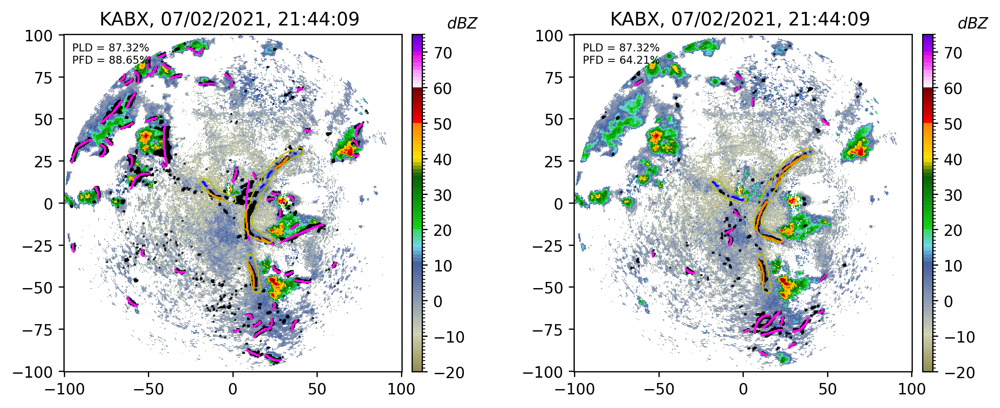

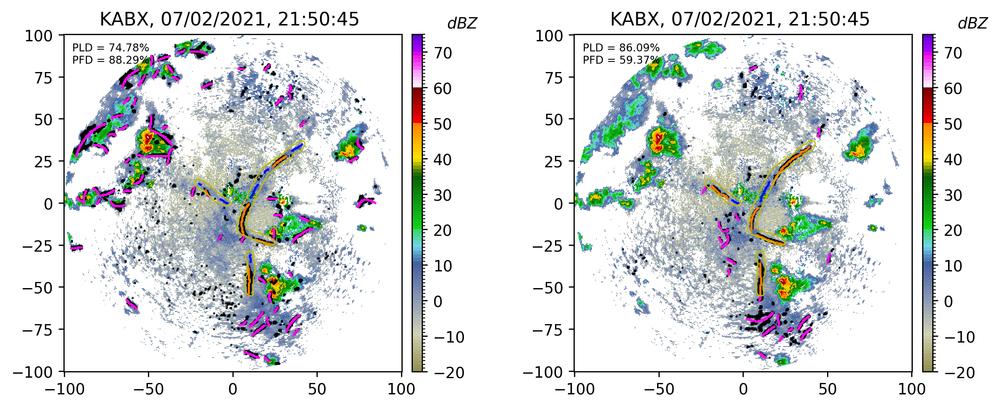

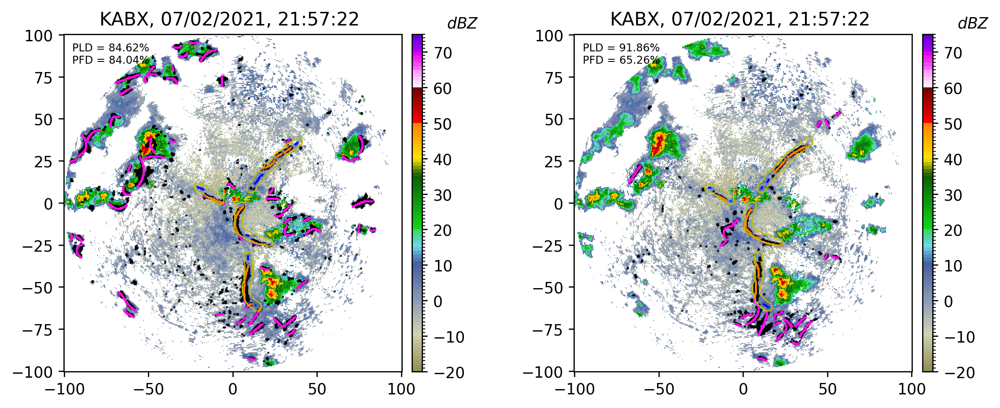

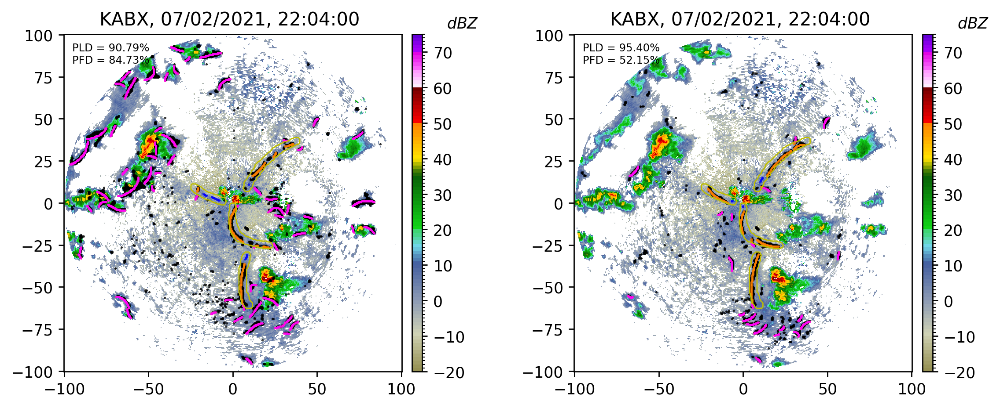

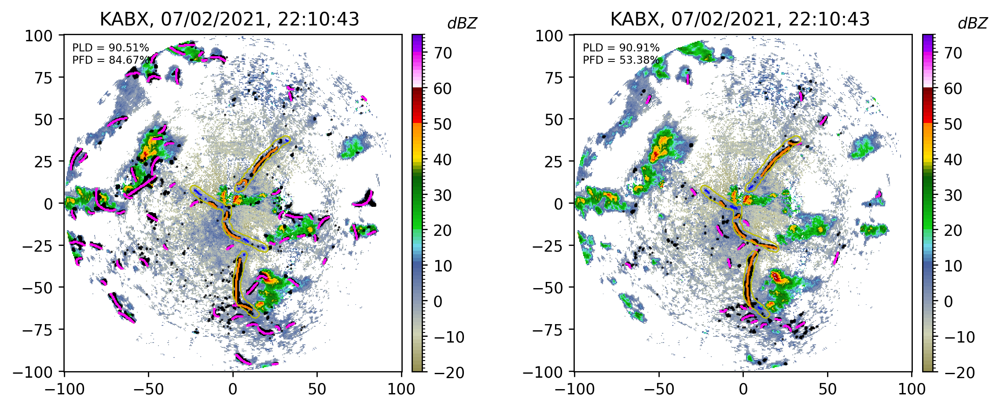

...

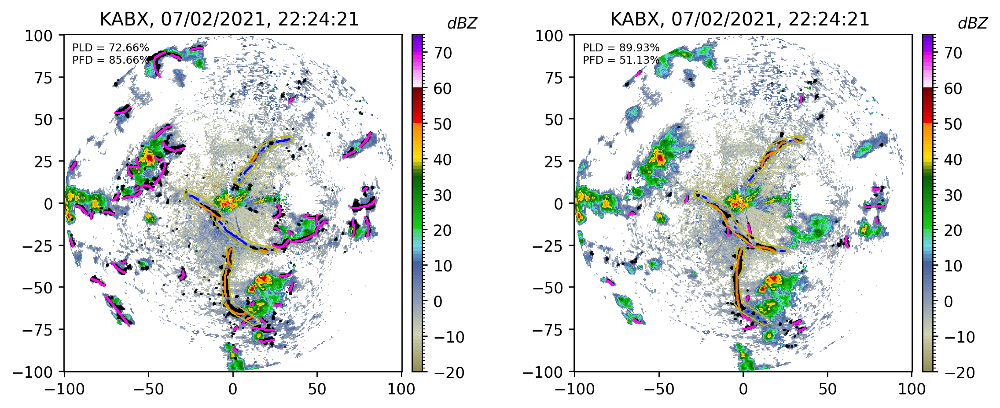

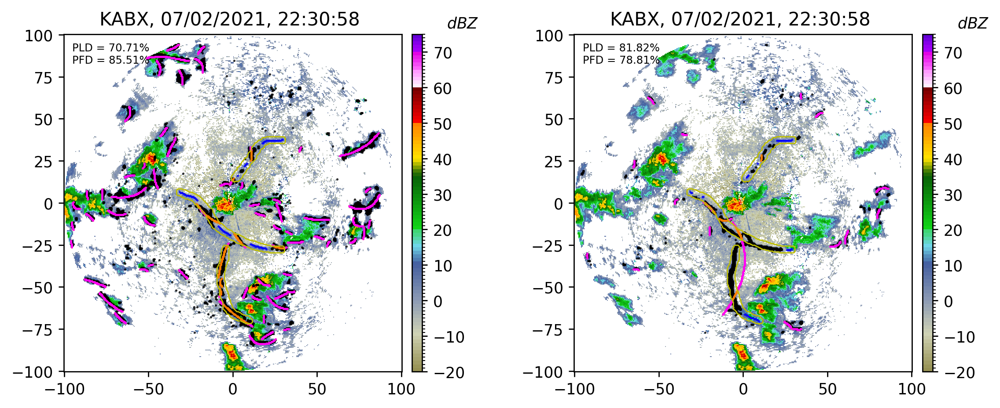

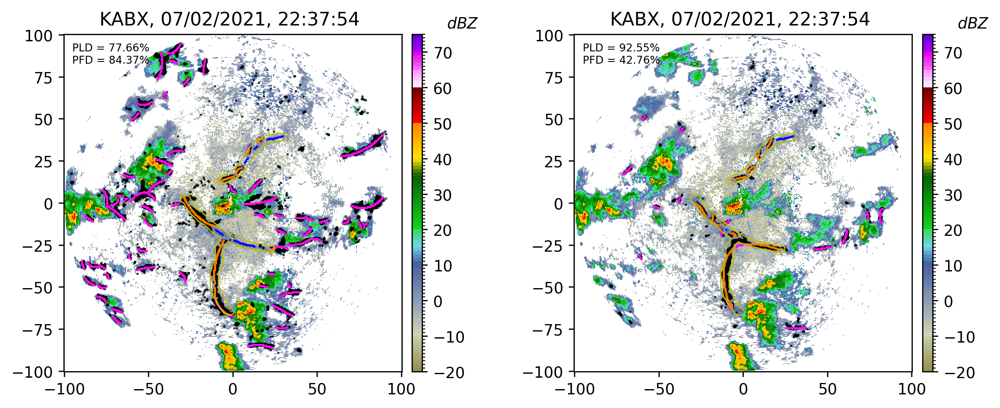

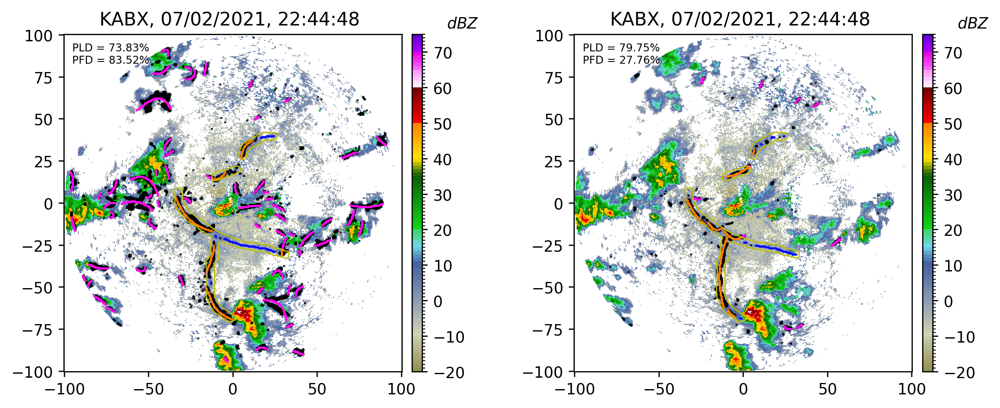

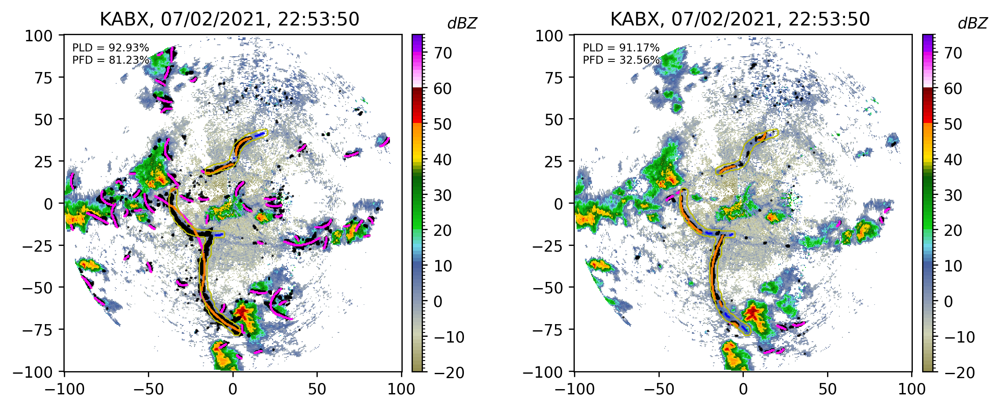

In [191]:
import matplotlib.dates as mdates
hthr=0.6

config = configparser.ConfigParser()
config.read("NFGDA.ini")
export_preds_dir = config["Settings"]["export_preds_dir"]
evalbox_on = config.getboolean('Settings', 'evalbox_on')

iv6m = 7

case_name = config["Settings"]["case_name"]

exp_preds_event = export_preds_dir + case_name
os.makedirs(exp_preds_event,exist_ok=True)
label_path = os.path.join('../V06/',case_name,case_name+'_labels')

v6m_path = os.path.join('../mat/','POLAR',case_name)
v6m_list = glob.glob(v6m_path + "/polar*npz")

hr_pre = []
hr_pos = []
fa_pre = []
fa_pos = []
stat_pre = []
stat_pos = []
tvec = []

def log_stat(fn, stats_list):
    grouped = list(zip(*stats_list))
    # Stack each group
    stacked = [np.stack(arr_list) for arr_list in grouped]
    # Create a dictionary with key names
    save_dict = {
    'hits':stacked[0], 
    'miss':stacked[1], 
    'fa':stacked[2], 
    'q_arc':stacked[3]
    }
    # Save to .npz
    np.savez(fn, **save_dict)
    return save_dict

for iv6m in range(len(v6m_list)-1):
# for iv6m in range(0,len(v6m_list)-1,4):
# for iv6m in range(2):
    PARROT_buf = np.load(v6m_list[iv6m])
    PARROT0 = PARROT_buf['PARROT']
    if PARROT_mask_on:
        PARROT0[PARROT_buf['mask']] = np.nan
    PARROT0 = np.asfortranarray(PARROT0)
    # print(PARROT0.mask)
    interpolator = LinearNDInterpolator((RegPolarX.reshape(-1),RegPolarY.reshape(-1)), PARROT0[:,:,0].reshape(-1))
    # nf_history = []
    
    # for ifn in v6m_list[1:config.getint('Settings', 'i_end')+1]:
    ifn = v6m_list[iv6m+1]
    print(ifn)
    # PARROT = np.load(ifn)['PARROT']
    PARROT_buf = np.load(ifn)
    PARROT = PARROT_buf['PARROT']
    if PARROT_mask_on:
        PARROT[PARROT_buf['mask']] = np.nan
    PARROT = np.asfortranarray(PARROT)
    
    z1 = PARROT[:,:,0].copy()
    z0 = PARROT0[:,:,0].copy()
    diffz = z1-z0
    
    PARITP = np.zeros((*Cx.shape,PARROT.shape[-1]))
    
    for iv in [0,1,3,4,5]:
        if iv == 3:
            sdphi=np.zeros((*RegPolarX.shape,5))
            phi = PARROT[:,:,iv]
            phi[phi<0] = np.nan
            phi[phi>360] = np.nan
            sdphi[4:-2,:,:]=sliding_window_view(phi[2:,:], 5, axis=0)
            interpolator.values = np.nanstd(sdphi,axis = 2, ddof=1).reshape(-1,1)
        else:
            # interpolator.values = PARROT[1:,:,iv].reshape(-1,1)
            interpolator.values = PARROT[:,:,iv].reshape(-1,1)
        PARITP[:,:,iv] = interpolator(Cx, Cy)
    # scipy.io.savemat('../mat/pyPARROT.mat', {"PARITP": PARITP})
    
    # tic = time.time()  # Start timer
    
    V_window = sliding_window_view(PARITP[:,:,1], (3, 3))
    V_window = V_window.reshape((*V_window.shape[:2],-1))
    cbr = np.sum(~np.isnan(V_window),axis = 2)/9
    SD_buf = np.zeros(V_window.shape[:2])
    SD_buf[cbr>=0.3] = np.nanstd(V_window[cbr>=0.3].reshape(-1,9),axis = 1, ddof=1)
    stda = np.zeros(Cx.shape)
    stda[1:-1,1:-1] = SD_buf
    
    
    a2 = PARITP[:,:,0]
    
    center_indices = np.argwhere(a2>cellthresh)
    c_indices = clean_indices(center_indices, a2.shape, cellINT)
    
    cidx = (c_indices[np.newaxis,:,:] + Celldp).astype(int)
    cbox = a2[cidx[:,:,0],cidx[:,:,1]]
    cbr = np.sum( cbox>cellthresh,0)/Celldp.shape[0]
    cbox = cbox[:,cbr>cbcellthrsh]
    c_indices = c_indices[cbr>cbcellthrsh,:]
    
    llscore = np.zeros(cbox.shape)
    llscore[cbox<=s2xnum[0]] = s2ynum[0]
    pp = np.logical_and(cbox>=s2xnum[0], cbox<s2xnum[1])
    llscore[pp] = s2g*cbox[pp]+s2gc
    llscore[cbox>=s2xnum[1]] = s2ynum[1]
    clscore = np.nansum(llscore,0)/Celldp.shape[0]
    # clscore = clscore/Celldp.shape[0]
    totscore = np.zeros(Cx.shape)
    totscore[c_indices[:,0],c_indices[:,1]] = clscore
    CELLline = medfilt2d(totscore, kernel_size=11)
    
    a2 = CELLline
    
    center_indices = np.argwhere(a2>cellcsrthresh)
    c_indices = clean_indices(center_indices, a2.shape, widecellINT)
    
    cidx = (c_indices[np.newaxis,:,:] + Celldp).astype(int)
    cbox = a2[cidx[:,:,0],cidx[:,:,1]]>cellcsrthresh
    cbr = np.sum( cbox>cellcsrthresh,0)/Celldp.shape[0]
    center_indices = c_indices[cbr<1,:]
    cidx = (center_indices[np.newaxis,:,:] + Celldpw).astype(int)
    
    # a2[cidx[:,:,0],cidx[:,:,1]] = 1
    widecellz = a2>0.5
    print(f'widecellz min {np.min(widecellz)}, max {np.max(widecellz)}')
    if np.max(widecellz):
        red_print('widecellz is not all False')
    # # # %%%%%%%%%%%%%%      ../IMG/exe_3_img_exe.m
    # pbeta = (linez+linedelz)/2
    # pbeta[np.isnan(PARITP[:,:,0])] = np.nan
    # beta = pbeta-widecellz
    # beta[beta<0] = 0
    
    mhandpick = os.path.join(label_path,ifn.split('/')[-1][9:-4]+'.mat')
    try:
        handpick = scipy.io.loadmat(mhandpick)
        evalbox = handpick['evalbox']
    except:
        print(f'Warning: No {mhandpick} filling zeros.')
        evalbox = np.zeros(Cx.shape)
    
    
    interpolator.values = PARROT[:,:,0].reshape(-1,1)
    rotgz = interpolator(Cx, Cy)
    interpolator.values = diffz.reshape(-1,1)
    rotitp = interpolator(Cx, Cy)
    
    tic = time.time()  # Start timer
    # # cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = c_para
    z_cfun = make_ftc_cscore([15, 20, 3, 3, -1, 12, 4, -2, 3])
    z_sfun = make_ftc_sscore([0, 5, 5, 2,-1, 5, 3,-3, 1])
    zftcs = [FTC_PLAN(ftcc,z_cfun,3), FTC_PLAN(ftcs,z_sfun,1)]
    zbeta = gen_beta(rotgz,thrREF,zftcs)
    dz_cfun = make_ftc_cscore([5,15,4,3,-2,9,4,-3,2])
    dz_sfun = make_ftc_sscore([-10,5,5,2,-1,8,2,-3,1])
    dzftcs = [FTC_PLAN(ftcc,dz_cfun,2), FTC_PLAN(ftcs,dz_sfun,1)]
    dzbeta = gen_beta(rotitp,thrdREF,dzftcs)
    zbeta[zbeta<0]=0
    dzbeta[dzbeta<0]=0
    toc = time.time()  # End timer
    print(f"Elapsed time: {toc - tic:.6f} seconds")
    
    
    beta0 = (zbeta+dzbeta)/2
    
    # # cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = c_para
    # c_para = [15, 20, 3, 3, -1, 12, 4, -2, 3]
    # s_para = [0, 5, 5, 2,-1, 5, 3,-3, 1]
    c_para = [3, 8, 3, 3, -1, 12, 4, -2, 3]
    s_para = [-8, -3, 5, 2,-1, 5, 3,-3, 1]
    
    z_cfun = make_ftc_cscore(c_para)
    z_sfun = make_ftc_sscore(s_para)
    
    zftcs = [FTC_PLAN(ftcc,z_cfun,3), FTC_PLAN(ftcs,z_sfun,1)]
    zbeta = gen_beta(rotgz,thrREF,zftcs)
    
    # dz_cfun = make_ftc_cscore([5,15,4,3,-2,9,4,-3,2])
    # dz_sfun = make_ftc_sscore([-10,5,5,2,-1,8,2,-3,1])
    # dz_cfun = make_ftc_cscore([10,20,4,3,-2,9,4,-3,2])
    # dz_sfun = make_ftc_sscore([-5,0,5,2,-1,8,2,-3,1])
    dz_cfun = make_ftc_cscore([0,10,4,3,-2,9,4,-3,2])
    dz_sfun = make_ftc_sscore([-10,-5,5,2,-1,8,2,-3,1])
    
    dzftcs = [FTC_PLAN(ftcc,dz_cfun,2), FTC_PLAN(ftcs,dz_sfun,1)]
    dzbeta = gen_beta(rotitp,thrdREF,dzftcs)
    zbeta[zbeta<0]=0
    dzbeta[dzbeta<0]=0
    
    beta = (zbeta+dzbeta)/2
    
    
    ppi_file ='nf_pred'+os.path.basename(ifn)[5:-3]+'mat'
    ppi_id = os.path.basename(ppi_file)
    ppi_name = ppi_id[11:]  # MATLAB 12:end is Python 11: (0-based)
    date_part = ppi_name[4:12]   # 5:12 in MATLAB → 4:12 in Python
    time_part = ppi_name[13:19]
    
    radar_id = ppi_name[0:4]  # 1:4 in MATLAB → 0:4 in Python
    tstamp_date = datetime.strptime(date_part, "%Y%m%d")
    tstamp_time = datetime.strptime(time_part, "%H%M%S").time()
    tstamp = datetime.combine(tstamp_date.date(), tstamp_time)
    tvec.append(tstamp)
    ppi_desc = f"{radar_id}, {tstamp.strftime('%m/%d/%Y, %H:%M:%S %Z')}"
    
    inputNF = np.zeros((*Cx.shape,6))
    inputNF[:,:,0] = beta
    inputNF[:,:,1] = PARITP[:,:,0] # reflectivity
    inputNF[:,:,2] = PARITP[:,:,4] # cross_correlation_ratio
    inputNF[:,:,3] = PARITP[:,:,5] # differential_reflectivity
    inputNF[:,:,4] = stda
    inputNF[:,:,5] = PARITP[:,:,3]
    
    fig, axs = plt.subplots(1, 2, figsize=(7/0.7, 2.5/0.7),dpi=250, gridspec_kw=dict(left=0.08, right=1-0.085, top=1-0.08, bottom=0.06, wspace=0.25, hspace=0.16))
    
    def plot_nf(ax,nfout,hrt,fat,evalmasks):
        # evalbox = data['evalbox']
        nfloc = np.logical_and(~rmask,nfout)
    
        ax.pcolormesh(Cx,Cy,PARITP[:,:,0],cmap=cl.zmap,norm=cl.znorm)
    
        ax.plot(Cx[nfloc],Cy[nfloc],'k.',markersize=0.8)
        # ax.plot(Cx[np.logical_and(nfloc,evalbox)],Cy[np.logical_and(nfloc,evalbox)],'r.',markersize=0.8)
        ax.plot(Cx[evalmasks[3]],Cy[evalmasks[3]],'.',color=(1,0.5,0),markersize=0.8)
        ax.plot(Cx[evalmasks[2]],Cy[evalmasks[2]],'.',color=(1,0,1),markersize=0.8)
        ax.plot(Cx[evalmasks[1]],Cy[evalmasks[1]],'b.',markersize=0.8)
        # ax.plot(Cx[evalmasks[0]],Cy[evalmasks[0]],'.',color=(0,1,0),markersize=0.8)
        ax.contour(Cx,Cy,evalbox,[0.5], colors='y',linewidths=0.8)
        ax.text(0.025, 0.975,  f'PLD = {hrt:.2f}%\nPFD = {fat:.2f}%', 
                 transform=ax.transAxes, verticalalignment='top', fontsize=7)
        # ax.text(0.025, 0.975,  f'PLD = {hrt:.2f}%\nPFD = {fat:.2f}%', 
        #          transform=ax.transAxes, verticalalignment='top', fontsize=7)
        ax.set_title(ppi_desc)
        ax.axis('equal')
        phelp.add_cbar(ax.collections[0],fig,ax,unit_text = varunit_table['Zh'],size='3%')
    evalline = skeletonize(evalbox)
    outputGST = fuzzGST.eval_fis(inputNF)
    hGST = medfilt2d(outputGST.astype(float), kernel_size=3)        
    hh = hGST>=hthr
    (hr,fa), eval_pre = eval_nf(hh,evalline,evalbox,gcoord)
    plot_nf(axs[1],hh,hr,fa,eval_pre)
    hr_pos.append(hr)
    fa_pos.append(fa)
    stat_pos.append(eval_pre)
    
    inputNF[:,:,0] = beta0
    outputGST = fuzzGST.eval_fis(inputNF)
    hGST = medfilt2d(outputGST.astype(float), kernel_size=3)        
    hh = hGST>=0.24
    (hr,fa), eval_pre = eval_nf(hh,evalline,evalbox,gcoord)
    plot_nf(axs[0],hh,hr,fa,eval_pre)
    fig.savefig(os.path.join('tracking_points/ppt', ppi_id[:-4]+'.png'))
    
    hr_pre.append(hr)
    fa_pre.append(fa)
    stat_pre.append(eval_pre)

summ_pre = log_stat('tracking_points/ppt/stat_pre.npz',stat_pre)
summ_pos = log_stat('tracking_points/ppt/stat_pos.npz',stat_pos)
figst, axs = plt.subplots(1, 1, figsize=(4/0.65, 3/0.65),dpi=250, gridspec_kw=dict(left=0.08, right=1-0.085, top=1-0.08, bottom=0.06, wspace=0.25, hspace=0.16))
PLD = 1e2*np.sum(summ_pre['hits'])/(np.sum(summ_pre['hits'])+np.sum(summ_pre['miss']))
PFD = 1e2*np.sum(summ_pre['fa'])/(np.sum(summ_pre['q_arc']))
PLDp = 1e2*np.sum(summ_pos['hits'])/(np.sum(summ_pos['hits'])+np.sum(summ_pos['miss']))
PFDp = 1e2*np.sum(summ_pos['fa'])/(np.sum(summ_pos['q_arc']))
axs.plot(tvec,hr_pre,'b-',label=f'PLD : {PLD:.1f}%')
axs.plot(tvec,np.array(fa_pre),'r-',label=f'PFD : {PFD:.1f}%')
axs.plot(tvec,hr_pos, 'b--',label=f'PLD* : {PLDp:.1f}%')
axs.plot(tvec,np.array(fa_pos), 'r--',label=f'PFD* : {PFDp:.1f}%')
axs.set_ylim(0,100.5)
axs.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d %H:%M'))
figst.autofmt_xdate()
axs.set_title(case_name,loc='left')
# plt.xlabel('Time (Frame)')
axs.set_ylabel('Percentage (%)')
axs.grid()
# lines = plt.gca().get_lines()
plt.legend(ncol=2,loc='lower right',
bbox_to_anchor=(1, 1.02),  # (x=1 means right end of axes, y=just above)
borderaxespad=0,
frameon=True)
# figst.tight_layout()
figst.savefig('tracking_points/ppt/far_com.png',bbox_inches='tight')
plt.close(figst)

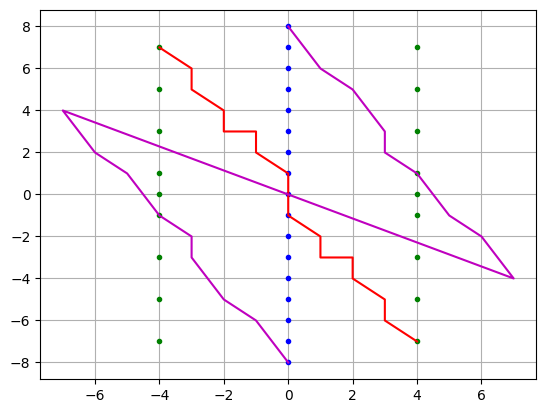

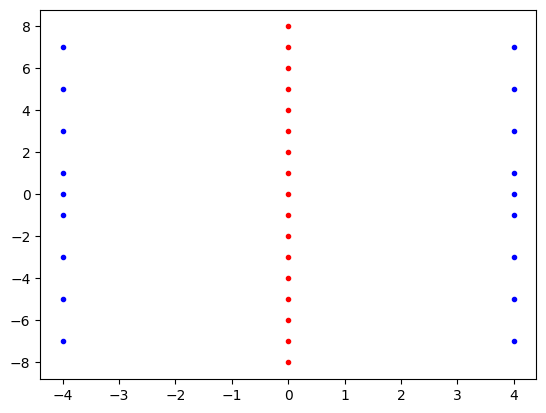

In [20]:
# datacy = np.arange(-8,9).reshape(1,-1)
# datacx = np.zeros((1,17))
# datac = np.swapaxes(np.swapaxes(np.array([datacx,datacy]),0,2),1,2)
# datasy = np.array([*np.arange(-7,0,2),0,*np.arange(1,8,2),*np.arange(-7,0,2),0,*np.arange(1,8,2)]).reshape(1,-1)
# datasx = np.array([-4*np.ones((9)),4*np.ones((9))]).reshape(1,-1)
# datas = np.swapaxes(np.swapaxes(np.array([datasx,datasy]),0,2),1,2)
# plt.plot(datacx,datacy,'b.')
# plt.plot(datasx,datasy,'r.')
# plt.grid()
def rot_displace(dp,origindeg):
    dpvector = np.swapaxes(dp,1,2)
    origindeg = origindeg*np.pi/180
    backprocess = np.array([[np.cos(origindeg),np.sin(origindeg)], \
                            [-np.sin(origindeg),np.cos(origindeg)]])
    rotcord = np.matmul(backprocess,dpvector)
    rotidx = np.round(rotcord)
    return np.swapaxes(rotidx,1,2)
    
datacy = np.arange(-8,9).reshape(1,-1)
datacx = np.zeros((1,17))
datac = np.swapaxes(np.array([datacy,datacx]),0,2)
datasy = np.array([*np.arange(-7,0,2),0,*np.arange(1,8,2),*np.arange(-7,0,2),0,*np.arange(1,8,2)]).reshape(1,-1)
datasx = np.array([-4*np.ones((9)),4*np.ones((9))]).reshape(1,-1)
datas = np.swapaxes(np.array([datasy,datasx]),0,2)

# oldidx = rot_displace(datac,30)
plt.figure()
plt.plot(datac[:,:,1],datac[:,:,0],'b.')
plt.plot(datas[:,:,1],datas[:,:,0],'g.')
oldidx = rot_displace(datac,30)
plt.plot(oldidx[:,:,1],oldidx[:,:,0],'r')
oldidx = rot_displace(datas,30)
plt.plot(oldidx[:,:,1],oldidx[:,:,0],'m')
plt.grid()
plt.figure()
plt.plot(datacx,datacy,'r.')
plt.plot(datasx,datasy,'b.')


(17, 2, 1)

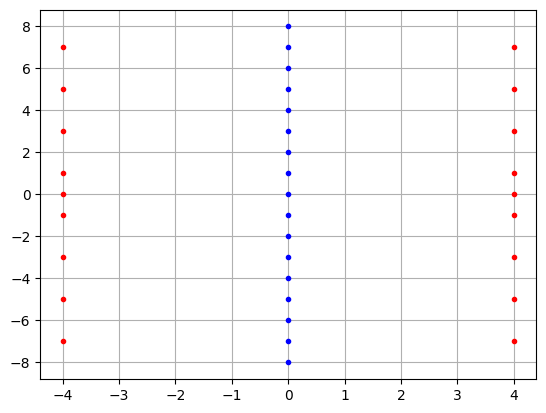

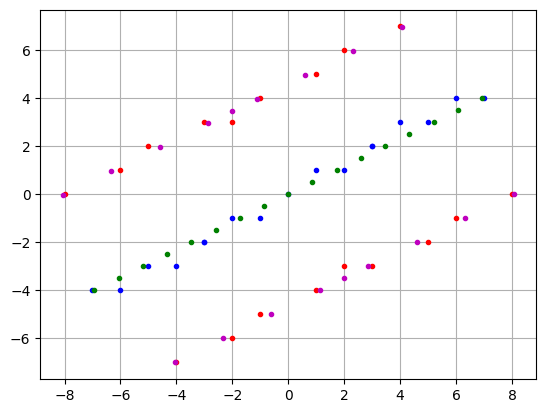

In [12]:
datacy = np.arange(-8,9).reshape(1,-1)
datacx = np.zeros((1,17))
datac = np.swapaxes(np.swapaxes(np.array([datacx,datacy]),0,2),1,2)
datasy = np.array([*np.arange(-7,0,2),0,*np.arange(1,8,2),*np.arange(-7,0,2),0,*np.arange(1,8,2)]).reshape(1,-1)
datasx = np.array([-4*np.ones((9)),4*np.ones((9))]).reshape(1,-1)
datas = np.swapaxes(np.swapaxes(np.array([datasx,datasy]),0,2),1,2)
plt.plot(datacx,datacy,'b.')
plt.plot(datasx,datasy,'r.')
plt.grid()
origindeg=60*np.pi/180
backprocess = np.array([[np.cos(origindeg),np.sin(origindeg)], \
                            [-np.sin(origindeg),np.cos(origindeg)]])
oldcord = np.matmul(backprocess,datac)
oldidx = np.squeeze( np.round(oldcord), axis=2 )
plt.figure()
plt.plot(oldidx[:,0],oldidx[:,1],'b.')
plt.plot(oldcord[:,0],oldcord[:,1],'g.')
oldcord = np.matmul(backprocess,datas)
oldidx = np.squeeze( np.round(oldcord), axis=2 )
plt.plot(oldidx[:,0],oldidx[:,1],'r.')
plt.plot(oldcord[:,0],oldcord[:,1],'m.')
plt.grid()


In [198]:
def flip_if_needed(arr):
    """
    Vectorized version:
    For each column in arr of shape (15, N),
    if mean(0:7) > mean(9:), flip the column vertically.
    """
    arr = arr.copy()
    M = arr.shape[0]
    half = M // 2
    # Compute column means
    mean_first = arr[:half, :].mean(axis=0)   # shape (N,)
    mean_last  = arr[half:, :].mean(axis=0)   # shape (N,)

    # Boolean mask of which columns to flip
    flip_mask = mean_first > mean_last

    # Flip only those columns
    arr[:, flip_mask] = arr[::-1, flip_mask]
    return arr

In [203]:
config = configparser.ConfigParser()
config.read("./NFGDA.ini")
export_preds_dir = config["Settings"]["export_preds_dir"]
evalbox_on = config.getboolean('Settings', 'evalbox_on')
train_dir = '../mat/train/'

case_name = 'KAMA20240227_21'

# case_name = 'KABX20200704_02'
# case_name = 'KABX20200721_19'
exp_preds_event = export_preds_dir + case_name
npz_list = glob.glob(exp_preds_event + "/*npz")
true_buf = []
false_buf = []


./tracking_points/nf_preds/KABX20200704_02/nf_pred_02_KABX20200704_022322_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_03_KABX20200704_022945_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_04_KABX20200704_023622_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_05_KABX20200704_024300_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_06_KABX20200704_024922_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_07_KABX20200704_025724_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_08_KABX20200704_030346_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_09_KABX20200704_031036_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_10_KABX20200704_031714_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_11_KABX20200704_032421_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_12_KABX20200704_033128_V06.npz


/tmp/ipykernel_236444/4033943135.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


./tracking_points/nf_preds/KABX20200704_02/nf_pred_13_KABX20200704_033835_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_14_KABX20200704_034542_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_15_KABX20200704_035248_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_16_KABX20200704_035955_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_17_KABX20200704_040647_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_18_KABX20200704_041310_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_19_KABX20200704_041931_V06.npz
./tracking_points/nf_preds/KABX20200704_02/nf_pred_20_KABX20200704_042553_V06.npz


<Figure size 640x480 with 0 Axes>

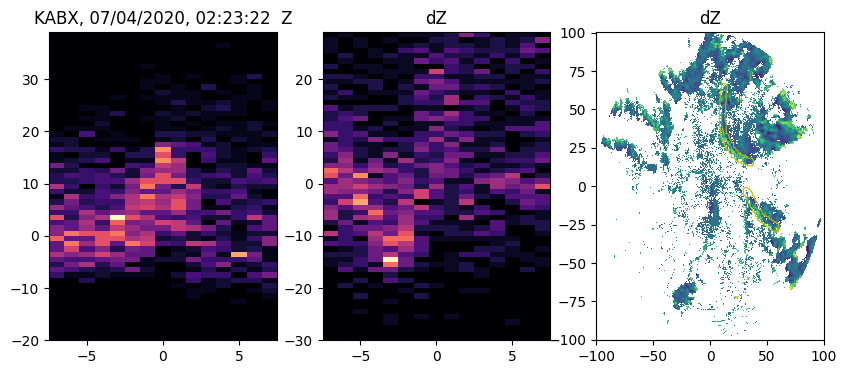

<Figure size 640x480 with 0 Axes>

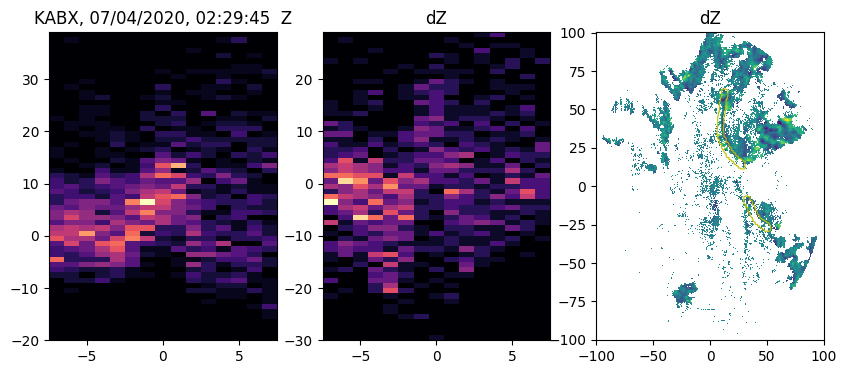

<Figure size 640x480 with 0 Axes>

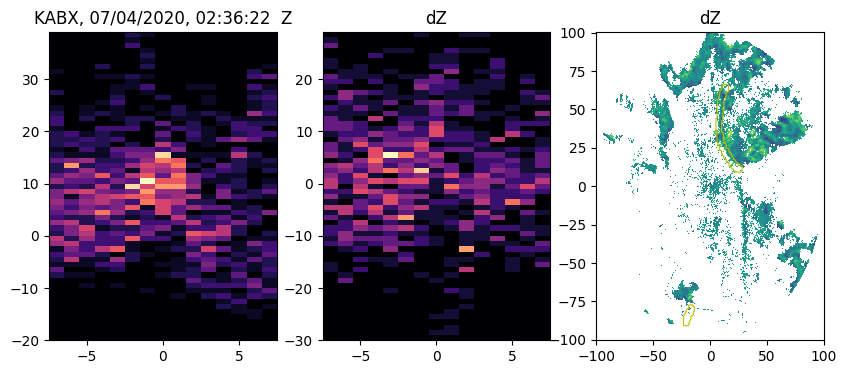

<Figure size 640x480 with 0 Axes>

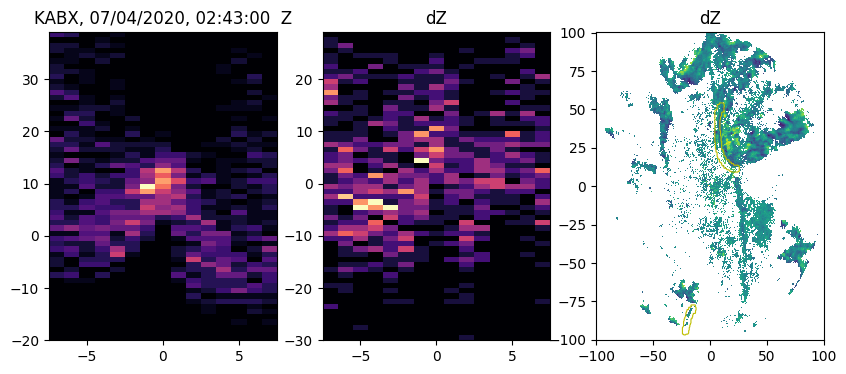

<Figure size 640x480 with 0 Axes>

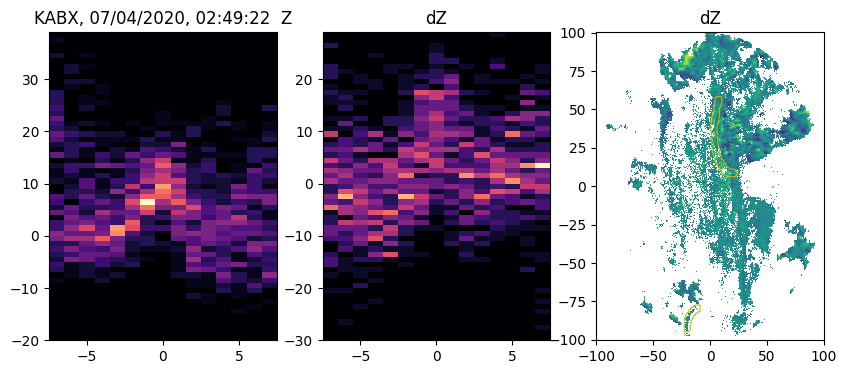

<Figure size 640x480 with 0 Axes>

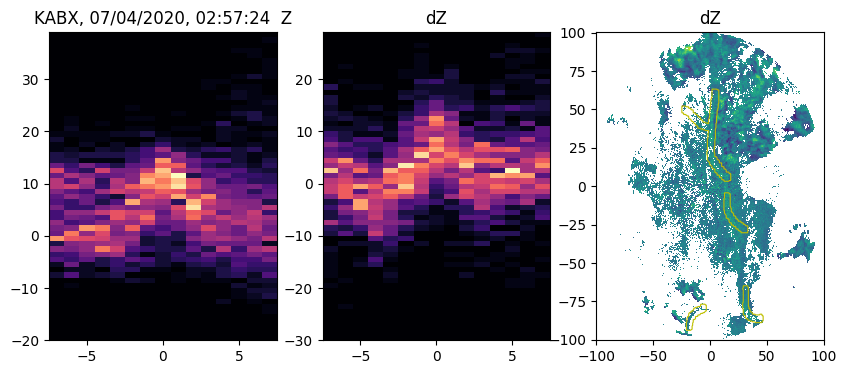

<Figure size 640x480 with 0 Axes>

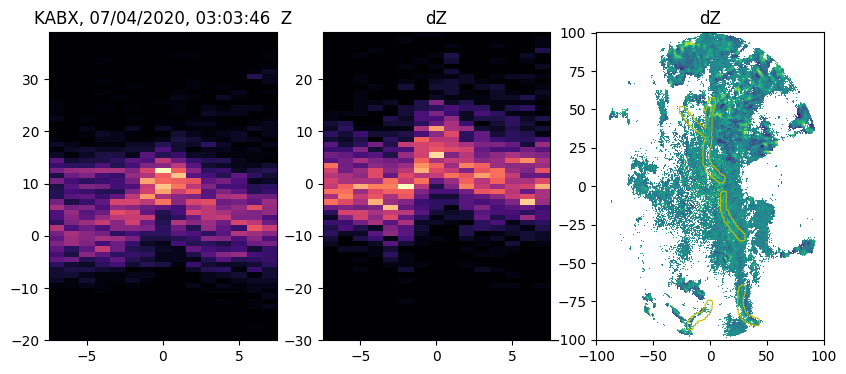

<Figure size 640x480 with 0 Axes>

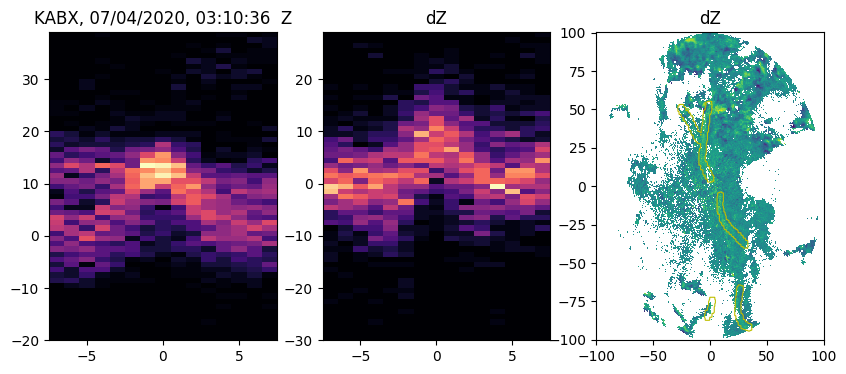

<Figure size 640x480 with 0 Axes>

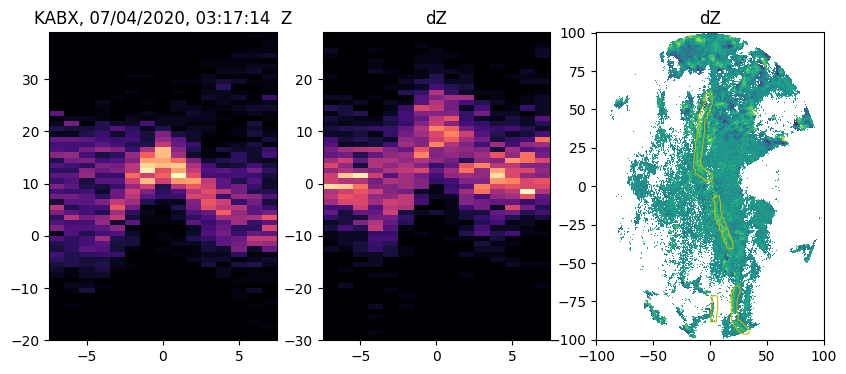

<Figure size 640x480 with 0 Axes>

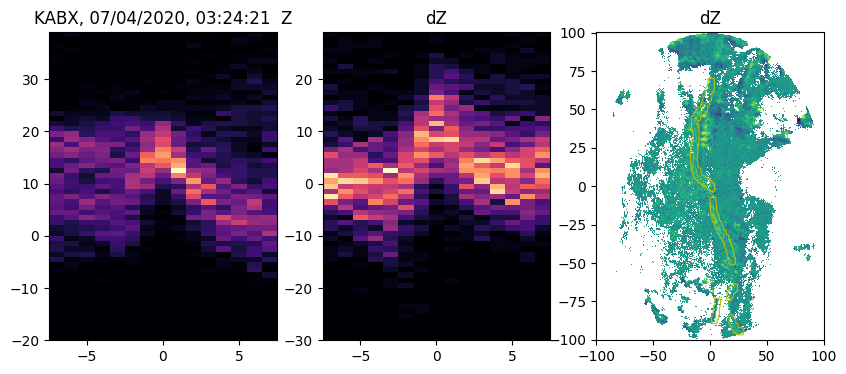

<Figure size 640x480 with 0 Axes>

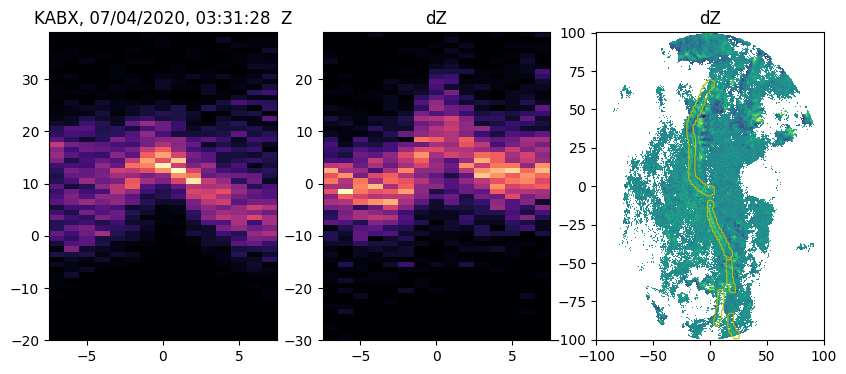

<Figure size 640x480 with 0 Axes>

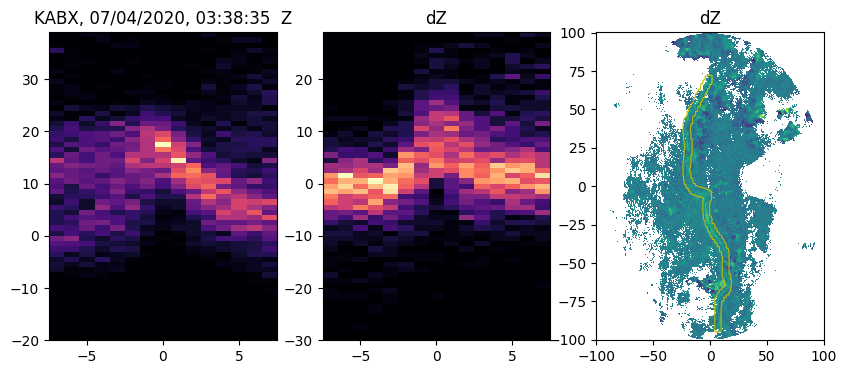

<Figure size 640x480 with 0 Axes>

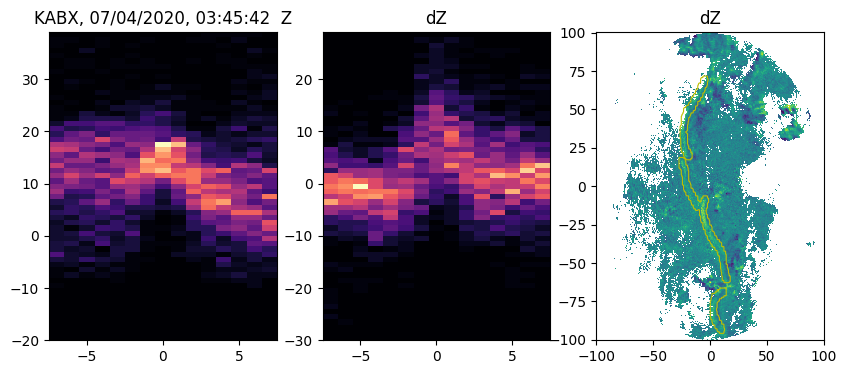

<Figure size 640x480 with 0 Axes>

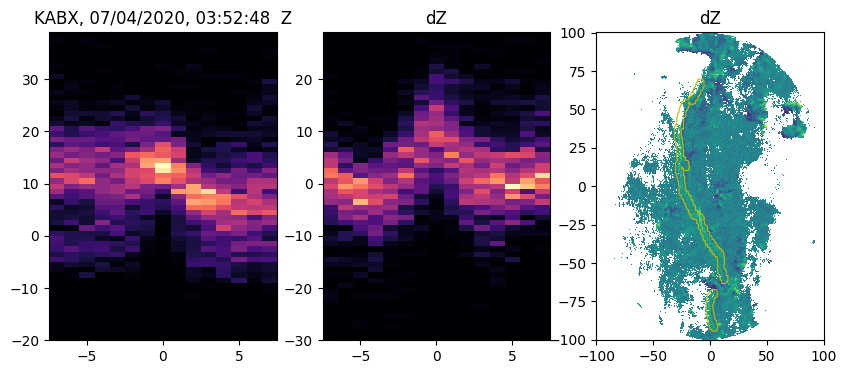

<Figure size 640x480 with 0 Axes>

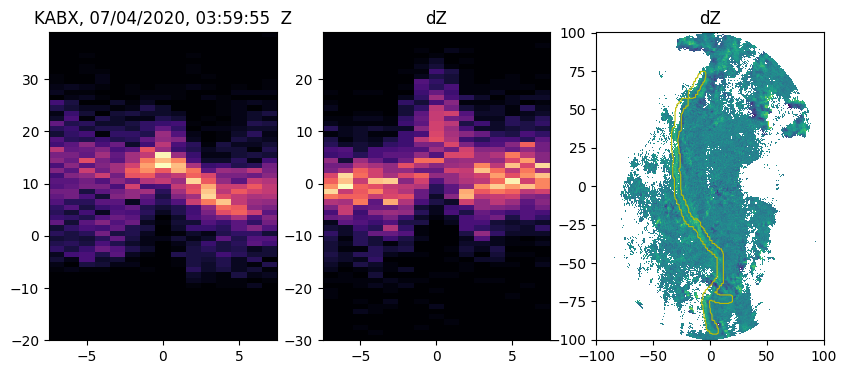

<Figure size 640x480 with 0 Axes>

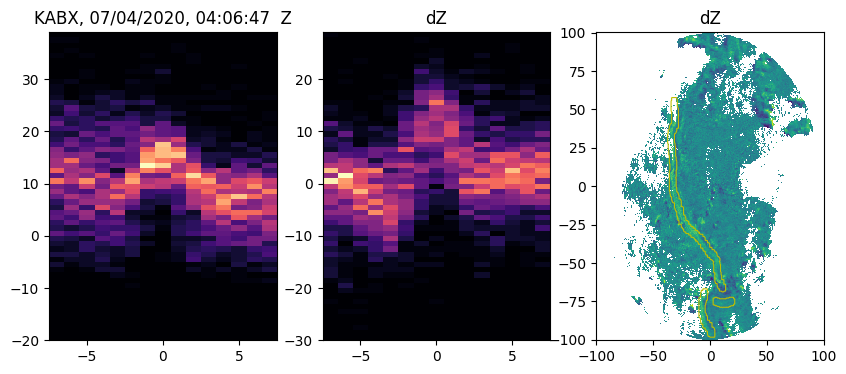

<Figure size 640x480 with 0 Axes>

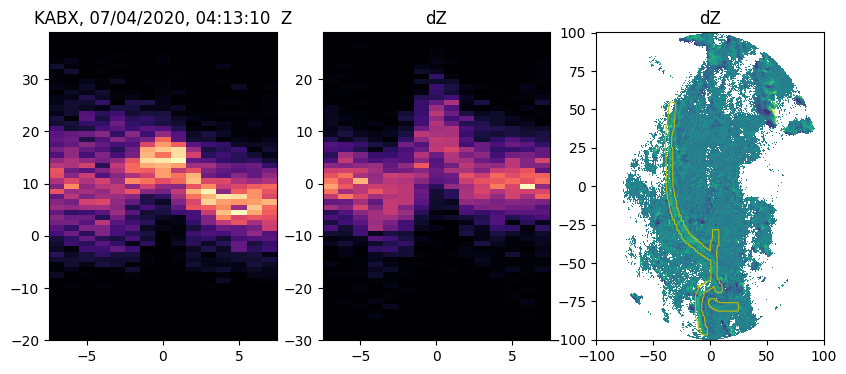

<Figure size 640x480 with 0 Axes>

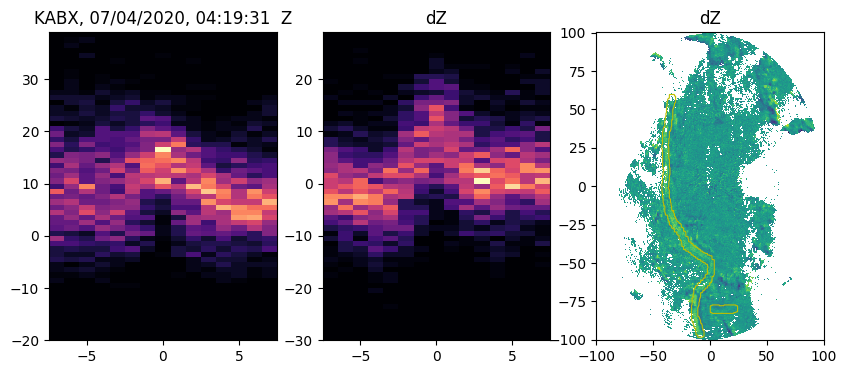

<Figure size 640x480 with 0 Axes>

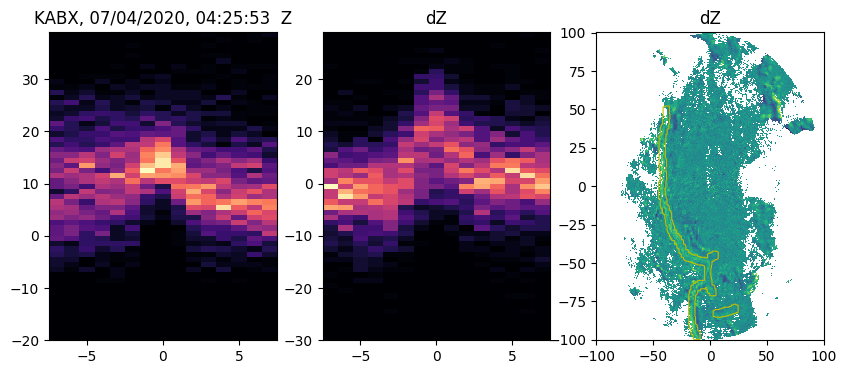

In [202]:
leng=15
ds = np.arange(-(leng//2),(leng+1)//2)
for ppi_file in npz_list:
    plt.figure()
    print(ppi_file)
    data = np.load(ppi_file)
    evalbox = data['evalbox']
    evalline = skeletonize(evalbox)
    theta, coherence, valid = orientation_from_binary(evalline, sigma=3)
    
    x,y =  cross_section(theta[evalline], data['xi2'][evalline], data['yi2'][evalline],data['xi2'],data['yi2'], length=leng)
    # plt.figure()
    # plt.plot(data['xi2'][evalline],data['yi2'][evalline],'k.')
    # plt.plot(data['xi2'][x,y],data['yi2'][x,y])
    # plt.title('')
    
    # plt.figure()
    # plt.plot(ds,data['diffz'][x,y])
    # plt.title('')

    ppi_id = os.path.basename(ppi_file)
    ppi_name = ppi_id[11:]  # MATLAB 12:end is Python 11: (0-based)
    date_part = ppi_name[4:12]   # 5:12 in MATLAB → 4:12 in Python
    time_part = ppi_name[13:19]

    radar_id = ppi_name[0:4]  # 1:4 in MATLAB → 0:4 in Python
    tstamp_date = datetime.strptime(date_part, "%Y%m%d")
    tstamp_time = datetime.strptime(time_part, "%H%M%S").time()
    tstamp = datetime.combine(tstamp_date.date(), tstamp_time)
    ppi_desc = f"{radar_id}, {tstamp.strftime('%m/%d/%Y, %H:%M:%S %Z')}"
    
    z = data['inputNF'][x,y,1].ravel()
    cx = np.tile(ds[:, None], (1, x.shape[1])).ravel()
    dZ = flip_if_needed(data['diffz'][x,y]).ravel()

    fig, ax = plt.subplots(1, 3, figsize=(10, 4))  # 1 row, 2 cols
  
    ax[0].hist2d(cx[np.isfinite(z)], z[np.isfinite(z)], bins=(np.arange(-leng//2, (leng+1)//2, 1)+0.5, np.arange(-20, 40, 1)), cmap='magma')
    ax[0].set_title(ppi_desc + ' Z')

    ax[1].hist2d(cx[np.isfinite(dZ)], dZ[np.isfinite(dZ)], bins=(np.arange(-leng//2, (leng+1)//2, 1)+0.5, np.arange(-30, 30, 1)), cmap='magma')
    ax[1].set_title('dZ')

    ax[2].pcolormesh(data['xi2'],data['yi2'],data['diffz'])
    ax[2].contour(data['xi2'],data['yi2'],evalbox,[0.5], colors='y',linewidths=0.8)
    ax[2].set_title('dZ')

In [ ]:
config = configparser.ConfigParser()
config.read("./NFGDA.ini")
export_preds_dir = config["Settings"]["export_preds_dir"]
evalbox_on = config.getboolean('Settings', 'evalbox_on')
train_dir = '../mat/train/'

case_name = 'KAMA20240227_21'

# case_name = 'KABX20200704_02'
# case_name = 'KABX20200721_19'
exp_preds_event = export_preds_dir + case_name
npz_list = glob.glob(exp_preds_event + "/*npz")
true_buf = []
false_buf = []


./tracking_points/nf_preds/KAMA20240227_21/nf_pred_02_KAMA20240227_213943_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_03_KAMA20240227_214919_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_04_KAMA20240227_215858_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_05_KAMA20240227_220835_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_06_KAMA20240227_221813_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_07_KAMA20240227_222751_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_08_KAMA20240227_223728_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_09_KAMA20240227_224706_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_10_KAMA20240227_225645_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_11_KAMA20240227_230623_V06.npz


/tmp/ipykernel_236444/751031548.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


./tracking_points/nf_preds/KAMA20240227_21/nf_pred_12_KAMA20240227_231613_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_13_KAMA20240227_232037_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_14_KAMA20240227_232512_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_15_KAMA20240227_232946_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_16_KAMA20240227_233421_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_17_KAMA20240227_233856_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_18_KAMA20240227_234347_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_19_KAMA20240227_234821_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_20_KAMA20240227_235256_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_21_KAMA20240227_235731_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_22_KAMA20240228_000220_V06.npz
./tracking_points/nf_preds/KAMA20240227_21/nf_pred_23_KAMA20240228_000655_V06.npz
./tracking_point

<Figure size 640x480 with 0 Axes>

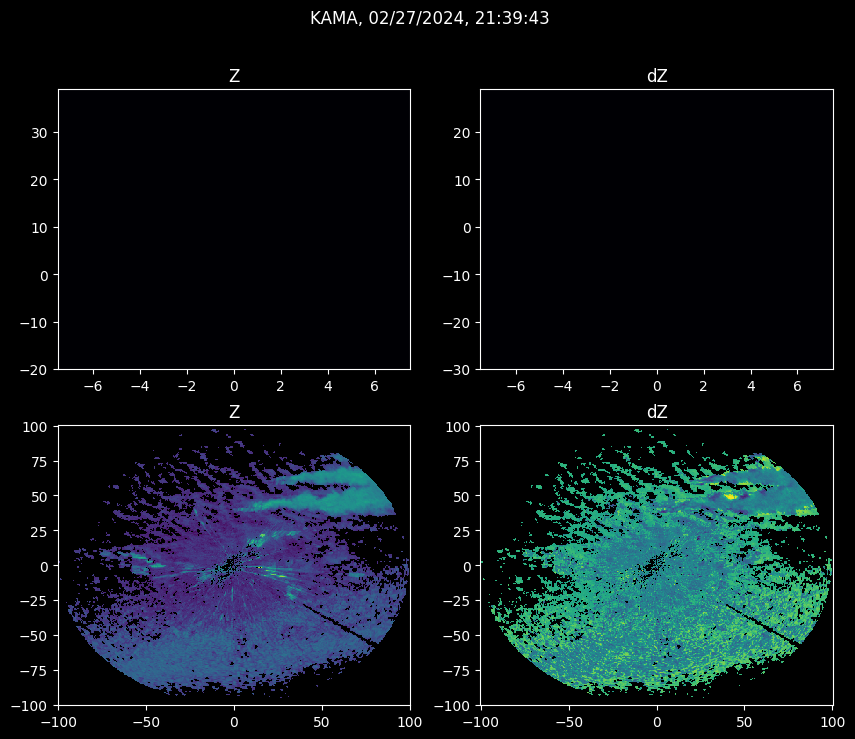

<Figure size 640x480 with 0 Axes>

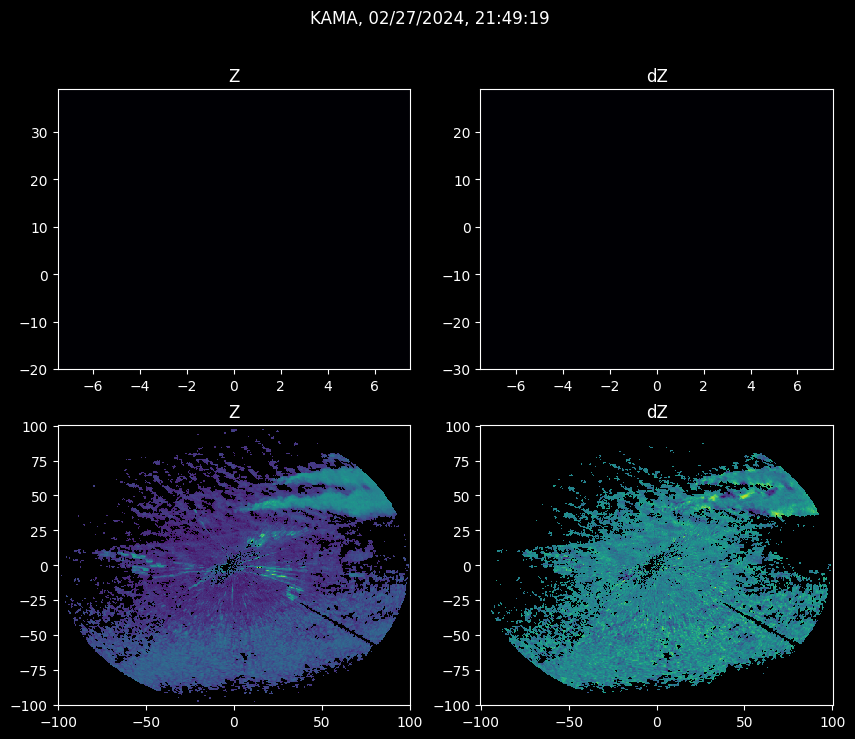

<Figure size 640x480 with 0 Axes>

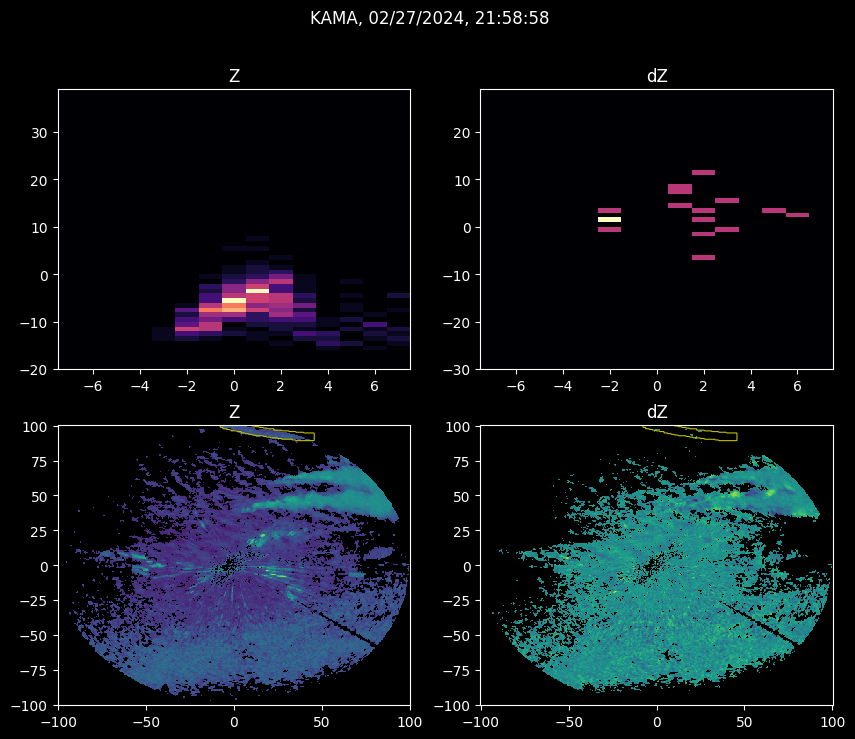

<Figure size 640x480 with 0 Axes>

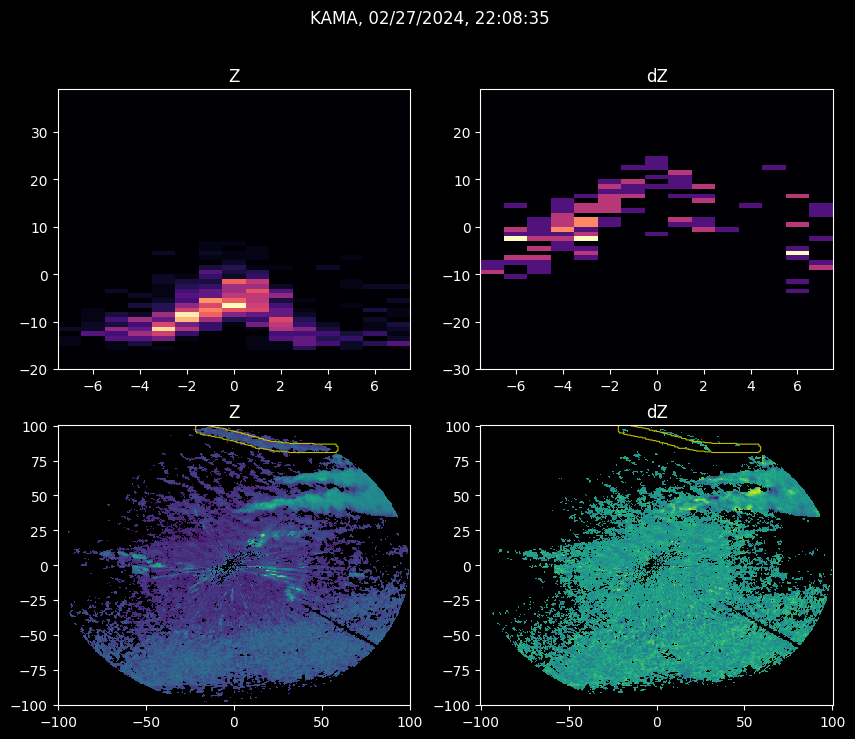

<Figure size 640x480 with 0 Axes>

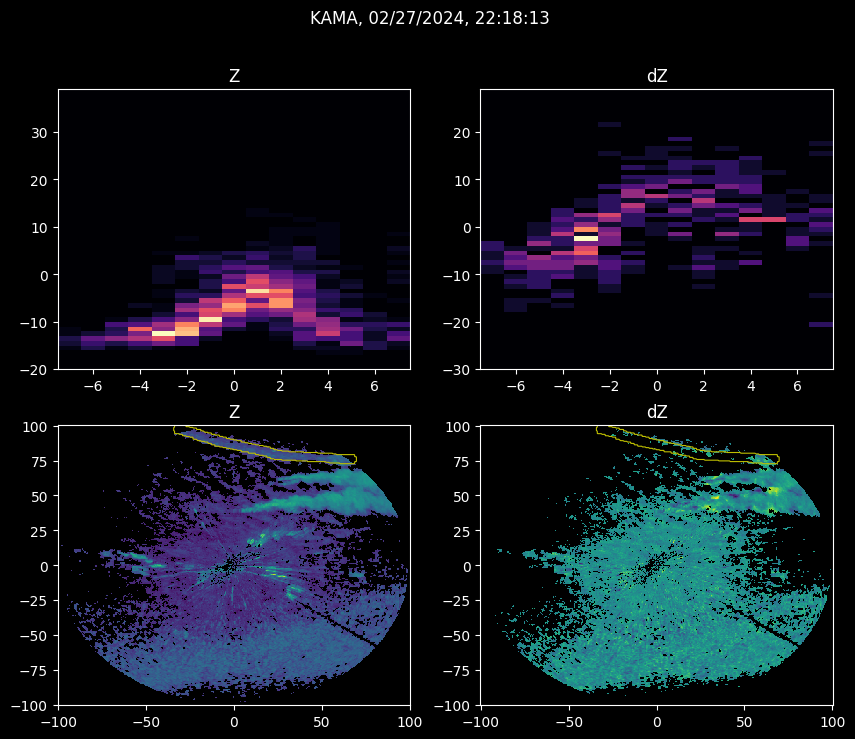

<Figure size 640x480 with 0 Axes>

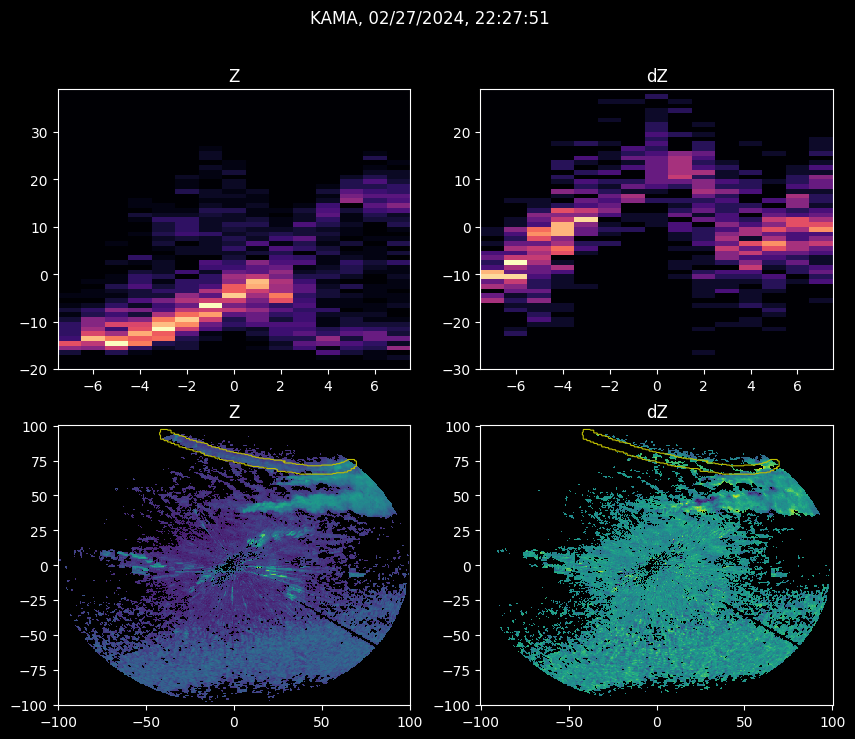

<Figure size 640x480 with 0 Axes>

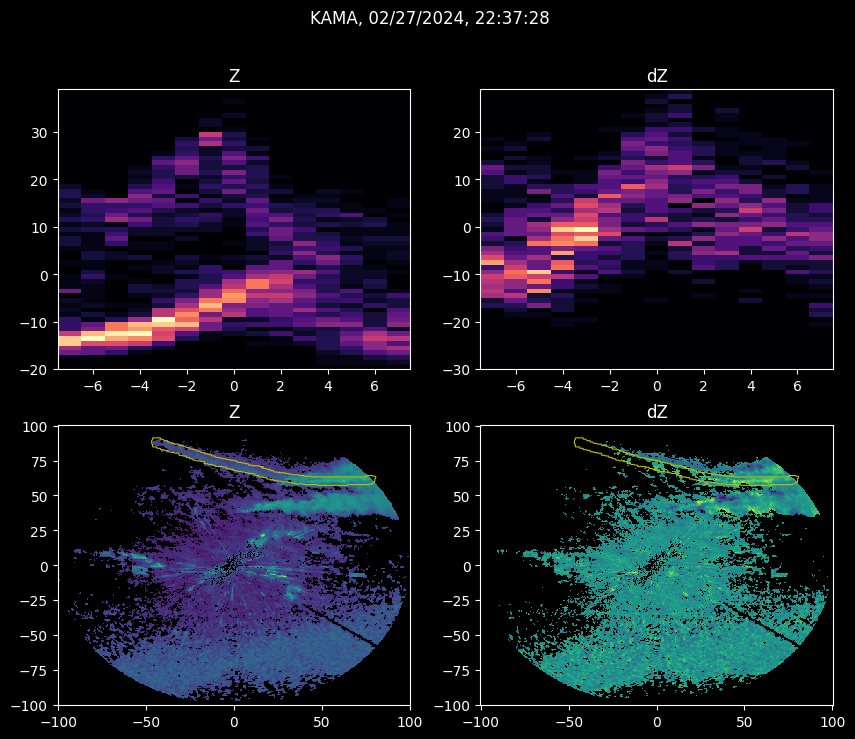

<Figure size 640x480 with 0 Axes>

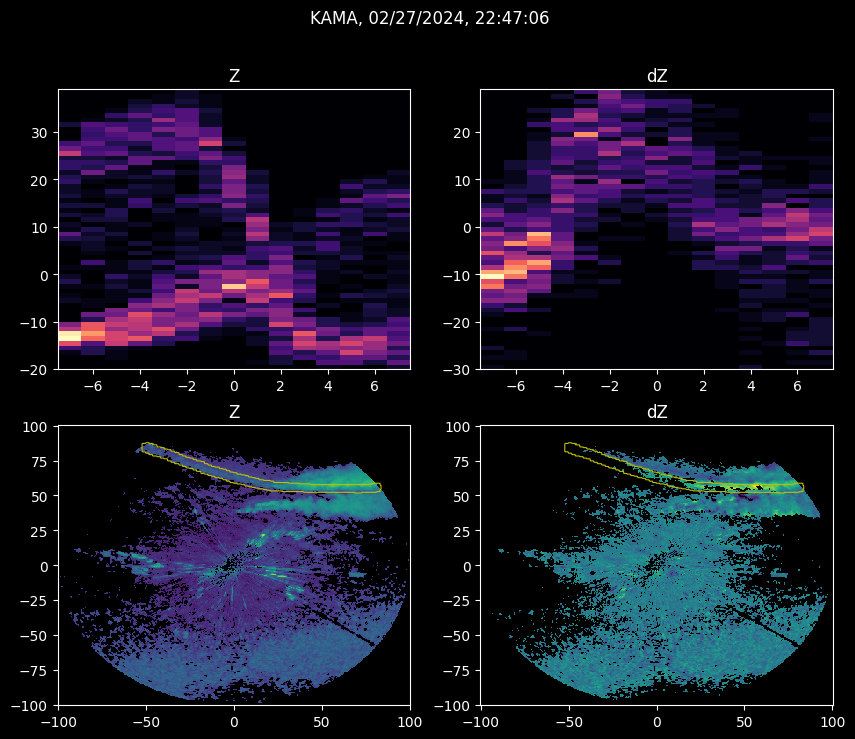

<Figure size 640x480 with 0 Axes>

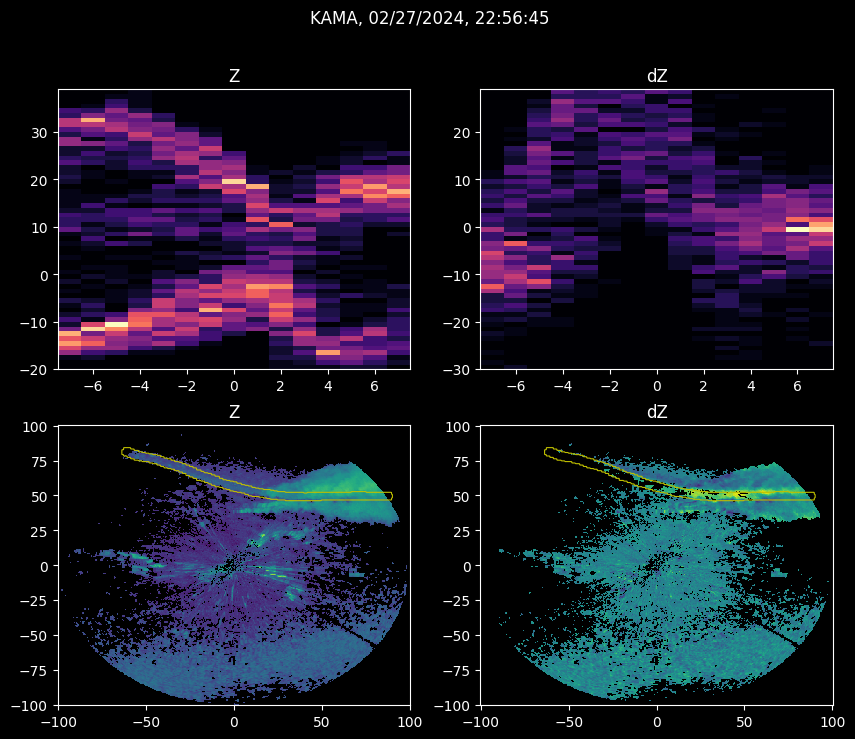

<Figure size 640x480 with 0 Axes>

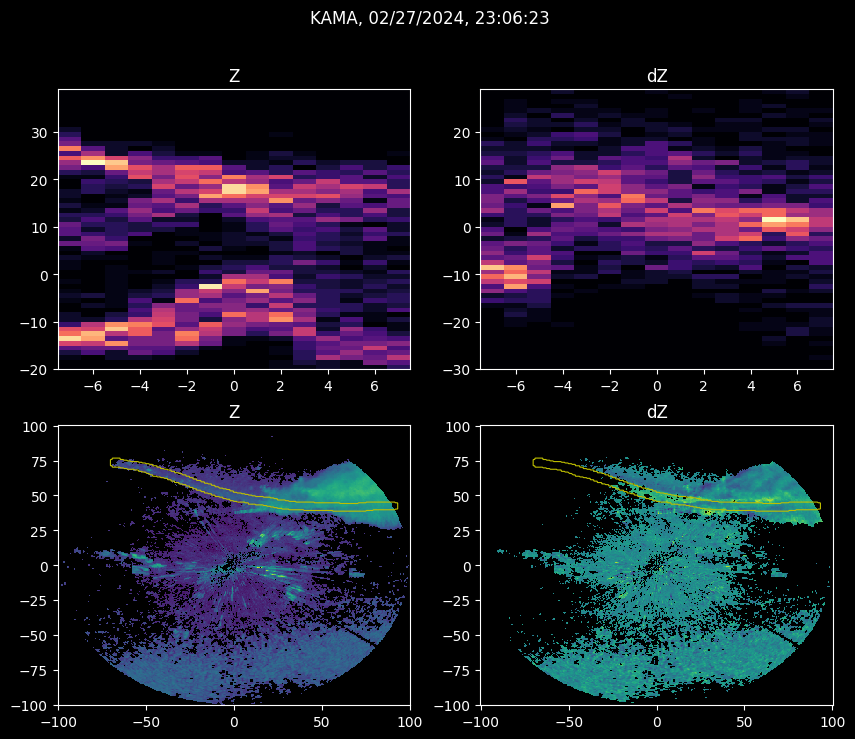

<Figure size 640x480 with 0 Axes>

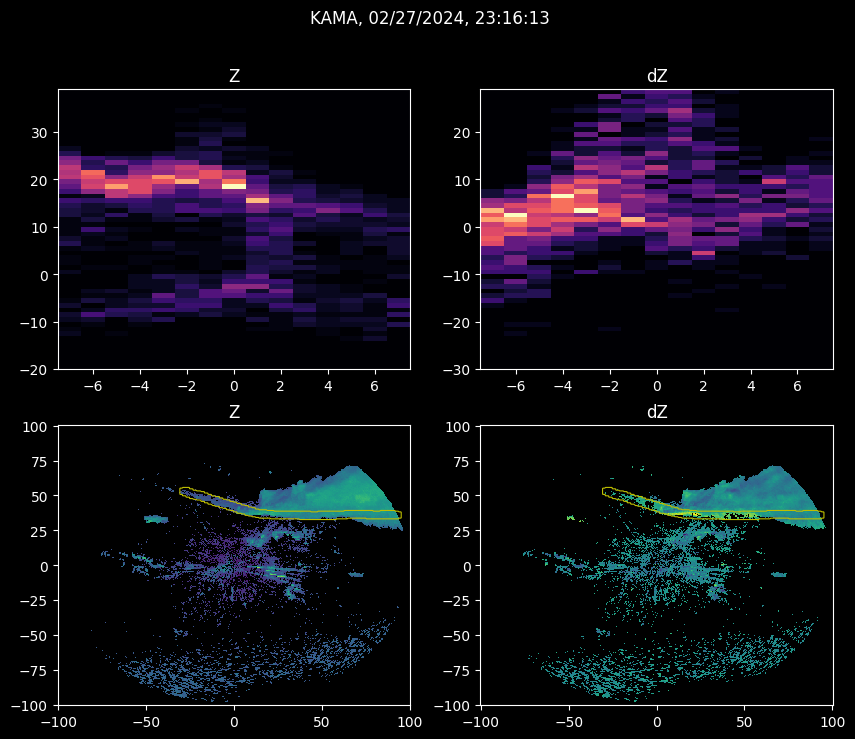

<Figure size 640x480 with 0 Axes>

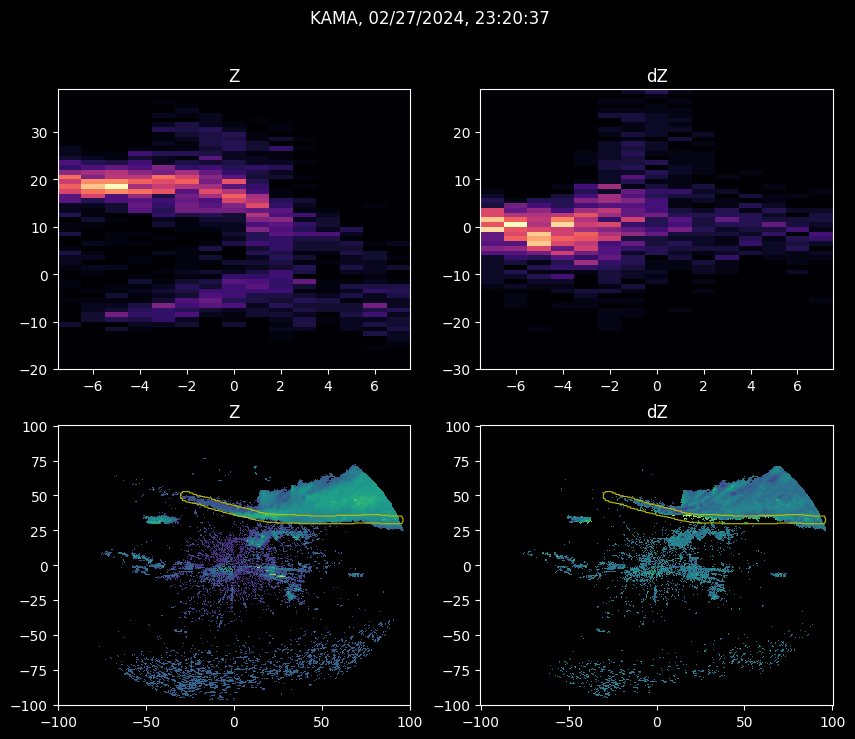

<Figure size 640x480 with 0 Axes>

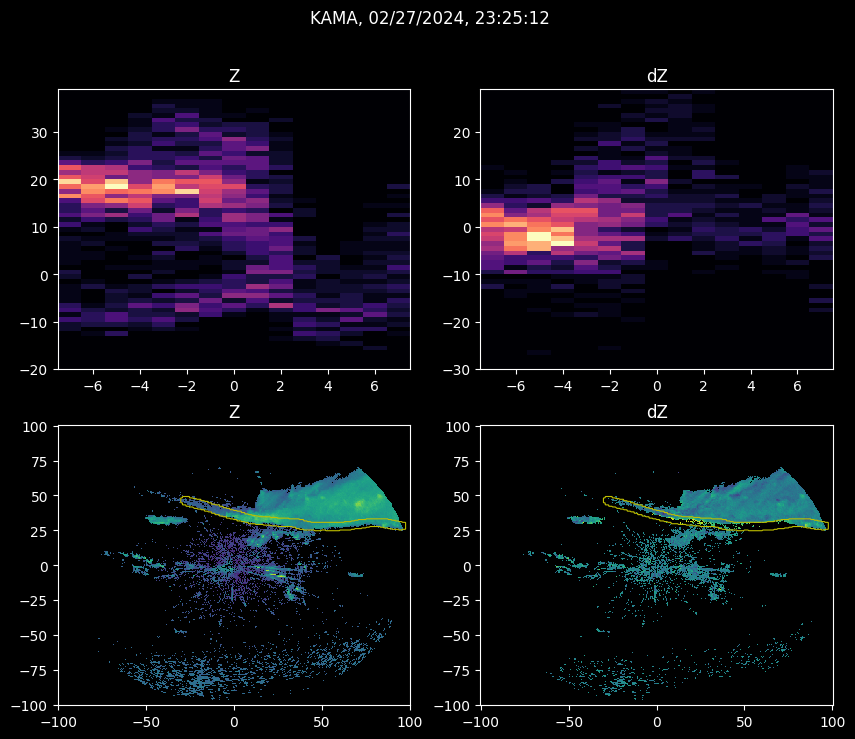

<Figure size 640x480 with 0 Axes>

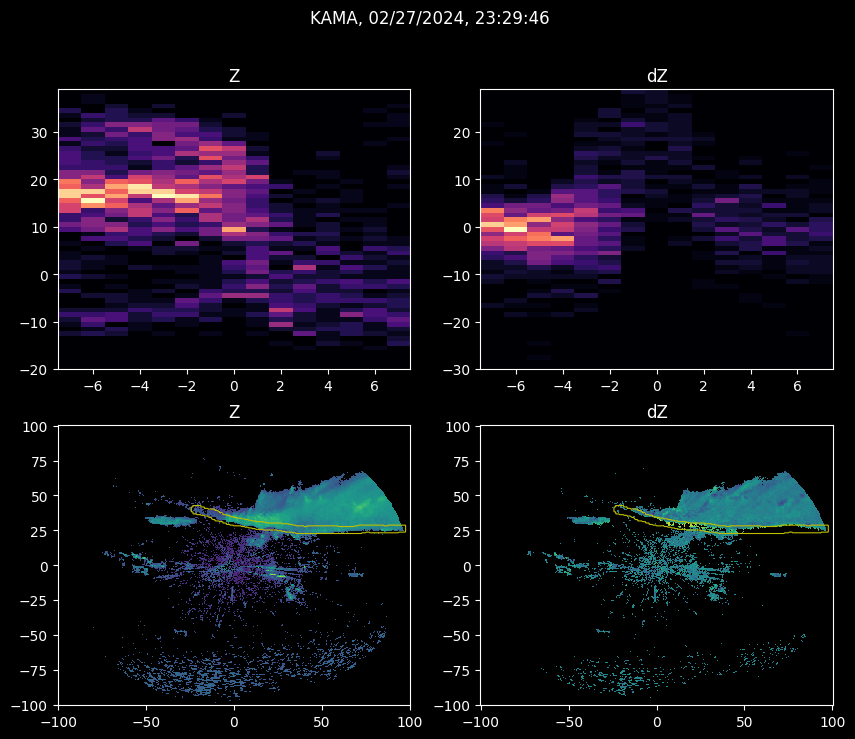

<Figure size 640x480 with 0 Axes>

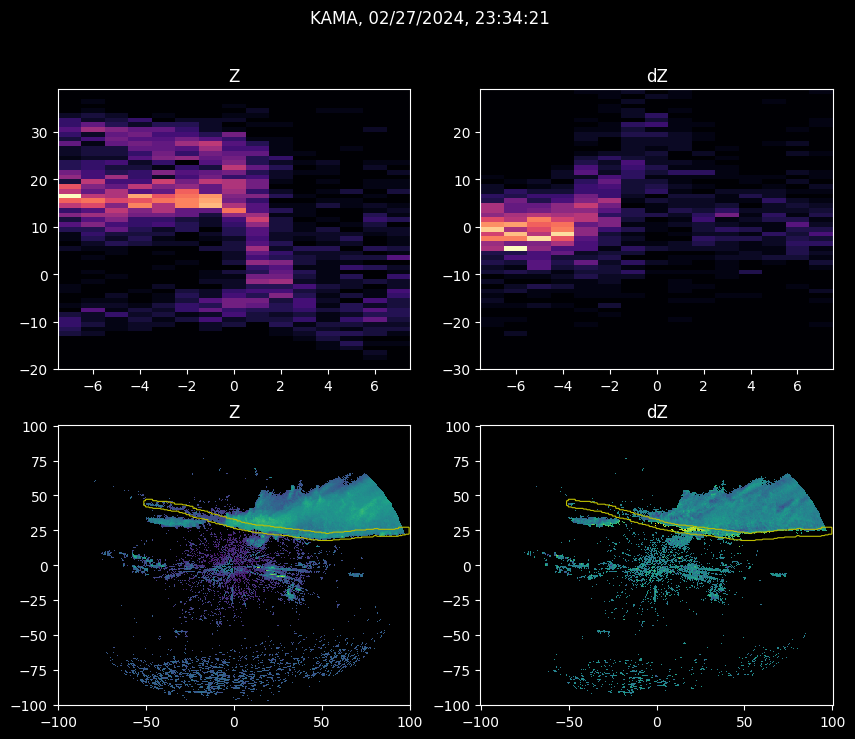

<Figure size 640x480 with 0 Axes>

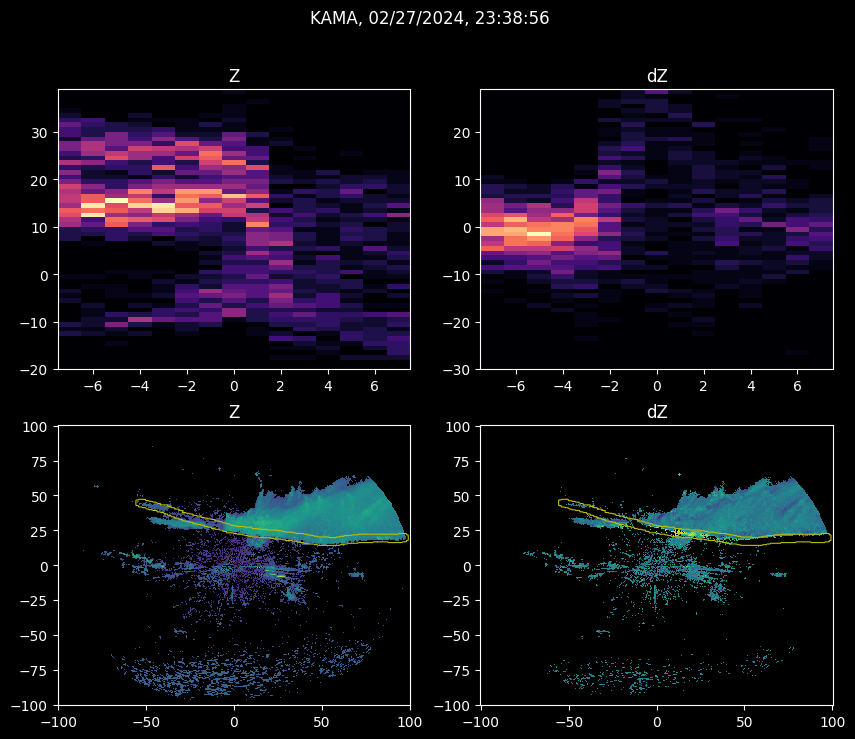

<Figure size 640x480 with 0 Axes>

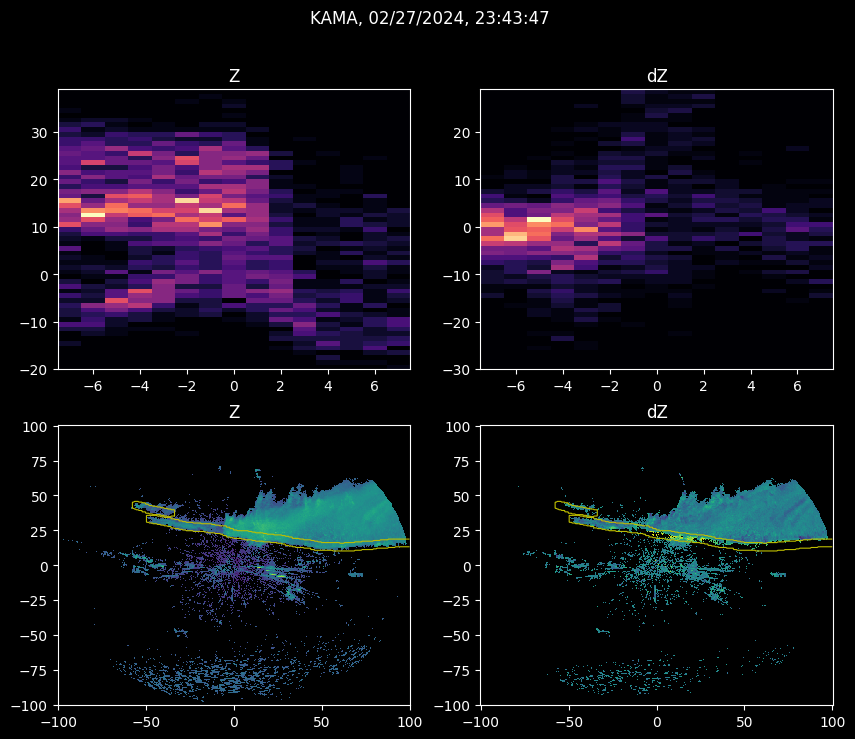

<Figure size 640x480 with 0 Axes>

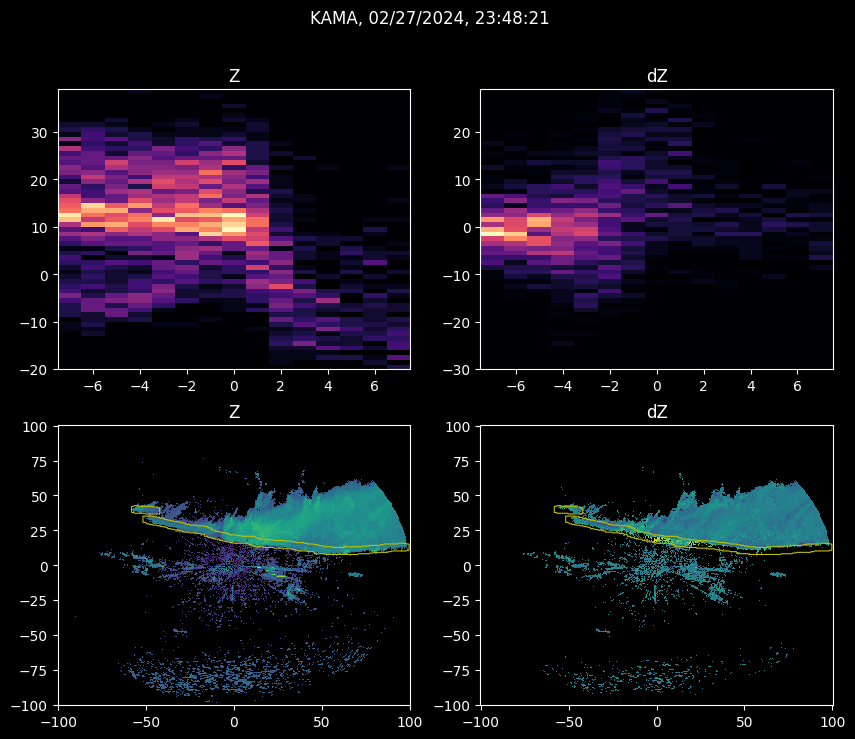

<Figure size 640x480 with 0 Axes>

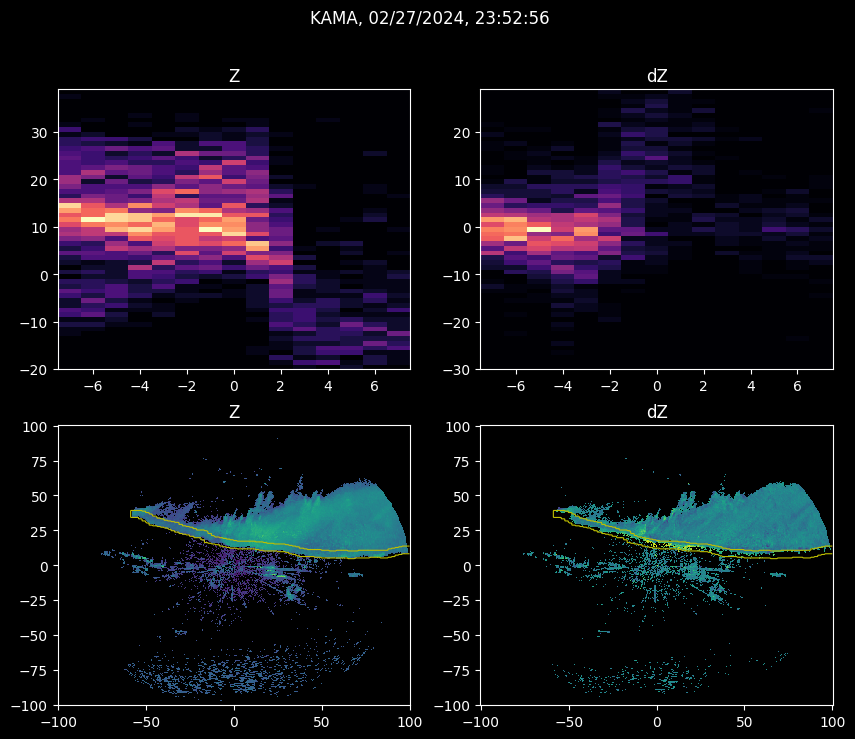

<Figure size 640x480 with 0 Axes>

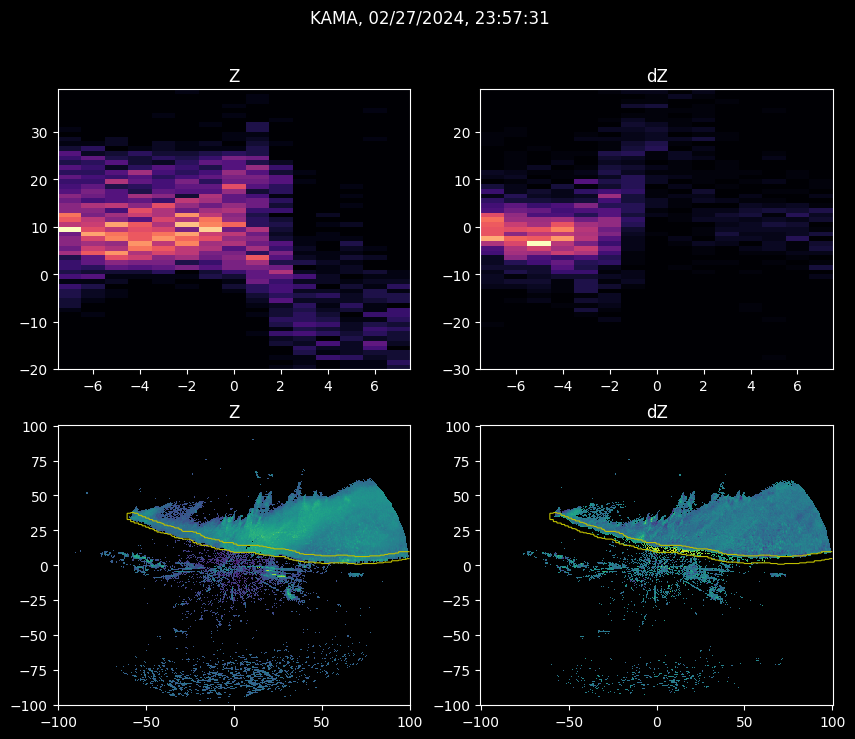

<Figure size 640x480 with 0 Axes>

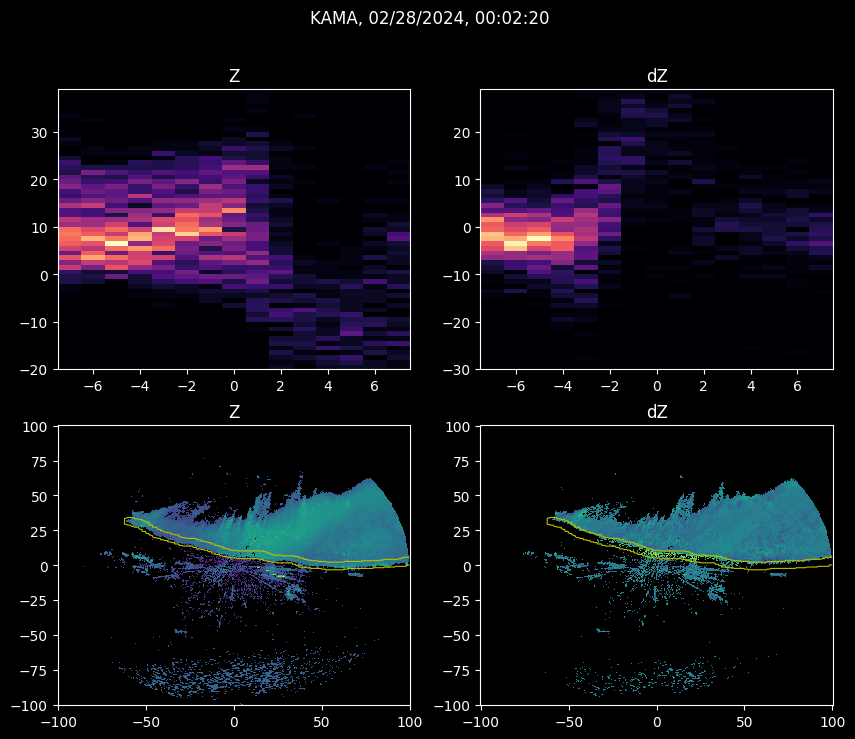

<Figure size 640x480 with 0 Axes>

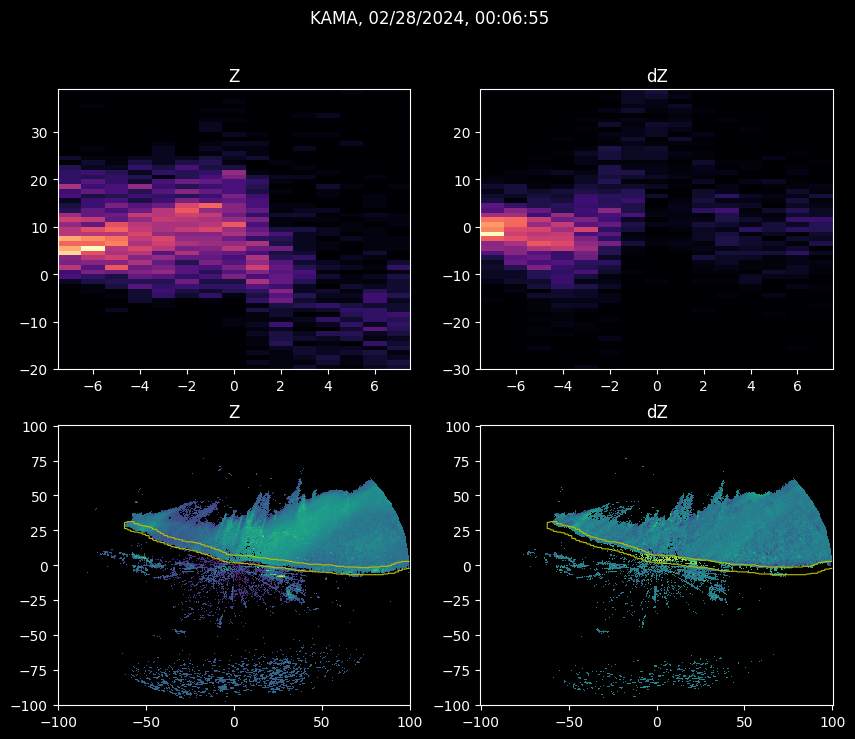

<Figure size 640x480 with 0 Axes>

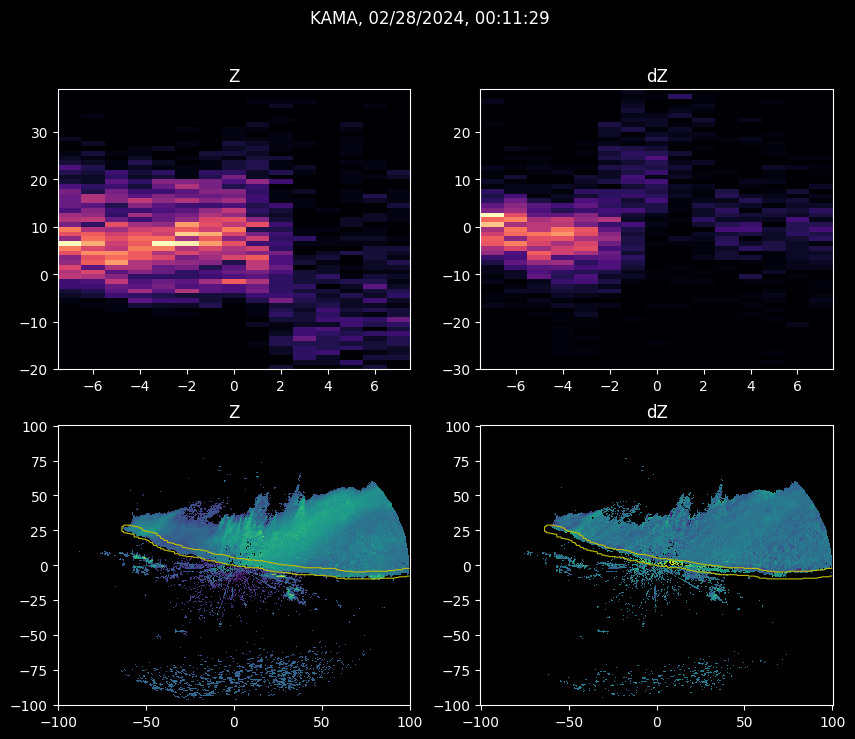

<Figure size 640x480 with 0 Axes>

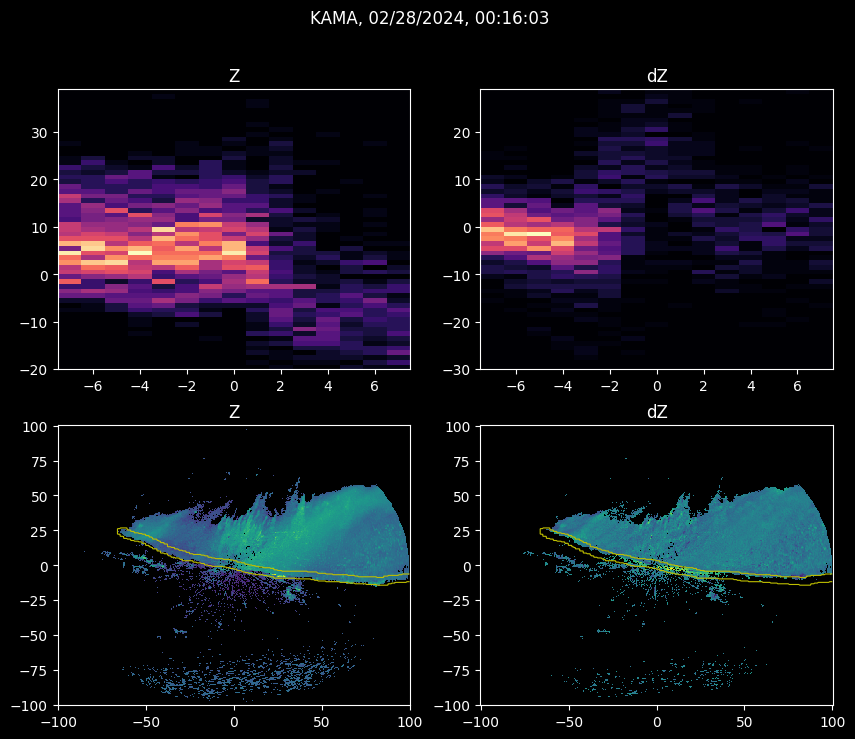

<Figure size 640x480 with 0 Axes>

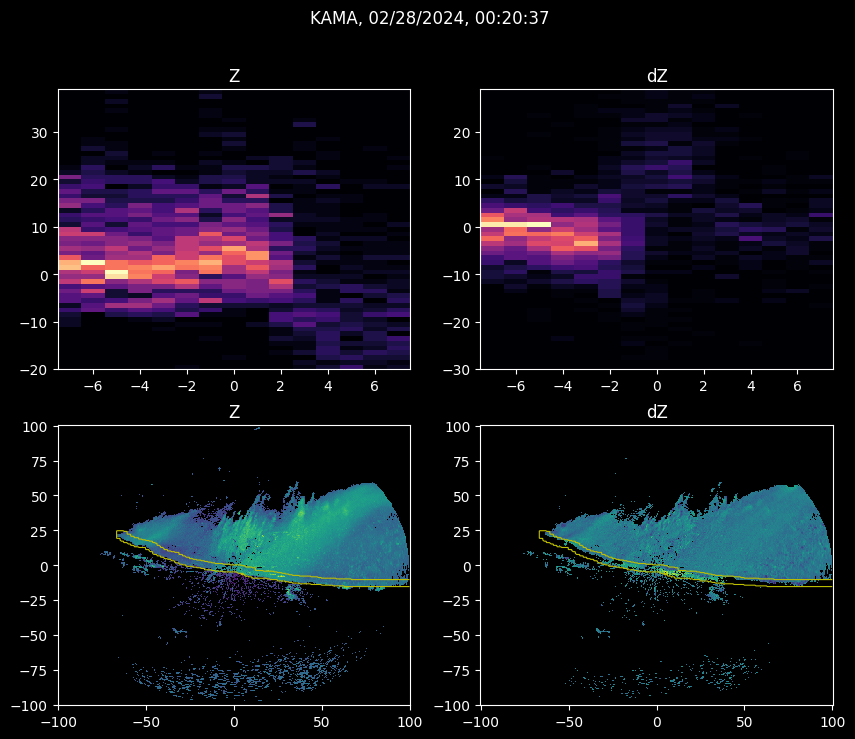

<Figure size 640x480 with 0 Axes>

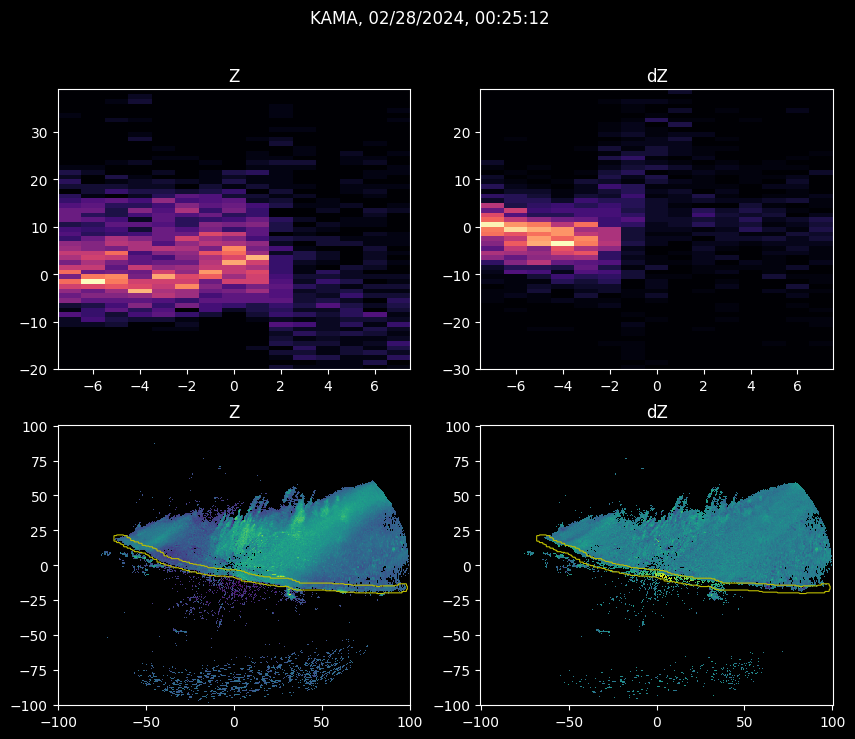

<Figure size 640x480 with 0 Axes>

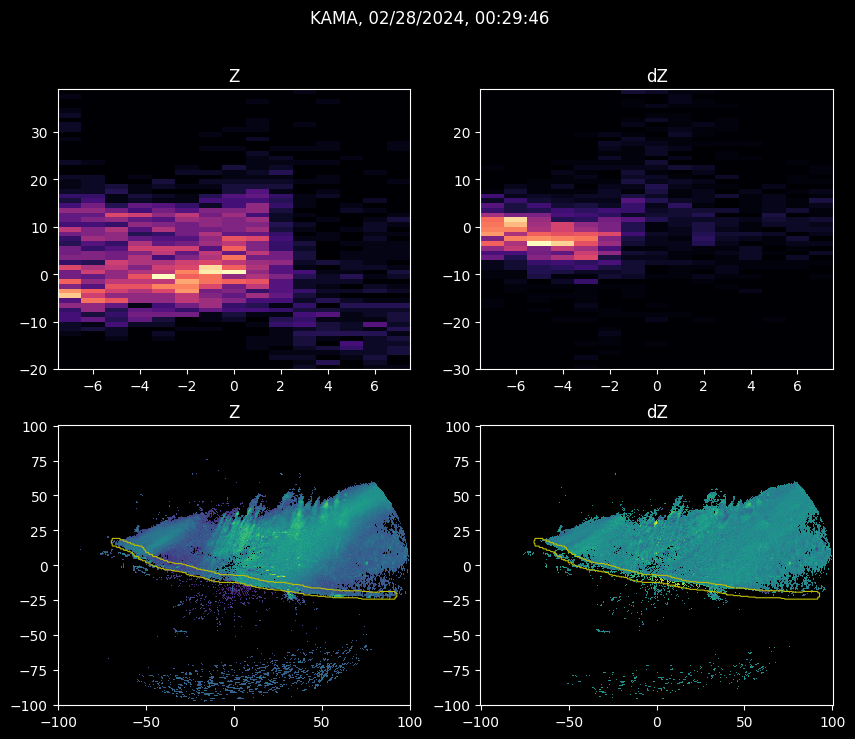

<Figure size 640x480 with 0 Axes>

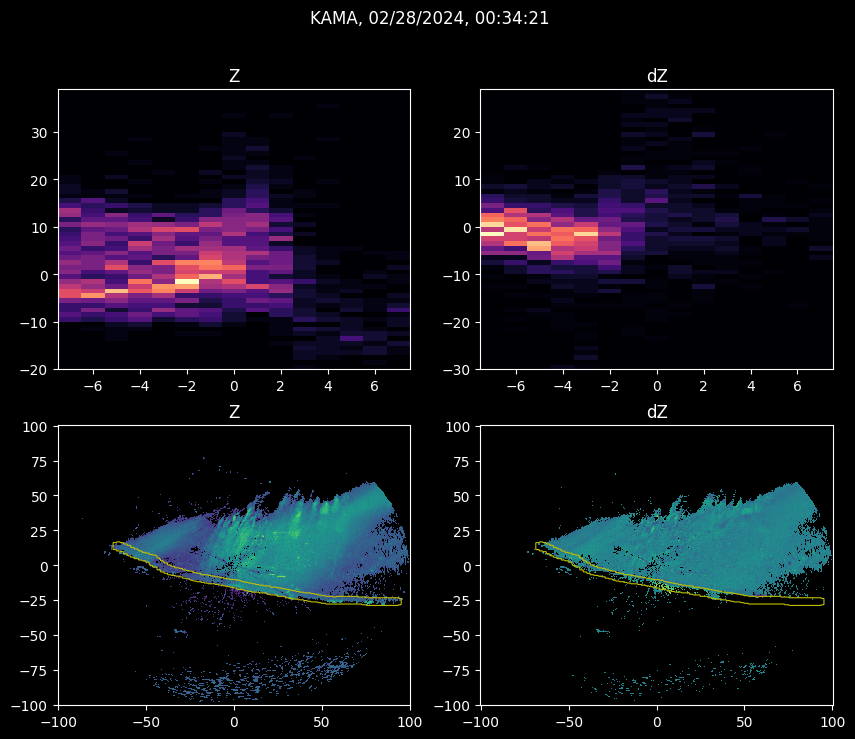

<Figure size 640x480 with 0 Axes>

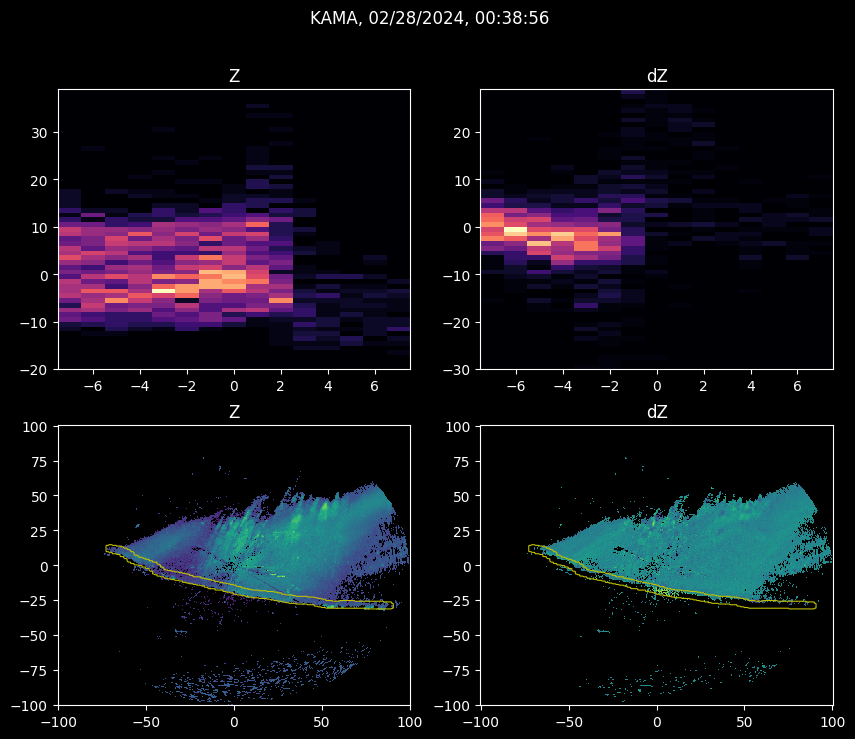

<Figure size 640x480 with 0 Axes>

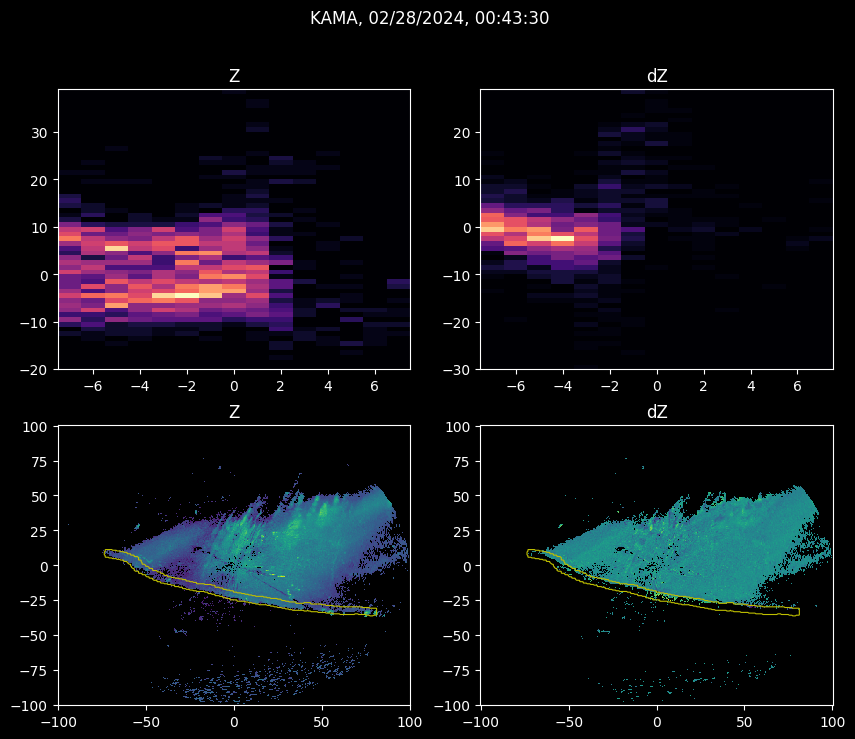

<Figure size 640x480 with 0 Axes>

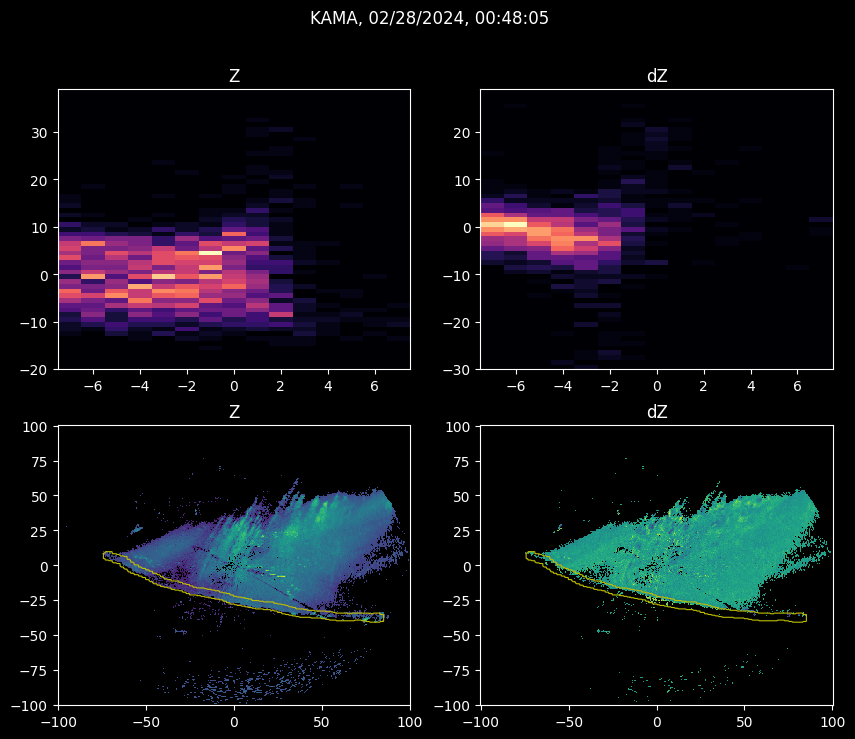

<Figure size 640x480 with 0 Axes>

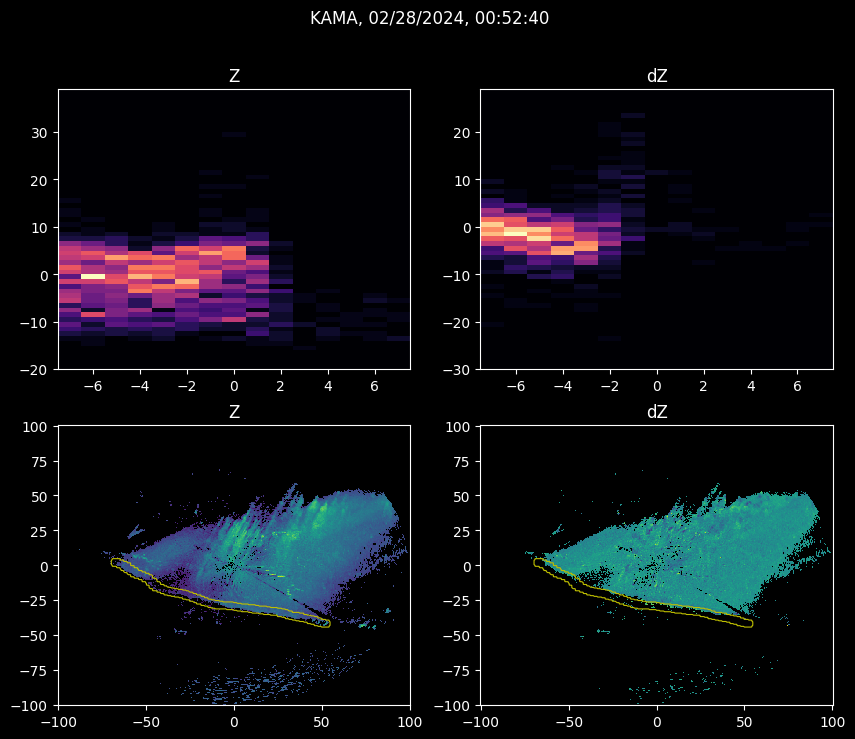

<Figure size 640x480 with 0 Axes>

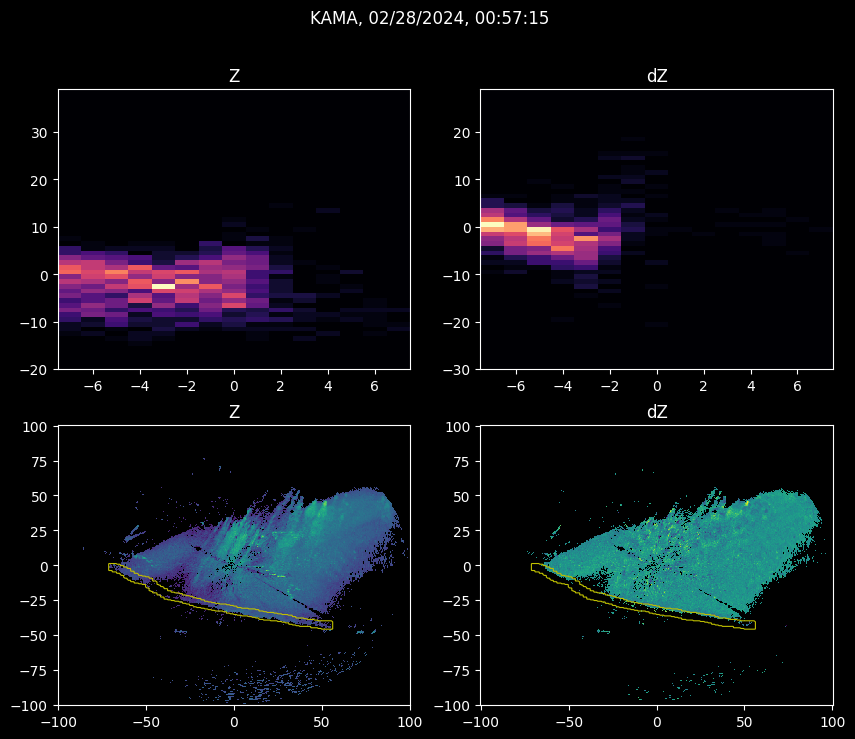

<Figure size 640x480 with 0 Axes>

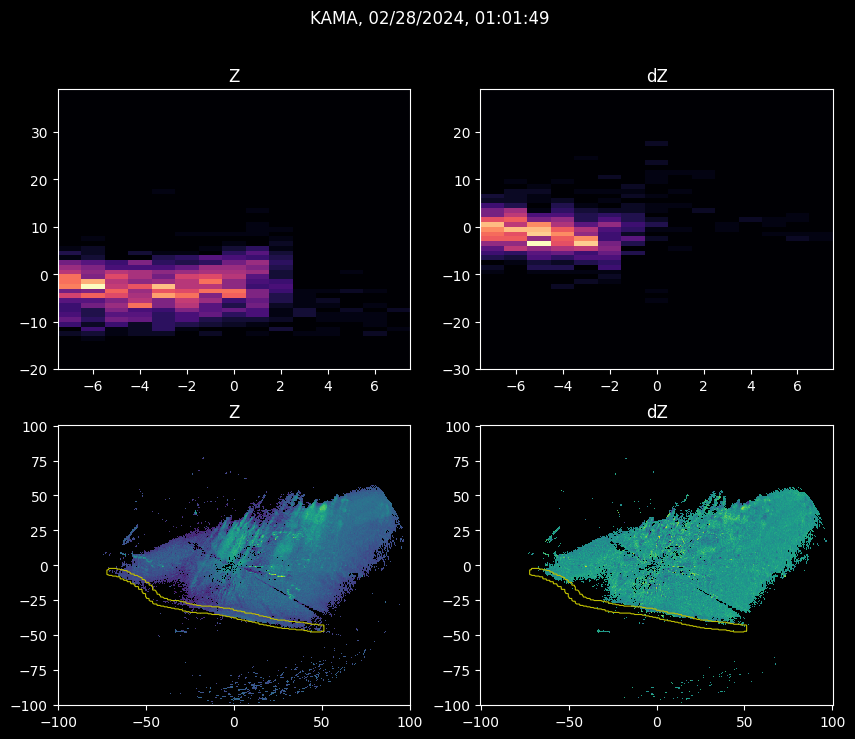

<Figure size 640x480 with 0 Axes>

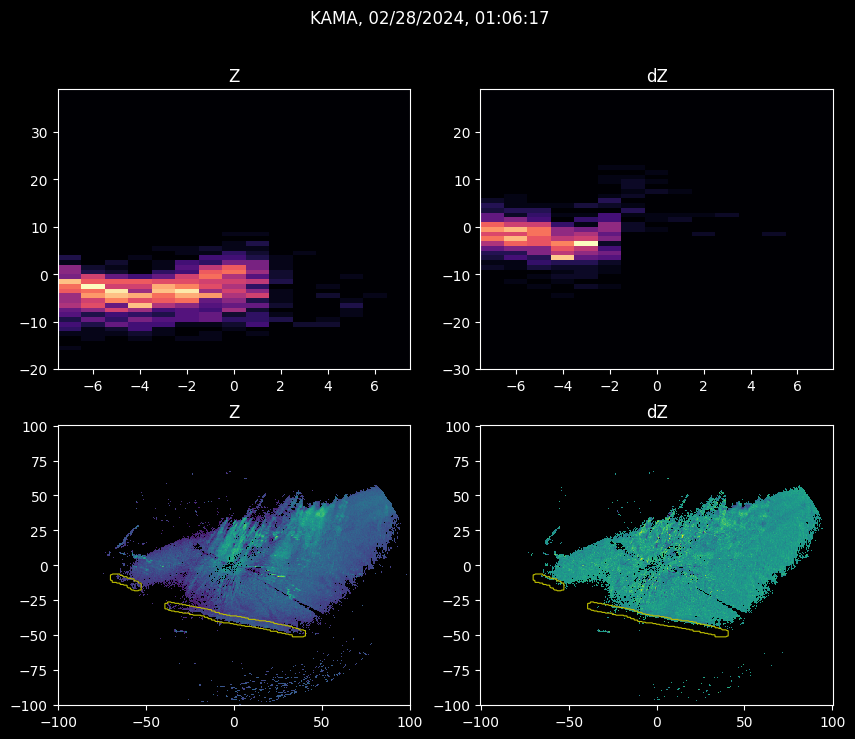

<Figure size 640x480 with 0 Axes>

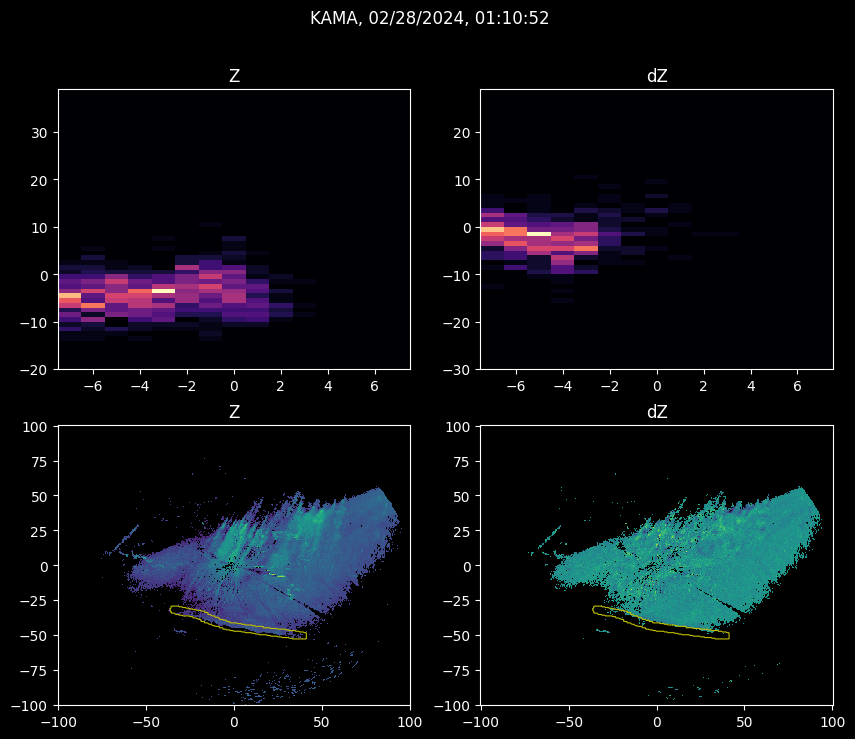

<Figure size 640x480 with 0 Axes>

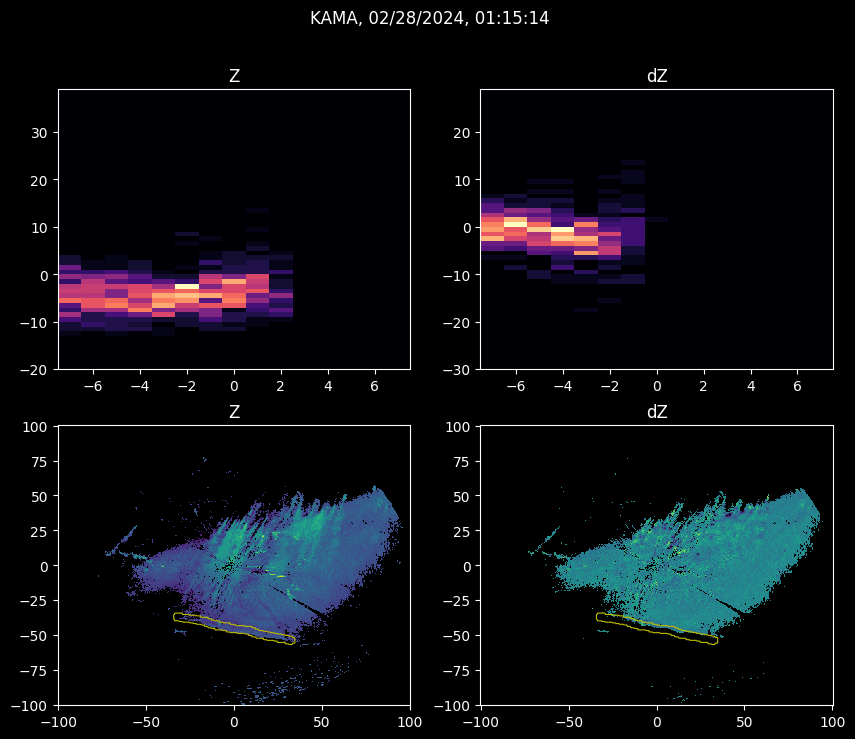

<Figure size 640x480 with 0 Axes>

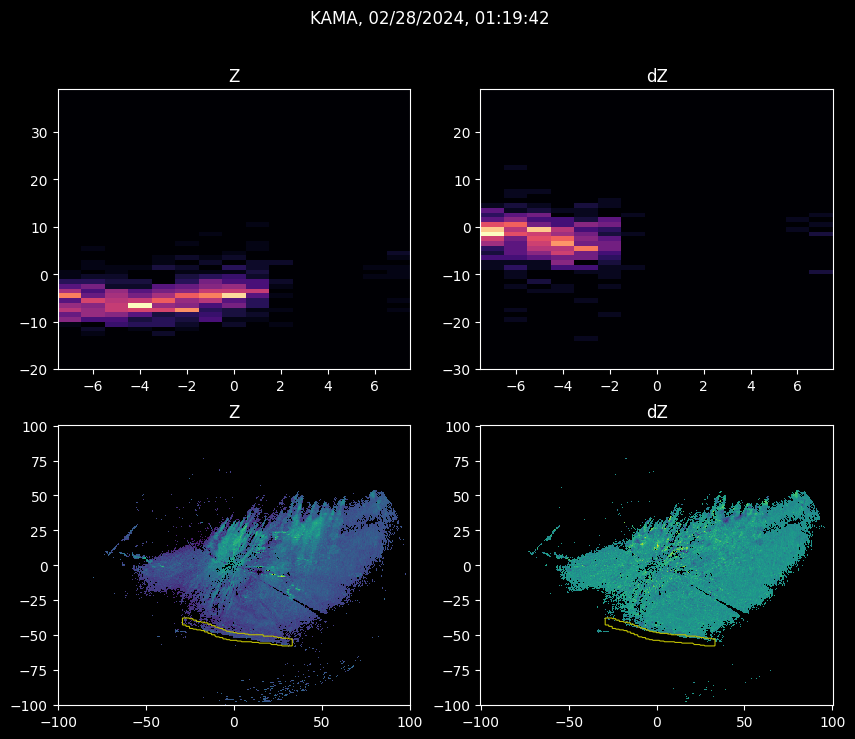

<Figure size 640x480 with 0 Axes>

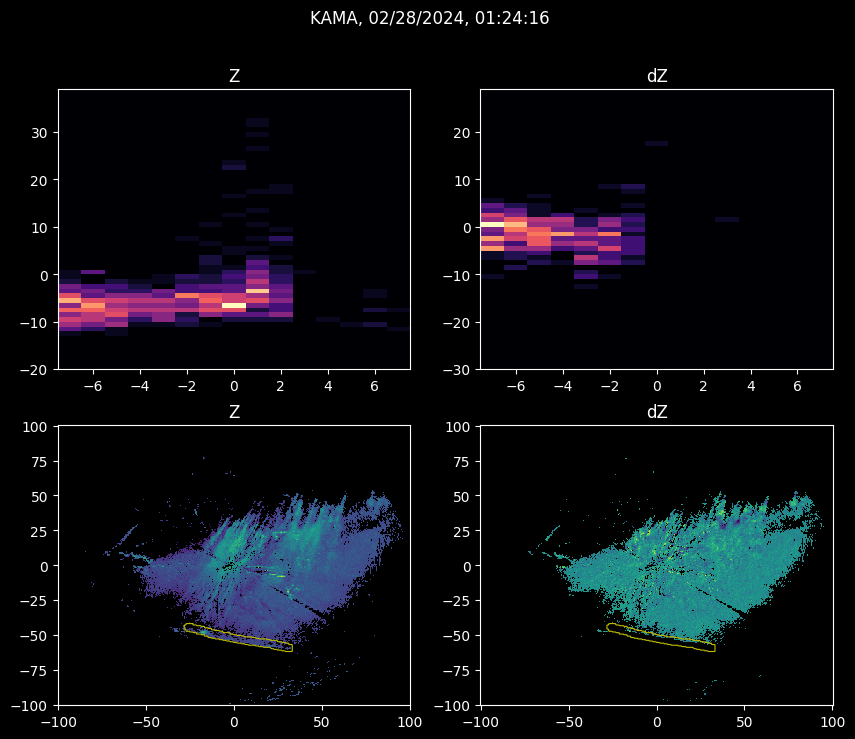

<Figure size 640x480 with 0 Axes>

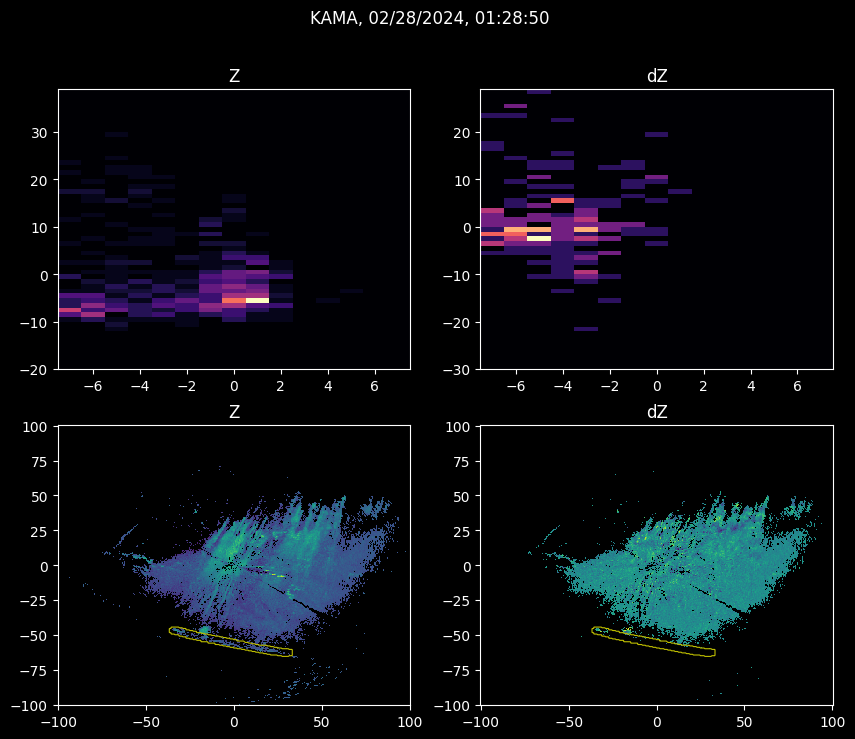

<Figure size 640x480 with 0 Axes>

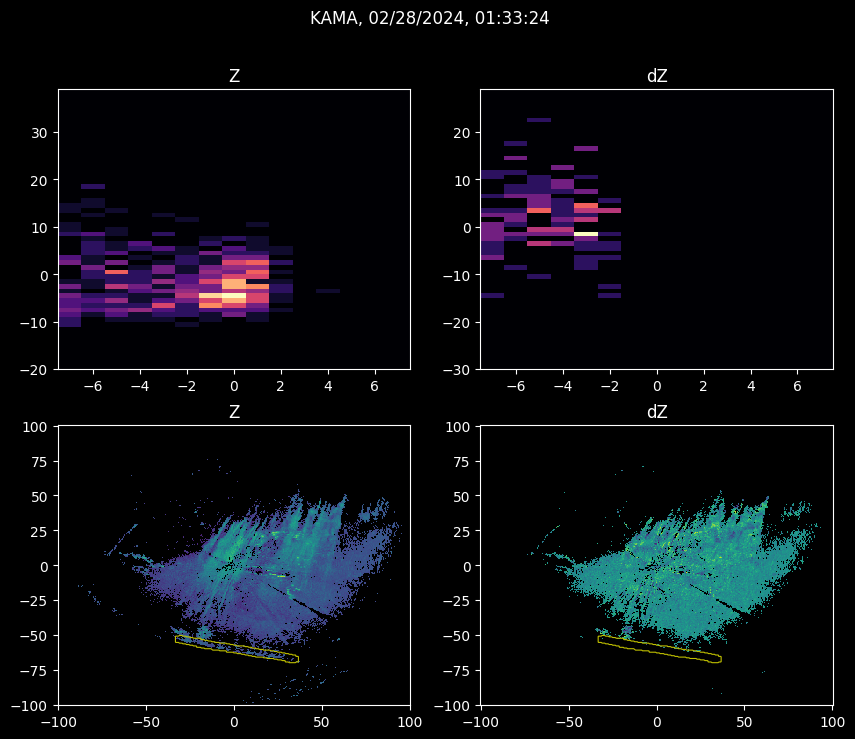

<Figure size 640x480 with 0 Axes>

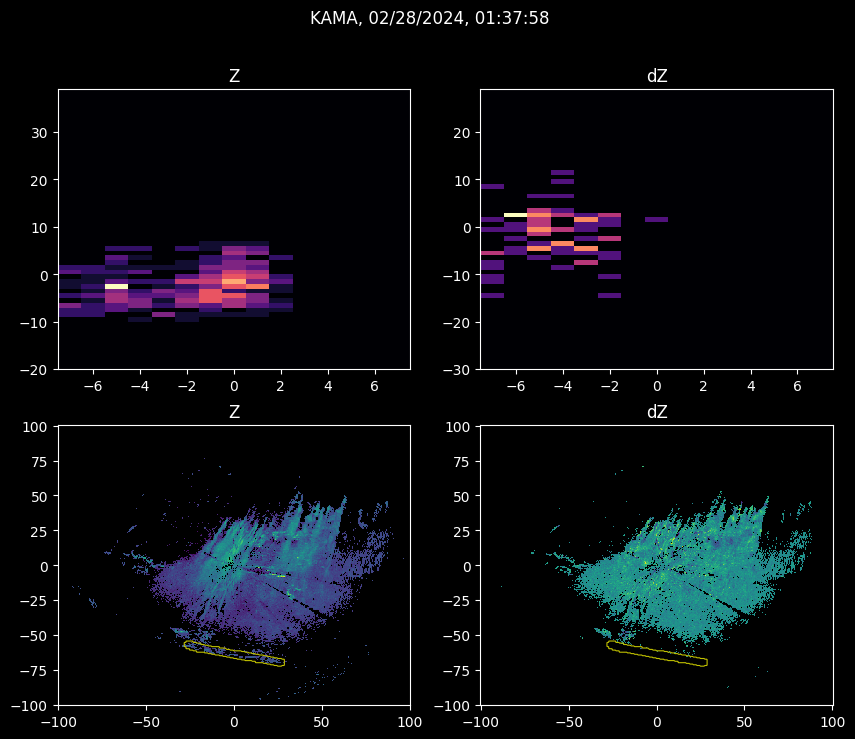

<Figure size 640x480 with 0 Axes>

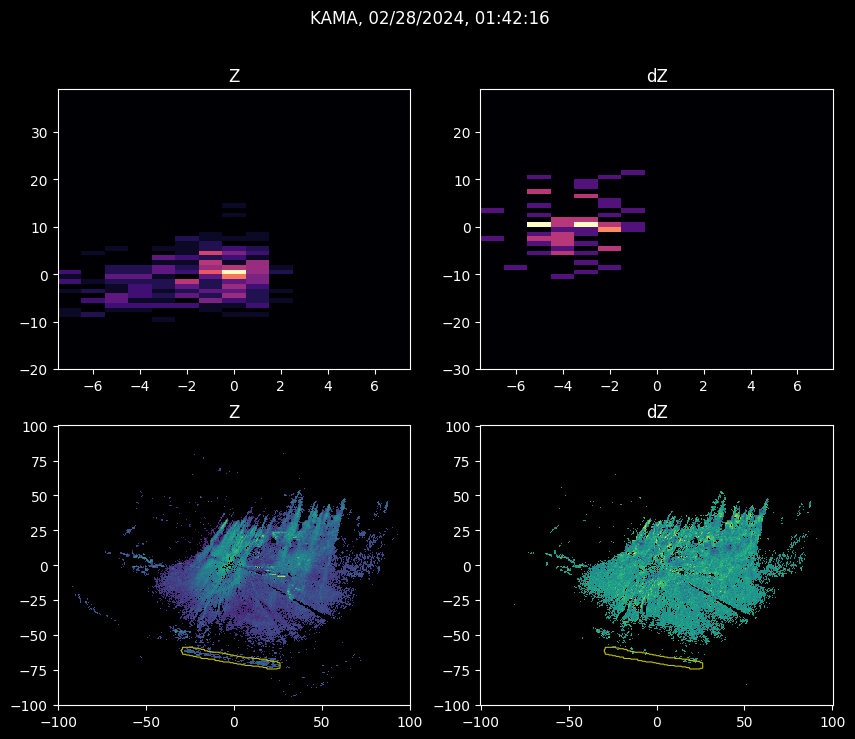

<Figure size 640x480 with 0 Axes>

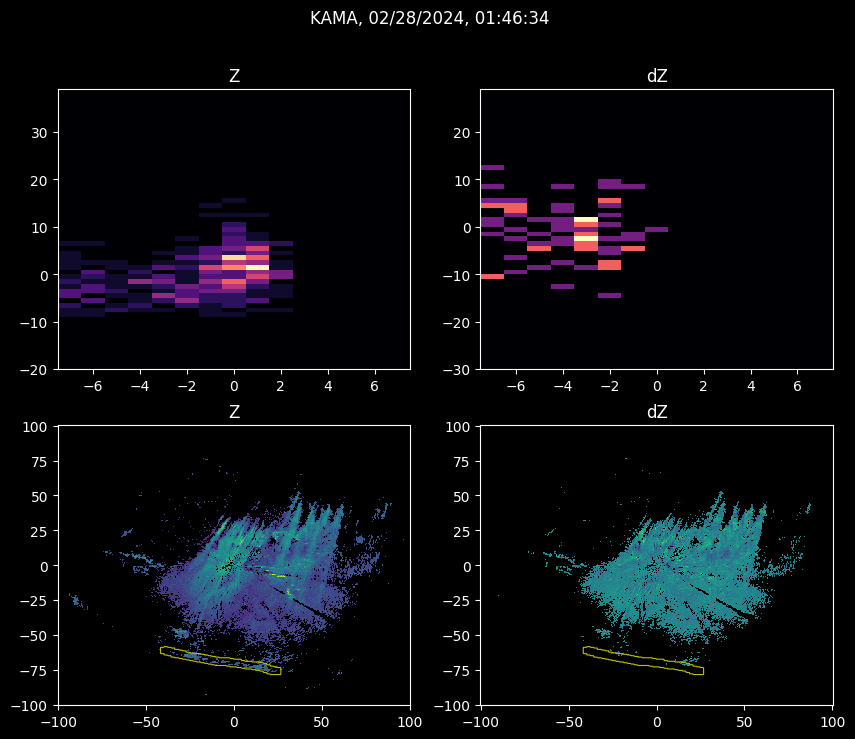

<Figure size 640x480 with 0 Axes>

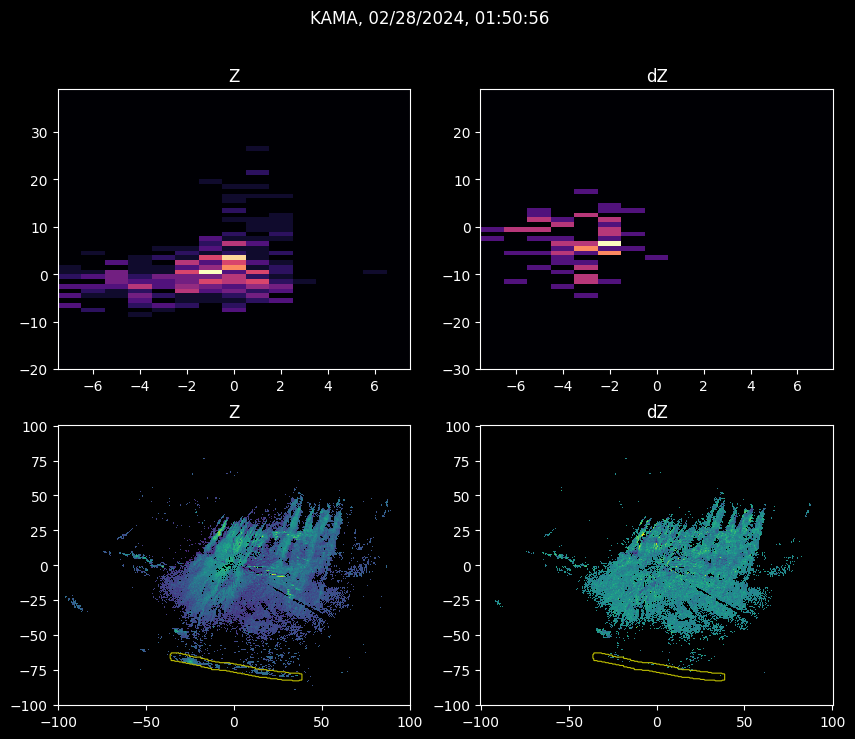

<Figure size 640x480 with 0 Axes>

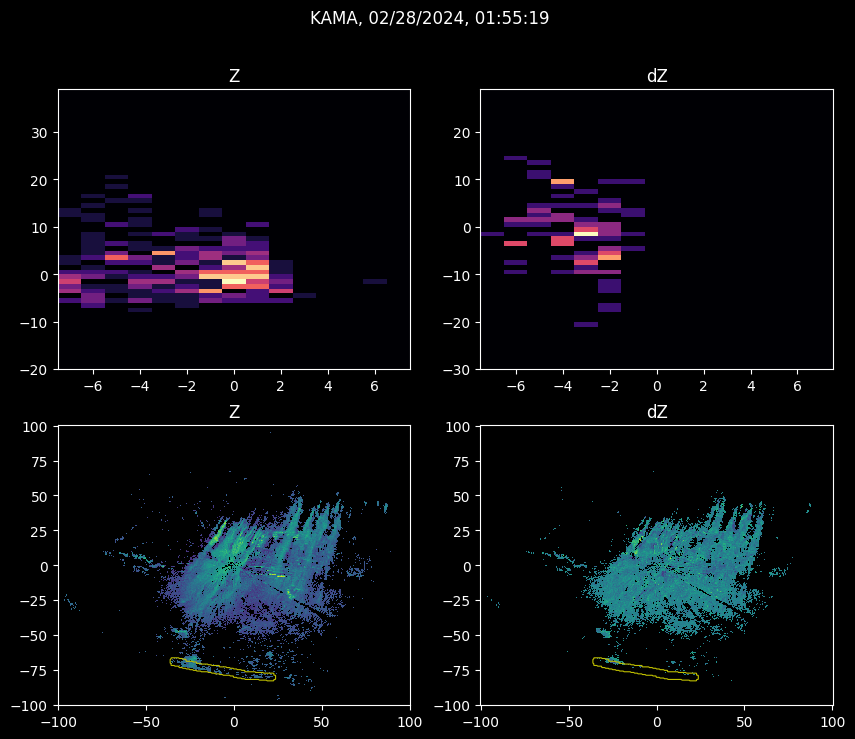

<Figure size 640x480 with 0 Axes>

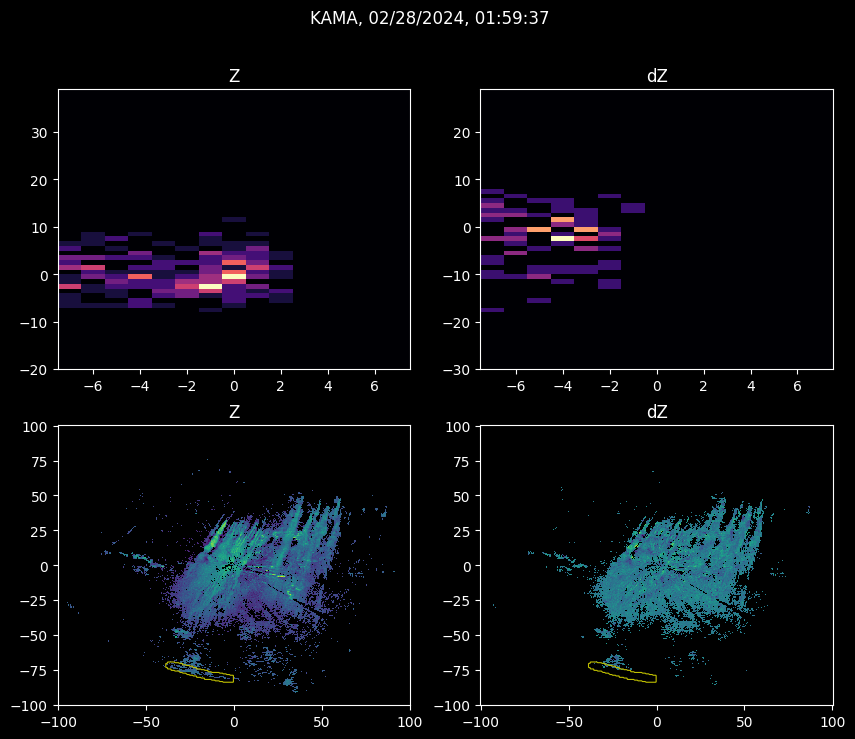

<Figure size 640x480 with 0 Axes>

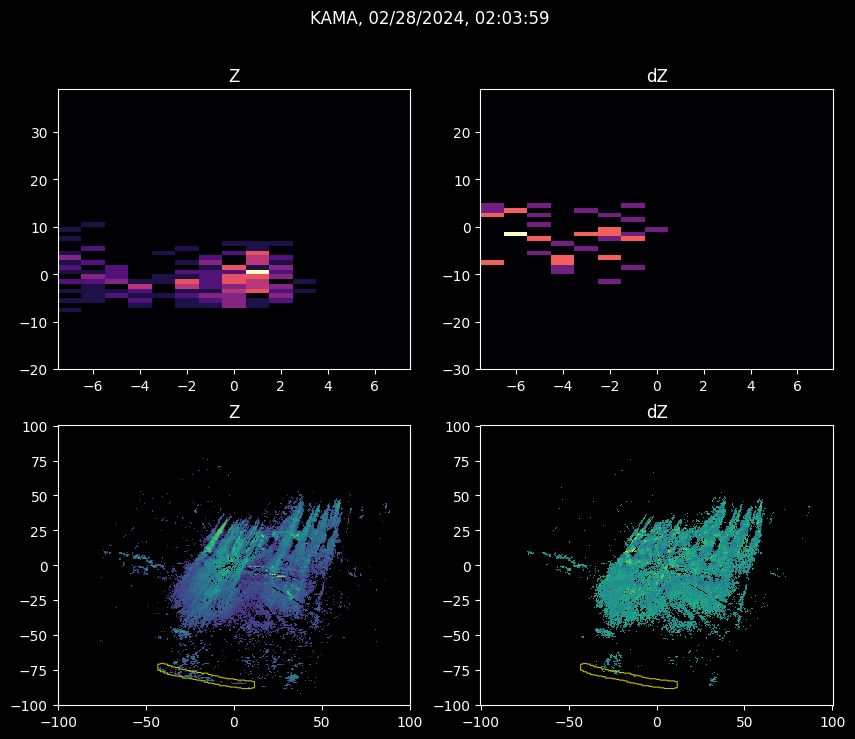

<Figure size 640x480 with 0 Axes>

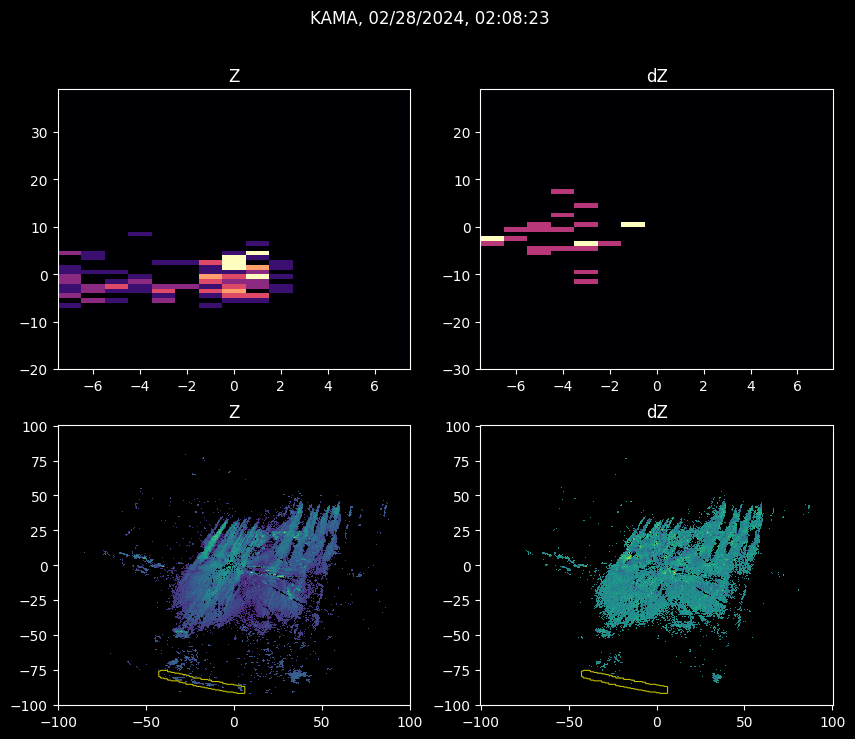

<Figure size 640x480 with 0 Axes>

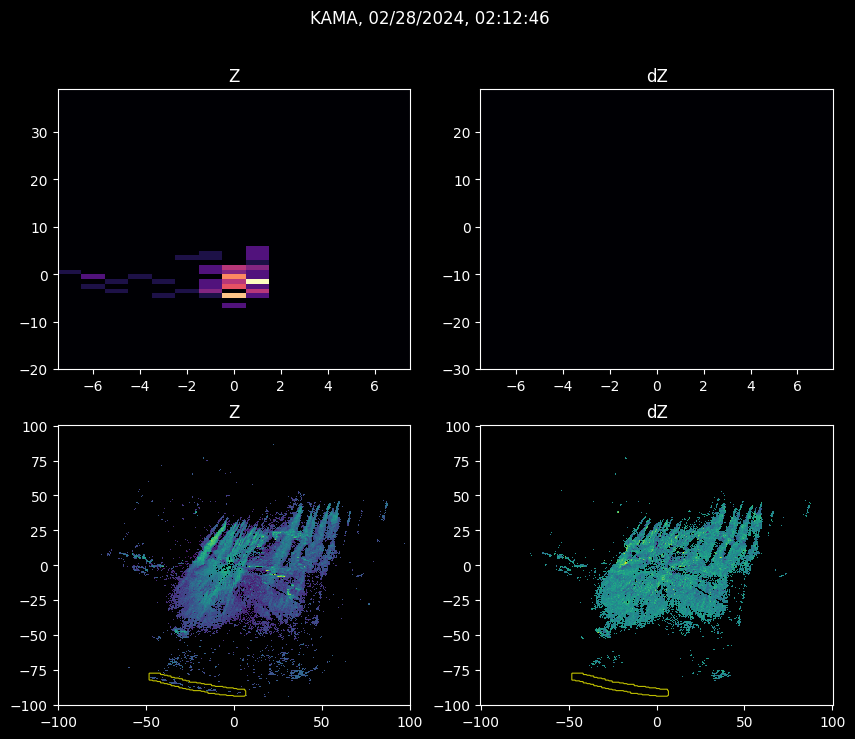

<Figure size 640x480 with 0 Axes>

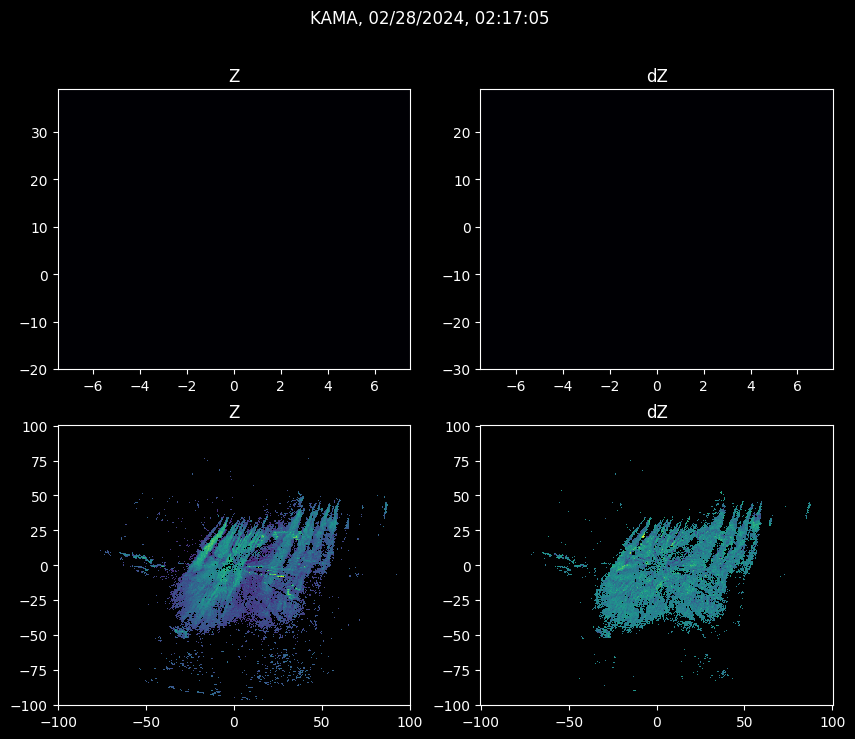

In [240]:
leng=15
ds = np.arange(-(leng//2),(leng+1)//2)
for ppi_file in npz_list:
    plt.figure()
    print(ppi_file)
    data = np.load(ppi_file)
    evalbox = data['evalbox']
    evalline = skeletonize(evalbox)
    theta, coherence, valid = orientation_from_binary(evalline, sigma=3)
    
    x,y =  cross_section(theta[evalline], data['xi2'][evalline], data['yi2'][evalline],data['xi2'],data['yi2'], length=leng)
    # plt.figure()
    # plt.plot(data['xi2'][evalline],data['yi2'][evalline],'k.')
    # plt.plot(data['xi2'][x,y],data['yi2'][x,y])
    # plt.title('')
    
    # plt.figure()
    # plt.plot(ds,data['diffz'][x,y])
    # plt.title('')

    ppi_id = os.path.basename(ppi_file)
    ppi_name = ppi_id[11:]  # MATLAB 12:end is Python 11: (0-based)
    date_part = ppi_name[4:12]   # 5:12 in MATLAB → 4:12 in Python
    time_part = ppi_name[13:19]

    radar_id = ppi_name[0:4]  # 1:4 in MATLAB → 0:4 in Python
    tstamp_date = datetime.strptime(date_part, "%Y%m%d")
    tstamp_time = datetime.strptime(time_part, "%H%M%S").time()
    tstamp = datetime.combine(tstamp_date.date(), tstamp_time)
    ppi_desc = f"{radar_id}, {tstamp.strftime('%m/%d/%Y, %H:%M:%S %Z')}"
    
    z = data['inputNF'][x,y,1].ravel()
    cx = np.tile(ds[:, None], (1, x.shape[1])).ravel()
    dZ = data['diffz'][x,y].ravel()

    fig, ax = plt.subplots(2, 2, figsize=(10, 8))  # 1 row, 2 cols
    fig.suptitle(ppi_desc)
    
    ax[0,0].hist2d(cx[np.isfinite(z)], z[np.isfinite(z)], bins=(np.arange(-leng//2, (leng+1)//2, 1)+0.5, np.arange(-20, 40, 1)), cmap='magma')
    ax[0,0].set_title('Z')

    ax[1,0].pcolormesh(data['xi2'],data['yi2'],data['inputNF'][:,:,1])
    ax[1,0].contour(data['xi2'],data['yi2'],evalbox,[0.5], colors='y',linewidths=0.8)
    ax[1,0].set_title('Z')

    ax[0,1].hist2d(cx[np.isfinite(dZ)], dZ[np.isfinite(dZ)], bins=(np.arange(-leng//2, (leng+1)//2, 1)+0.5, np.arange(-30, 30, 1)), cmap='magma')
    ax[0,1].set_title('dZ')

    ax[1,1].pcolormesh(data['xi2'],data['yi2'],data['diffz'])
    ax[1,1].contour(data['xi2'],data['yi2'],evalbox,[0.5], colors='y',linewidths=0.8)
    ax[1,1].set_title('dZ')
   

In [19]:
leng=15
ds = np.arange(-(leng//2),(leng+1)//2)
for ppi_file in npz_list[:10]:
    plt.figure()
    print(ppi_file)
    data = np.load(ppi_file)
    evalbox = data['evalbox']
    evalline = skeletonize(evalbox)
    theta, coherence, valid = orientation_from_binary(evalline, sigma=3)
    
    x,y =  cross_section(theta[evalline], data['xi2'][evalline], data['yi2'][evalline],data['xi2'],data['yi2'], length=leng)
    # plt.figure()
    # plt.plot(data['xi2'][evalline],data['yi2'][evalline],'k.')
    # plt.plot(data['xi2'][x,y],data['yi2'][x,y])
    # plt.title('')
    
    # plt.figure()
    # plt.plot(ds,data['diffz'][x,y])
    # plt.title('')

    ppi_id = os.path.basename(ppi_file)
    ppi_name = ppi_id[11:]  # MATLAB 12:end is Python 11: (0-based)
    date_part = ppi_name[4:12]   # 5:12 in MATLAB → 4:12 in Python
    time_part = ppi_name[13:19]

    radar_id = ppi_name[0:4]  # 1:4 in MATLAB → 0:4 in Python
    tstamp_date = datetime.strptime(date_part, "%Y%m%d")
    tstamp_time = datetime.strptime(time_part, "%H%M%S").time()
    tstamp = datetime.combine(tstamp_date.date(), tstamp_time)
    ppi_desc = f"{radar_id}, {tstamp.strftime('%m/%d/%Y, %H:%M:%S %Z')}"
    
    z = data['inputNF'][x,y,2].ravel()
    cx = np.tile(ds[:, None], (1, x.shape[1])).ravel()
    dZ = data['inputNF'][x,y,3].ravel()

    fig, ax = plt.subplots(2, 2, figsize=(10, 8))  # 1 row, 2 cols
    fig.suptitle(ppi_desc)
    
    ax[0,0].hist2d(cx[np.isfinite(z)], z[np.isfinite(z)]
                   , bins=(np.arange(-leng//2, (leng+1)//2, 1)+0.5, np.arange(0.2, 1.05, 0.05))
                   , cmap='magma')
    ax[0,0].set_title('R')

    ax[1,0].pcolormesh(data['xi2'],data['yi2'],data['inputNF'][:,:,2])
    ax[1,0].contour(data['xi2'],data['yi2'],evalbox,[0.5], colors='y',linewidths=0.8)
    ax[1,0].set_title('R')

    ax[0,1].hist2d(cx[np.isfinite(dZ)], dZ[np.isfinite(dZ)]
                   , bins=(np.arange(-leng//2, (leng+1)//2, 1)+0.5, np.arange(-8, 10, 0.4))
                   , cmap='magma')
    ax[0,1].set_title('D')

    ax[1,1].pcolormesh(data['xi2'],data['yi2'],data['inputNF'][:,:,3])
    ax[1,1].contour(data['xi2'],data['yi2'],evalbox,[0.5], colors='y',linewidths=0.8)
    ax[1,1].set_title('D')

NameError: name 'npz_list' is not defined

./tracking_points/nf_preds/KAMA20240227_21/nf_pred_10_KAMA20240227_225645_V06.npz


<Figure size 640x480 with 0 Axes>

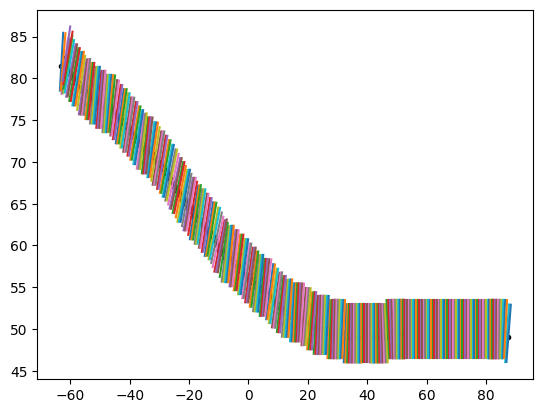

In [98]:
# plt.pcolormesh(theta,cmap='jet')
ppi_file=npz_list[12]
for ppi_file in npz_list[8:9]:
    plt.figure()
    print(ppi_file)
    data = np.load(ppi_file)
    evalbox = data['evalbox']
    evalline = skeletonize(evalbox)
    theta, coherence, valid = orientation_from_binary(evalline, sigma=3)
    plt.figure()
    plt.plot(data['xi2'][evalline],data['yi2'][evalline],'k.')
    x,y =  cross_section(theta[evalline], data['xi2'][evalline], data['yi2'][evalline], length=8)
    plt.plot(x,y)
    plt.title('')

In [175]:
d=15
x=np.arange(-(d//2),(d+1)//2)
x,x.shape

(array([-7, -6, -5, -4, -3, -2, -1,  0,  1,  2,  3,  4,  5,  6,  7]), (15,))

In [176]:
from datetime import datetime, timedelta
def cross_section(theta, x0, y0, xgrid, ygrid, length=20):
    """
    Extract cross-section perpendicular to elongate direction at (x0, y0).
    
    Parameters
    ----------
    theta : float
        Elongation direction angle at this point (radians).
    x0, y0 : float
        Physical coordinates of center point.
    xgrid, ygrid : 2D arrays
        Coordinate grids (same shape as mask).
    length : float
        Length of cross-section in same units as x0,y0.
    """
    # perpendicular direction
    angle = theta + np.pi/2
    dx, dy = np.cos(angle), np.sin(angle)
    s = np.arange(-(length//2),(length+1)//2)
    # start and end coordinates in physical space
    x, y = x0 - dx[np.newaxis,:]*s[:,np.newaxis], y0 - dy[np.newaxis,:]*s[:,np.newaxis]
    # x2, y2 = x0 + dx*length/2, y0 + dy*length/2
    dx_grid = xgrid[0,1] - xgrid[0,0]
    dy_grid = ygrid[1,0] - ygrid[0,0]
    i1 = np.clip(np.round((y - ygrid[0,0]) / dy_grid), 0, xgrid.shape[0]-1).astype(int)
    j1 = np.clip(np.round((x - xgrid[0,0]) / dx_grid), 0, xgrid.shape[1]-1).astype(int)
    # return x, y
    return i1, j1

Text(0, 0.5, 'Z')

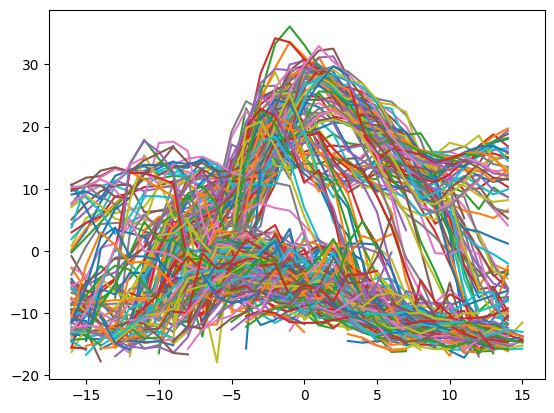

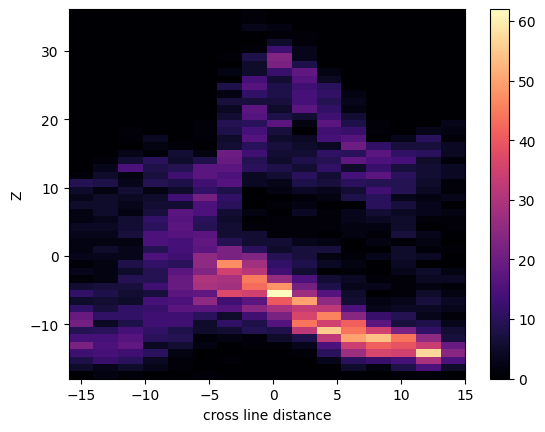

In [70]:


# def cross_section(mask, theta, x0, y0, xgrid, ygrid, length=20):
#     """
#     Extract cross-section perpendicular to elongate direction at (x0, y0).
    
#     Parameters
#     ----------
#     mask : 2D array
#         Field to sample from (same shape as xgrid, ygrid).
#     theta : float
#         Elongation direction angle at this point (radians).
#     x0, y0 : float
#         Physical coordinates of center point.
#     xgrid, ygrid : 2D arrays
#         Coordinate grids (same shape as mask).
#     length : float
#         Length of cross-section in same units as x0,y0.
#     """
#     # perpendicular direction
#     angle = theta + np.pi/2
#     dx, dy = np.cos(angle), np.sin(angle)

#     # start and end coordinates in physical space
#     x1, y1 = x0 - dx*length/2, y0 - dy*length/2
#     x2, y2 = x0 + dx*length/2, y0 + dy*length/2

#     # convert physical coords -> pixel indices
#     # assumes uniform grid!
#     dx_grid = xgrid[0,1] - xgrid[0,0]
#     dy_grid = ygrid[1,0] - ygrid[0,0]

#     # i0 = (y0 - ygrid[0,0]) / dy_grid
#     # j0 = (x0 - xgrid[0,0]) / dx_grid
#     i1 = (y1 - ygrid[0,0]) / dy_grid
#     j1 = (x1 - xgrid[0,0]) / dx_grid
#     i2 = (y2 - ygrid[0,0]) / dy_grid
#     j2 = (x2 - xgrid[0,0]) / dx_grid

#     # extract profile using pixel indices
#     prof = profile_line(mask.astype(float), (i1, j1), (i2, j2),
#                         mode="constant", order=1)
#     return prof


Text(0, 0.5, 'Z')

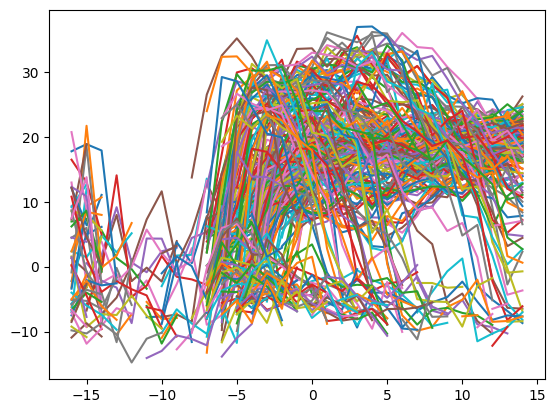

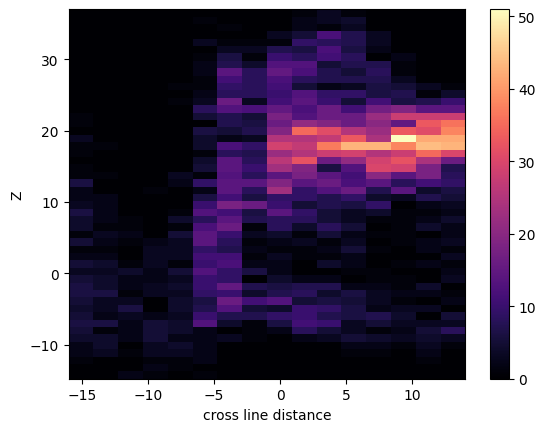

In [72]:
profiles = []
x = []
for ite, ix, iy in zip(theta[evalline],data['xi2'][evalline],data['yi2'][evalline]):
    prof = cross_section(data['inputNF'][:,:,1], ite, ix, iy,data['xi2'],data['yi2'], length=15)
    profiles.append(prof)
    px = np.arange(-prof.size//2, prof.size//2)
    x.append(px)
    # np.tile(, n_profiles)
    plt.plot(px,prof)

y = np.concatenate(profiles)   # shape = (n_profiles, n_samples)
x = np.concatenate(x)
# n_profiles, n_samples = profiles.shape
# x = np.tile(np.arange(-n_samples//2, n_samples//2), n_profiles)
# y = profiles.ravel()
plt.figure()
plt.hist2d(x[np.isfinite(y)], y[np.isfinite(y)], bins=(n_samples, 50), cmap='magma')
plt.xlabel('cross line distance')
plt.colorbar()
plt.ylabel('Z')

./tracking_points/nf_preds/KAMA20240227_21/nf_pred_14_KAMA20240227_232512_V06.npz


(-100.25, 100.25, -100.25, 100.25)

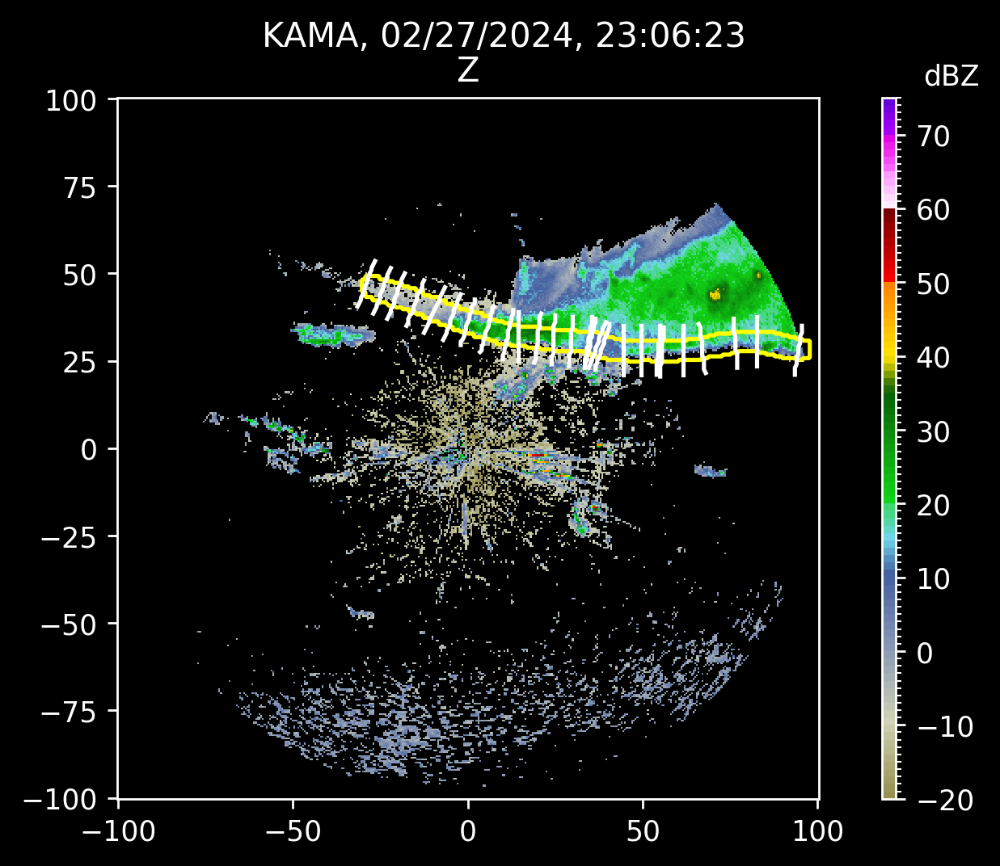

In [239]:
import tminlib.colorlevel as cl
from tminlib import plot_helper as phelp
plt.style.use('dark_background')
ppi_file=npz_list[12]
print(ppi_file)
data = np.load(ppi_file)
evalbox = data['evalbox']
evalline = skeletonize(evalbox)
Cx = data['xi2']
Cy = data['yi2']
r = np.sqrt(Cx**2+Cy**2)
rmask = r>=100
fig, axs = plt.subplots(1, 1, figsize=(4/0.7, 3/0.7),dpi=250, gridspec_kw=dict(left=0.08, right=1-0.085, top=1-0.11, bottom=0.08, wspace=0.25, hspace=0.16))
REF = data['inputNF'][:,:,1]
pdata = np.ma.masked_where(rmask,REF)
axs.pcolormesh(Cx,Cy,pdata,cmap=cl.zmap,norm=cl.znorm)

axs.contour(Cx,Cy,evalbox,[0.5],colors='#ffff00',linewidths=1.5)
theta, coherence, valid = orientation_from_binary(evalline, sigma=3)

x,y =  cross_section(theta[evalline], data['xi2'][evalline], data['yi2'][evalline],data['xi2'],data['yi2'], length=leng)

# plt.plot(data['xi2'][evalline],data['yi2'][evalline],'b.')
plt.plot(data['xi2'][x[:,::10],y[:,::10]],data['yi2'][x[:,::10],y[:,::10]],'w-')
axs.set_title(r'Z')
fig.suptitle(ppi_desc)
phelp.add_cbar(axs.collections[0],fig,axs,pad="9%",unit_text = 'dBZ')
axs.axis('equal')


In [233]:
x.sha

(15, 324)

./tracking_points/nf_preds/KAMA20240227_21/nf_pred_14_KAMA20240227_232512_V06.npz


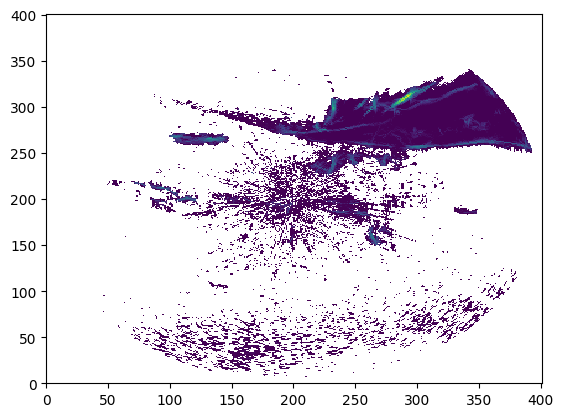

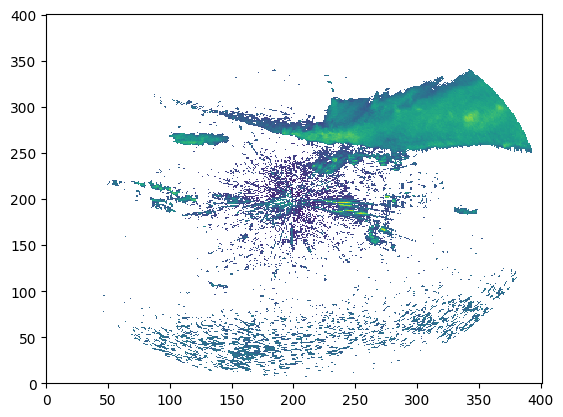

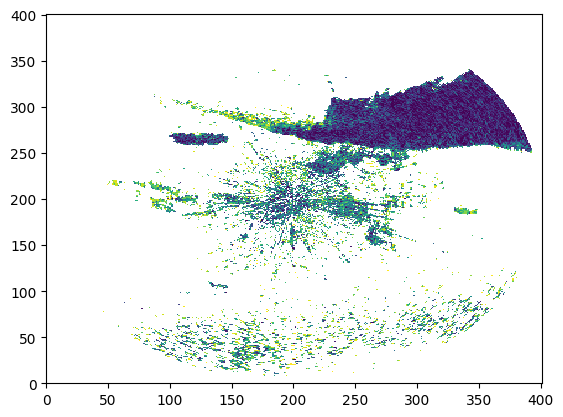

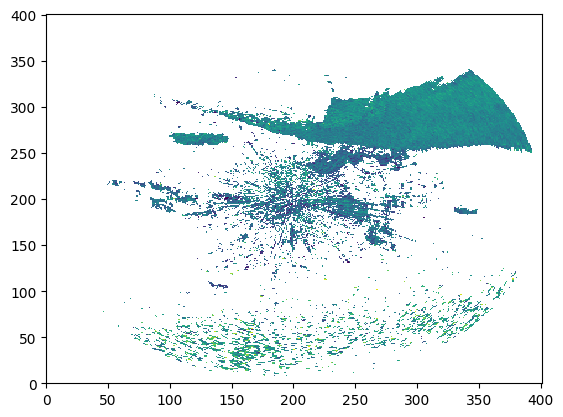

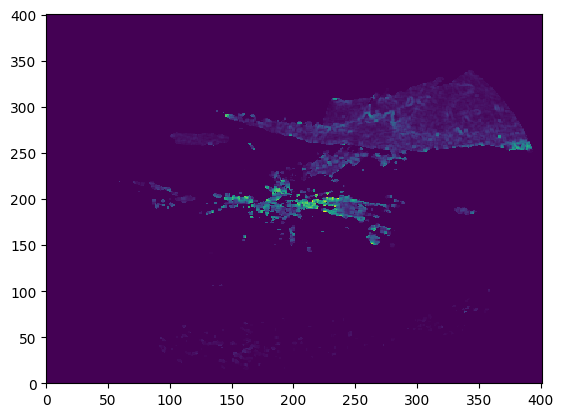

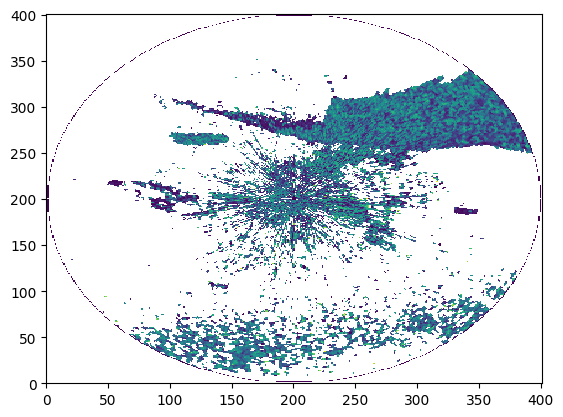

In [71]:
ppi_file=npz_list[12]
print(ppi_file)
data = np.load(ppi_file)
evalbox = data['evalbox']
evalline = skeletonize(evalbox)
for iv in range(data['inputNF'].shape[-1]):
    plt.figure()
    plt.pcolormesh(data['inputNF'][:,:,iv])

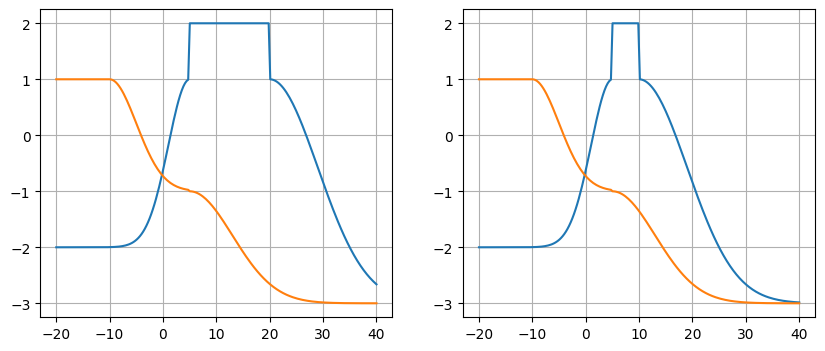

In [50]:

fig, ax = plt.subplots(1, 2, figsize=(10, 4))  # 1 row, 2 cols
def plot_ftc(pax,cp,sp):
# plt.subplots(1,1,figsize=(4.5, 4.5),dpi=400,gridspec_kw=dict(left=0.15, right=1-0.085, top=1-0.08, bottom=0.1, wspace=0.25, hspace=0.16))
    cnum1, cnum2, csig1, cfactor1, cintersec1, csig2, cfactor2, cintersec2, cyfill = cp
    cbox=np.linspace(-20,40,200)
    llscore = np.zeros(cbox.shape)
    llscore[cbox<=cnum1] = gaussmf(cbox[cbox<=cnum1], csig1, cnum1)*cfactor1+cintersec1
    llscore[np.logical_and(cbox>cnum1, cbox<=cnum2)] = cyfill
    llscore[cbox>cnum2] = gaussmf(cbox[cbox>cnum2], csig2, cnum2)*cfactor2+cintersec2
    clscore = np.nansum(llscore,0)
    
    snum1, snum2, ssig1, sfactor1, sintersec1, ssig2, sfactor2, sintersec2, syfill = sp
    sbox = np.linspace(-20,40,200)
    con1 = np.logical_and(sbox>=snum1, sbox<=snum2)
    con2 = sbox>snum2
    ssscore = np.zeros(sbox.shape)
    ssscore[sbox<snum1] = syfill;
    ssscore[con1] = gaussmf(sbox[con1], ssig1, snum1)*sfactor1 + sintersec1
    ssscore[con2] = gaussmf(sbox[con2], ssig2, snum2)*sfactor2 + sintersec2
    sdscore = np.nansum(ssscore,0)
    pax.plot(cbox,llscore)
    pax.plot(sbox,ssscore)
    pax.grid()
plot_ftc(ax[0],[5,20,4,3,-2,9,4,-3,2],[-10,5,5,2,-1,8,2,-3,1])
plot_ftc(ax[1],[5,10,4,3,-2,9,4,-3,2],[-10,5,5,2,-1,8,2,-3,1])


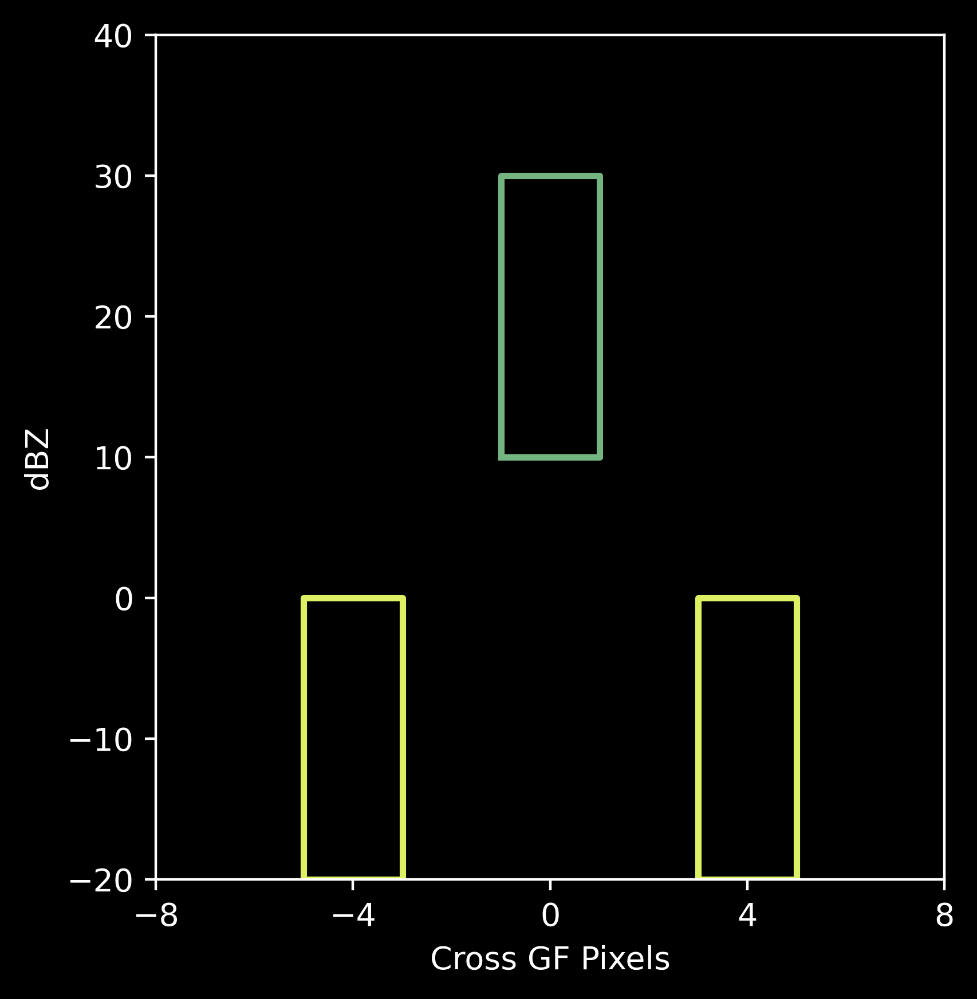

In [270]:
plt.subplots(1,1,figsize=(4.5, 4.5),dpi=400,gridspec_kw=dict(left=0.15, right=1-0.085, top=1-0.08, bottom=0.1, wspace=0.25, hspace=0.16))
plt.plot([-1,1,1,-1,-1],[10,10,30,30,10],color=(116/255,180/255,128/255),linewidth=2)
plt.xlim(-15//2, (15+1)//2)
plt.ylim(-20, 40)
plt.xlabel('Cross GF Pixels')
plt.ylabel('dBZ')
plt.xticks(np.arange(-8,12,4))
# plt.legend(['Function 1','Function 2'])
plt.savefig('AMS/FTC_ridge.png')
plt.plot([-5,-3,-3,-5,-5],[-20,-20,0,0,-20],color=(221/255,240/255,99/255),linewidth=2)
plt.plot([5,3,3,5,5],[-20,-20,0,0,-20],color=(221/255,240/255,99/255),linewidth=2)
plt.savefig('AMS/FTC_zone.png')
# plt.plot([-2,2,2,-2,-2],[10,10,30,30,10],color=(221/255,240/255,99/255),linewidth=2)

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.measure import profile_line

def cross_section(mask, theta, y0, x0, length=20):
    """
    Extract cross-section perpendicular to elongate direction at (y0, x0).
    """
    angle = theta[y0, x0] + np.pi/2
    dx, dy = np.cos(angle), np.sin(angle)

    # Start and end coordinates
    x1, y1 = x0 - dx*length/2, y0 - dy*length/2
    x2, y2 = x0 + dx*length/2, y0 + dy*length/2

    # Extract profile (bilinear interpolation)
    prof = profile_line(mask.astype(float), (y1, x1), (y2, x2), mode="constant", order=1)
    return prof

# Example usage
y0, x0 = 50, 100   # pick a pixel coordinate in your mask
prof = cross_section(mask, theta, y0, x0, length=40)

plt.plot(prof)
plt.title(f"Cross-section at ({y0}, {x0})")
plt.xlabel("Distance along perpendicular (pixels)")
plt.ylabel("Mask value")
plt.show()

NameError: name 'mask' is not defined